<a href="https://colab.research.google.com/github/Siyu-Zhou-M/EEG2Rep/blob/main/wavelet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
!pip install mne
!pip install pywavelets
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.4/7.4 MB 59.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.5/4.5 MB 39.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 891.4/891.4 kB 21.6 MB/s eta 0:00:00


In [3]:
import mne
import json
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
import pandas as pd
import seaborn as sns
from sklearn.linear_model import LogisticRegression
from torchmetrics import AUROC, Precision, Recall, F1Score
import torch
import scipy as sp
from sklearn.manifold import TSNE
import logging
import os
from sklearn.model_selection import train_test_split
import pywt

In [4]:
crowdsource_data = np.load('/content/drive/MyDrive/research/Crowdsource.npy', allow_pickle=True)
parsed_crowdsource = crowdsource_data.item()

In [5]:
for key, value in parsed_crowdsource.items():
    if isinstance(value, np.ndarray):
        print(f"{key}: shape={value.shape}, size={value.size}")

All_train_data: shape=(10403, 14, 256), size=37284352
All_train_label: shape=(10403,), size=10403
train_data: shape=(9456, 14, 256), size=33890304
train_label: shape=(9456,), size=9456
val_data: shape=(947, 14, 256), size=3394048
val_label: shape=(947,), size=947
test_data: shape=(1893, 14, 256), size=6784512
test_label: shape=(1893,), size=1893


In [6]:
eeg_data = parsed_crowdsource['All_train_data']
sfreq = 256

In [7]:
n_samples, n_channels, n_times = eeg_data.shape
ch_names = [f'ch{i}' for i in range(n_channels)]

In [8]:
info = mne.create_info(ch_names=ch_names, sfreq=sfreq, ch_types='eeg')

In [9]:
combined_data = np.concatenate([eeg_data[i] for i in range(10000)], axis=1)

In [10]:
raw = mne.io.RawArray(combined_data, info)
print("Time points:", raw.times)
print(f"Max time index: {len(raw.times) - 1}")

Creating RawArray with float64 data, n_channels=14, n_times=2560000
    Range : 0 ... 2559999 =      0.000 ...  9999.996 secs
Ready.
Time points: [0.00000000e+00 3.90625000e-03 7.81250000e-03 ... 9.99998828e+03
 9.99999219e+03 9.99999609e+03]
Max time index: 2559999


In [11]:
raw_crop = raw.crop(tmin=raw.times[111506], tmax=None)

In [12]:
new_sfreq = 256
raw_resampled = raw_crop.resample(sfreq=new_sfreq)

Sampling frequency of the instance is already 256.0, returning unmodified.


In [13]:
Sync_EEG = raw_resampled.crop(tmax=raw_resampled.times[682715])

In [14]:
EEG_Data = Sync_EEG.get_data()

Using matplotlib as 2D backend.


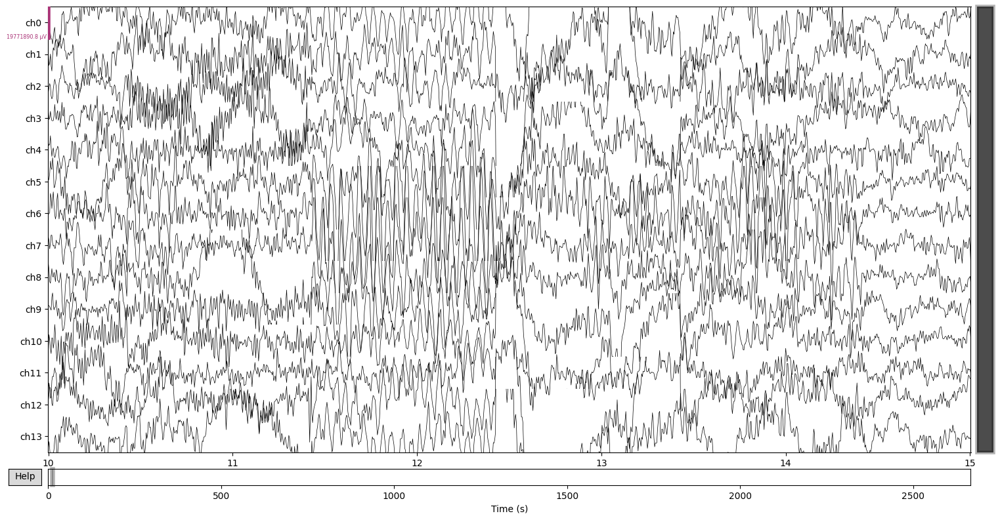

In [15]:
fig = Sync_EEG.plot(start=10, duration=5, scalings='auto', show=False)

fig.set_size_inches(16, 8)

In [16]:
freq_low = 0.5  # Lower frequency limit in Hz
freq_high = 50.0  # Upper frequency limit in Hz

In [17]:
# Apply band-pass filter to EEG data
Filter_eeg = Sync_EEG.filter(freq_low, freq_high, fir_design='firwin')

Filtering raw data in 1 contiguous segment
Setting up band-pass filter from 0.5 - 50 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.50
- Lower transition bandwidth: 0.50 Hz (-6 dB cutoff frequency: 0.25 Hz)
- Upper passband edge: 50.00 Hz
- Upper transition bandwidth: 12.50 Hz (-6 dB cutoff frequency: 56.25 Hz)
- Filter length: 1691 samples (6.605 s)



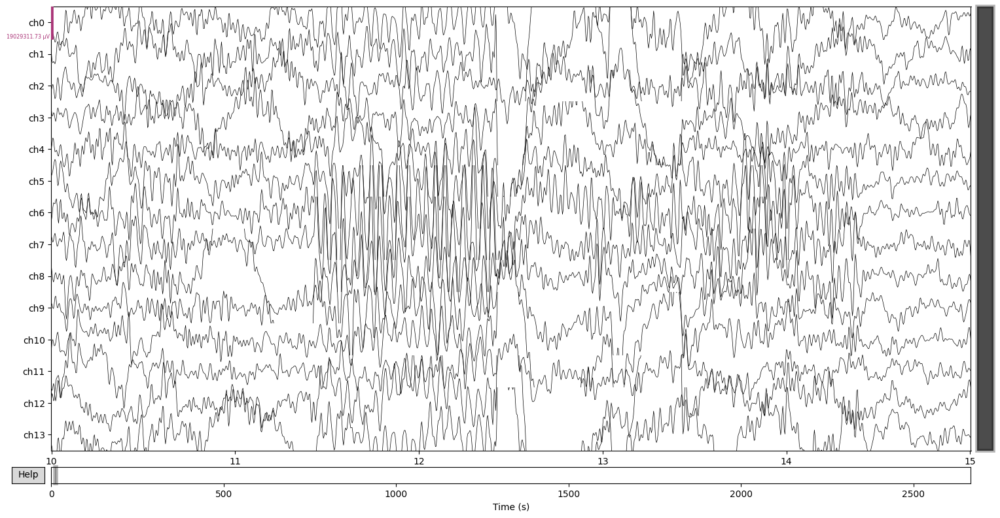

In [18]:
fig_2 = Filter_eeg.plot(start=10, duration=5, scalings='auto', show=False)
fig_2.set_size_inches(16, 8)

In [19]:
!pip install spkit

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.3/4.3 MB 13.9 MB/s eta 0:00:00


In [20]:
# use another methods
import numpy as np
import matplotlib.pyplot as plt

In [21]:
import spkit
print('spkit-version ', spkit.__version__)
import spkit as sp

spkit-version  0.0.9.7


<frozen importlib._bootstrap>:914: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDriveImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _GenerativeAIImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _OpenCVImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: APICoreClientInfoImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _BokehImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _AltairImportHook.find_spec() not found; falling back to find_module()
<frozen importlib._bootstrap>:914: ImportWarning: _PyDrive2ImportHook.find_spec() not found; falling back to find_module()
<frozen impo

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.
<ipython-input-22-d0750ca084af>:1: DeprecationWarning: function eegSample_1ch will be deprecated in future version, due to naming convension, please use 'eeg_sample_1ch' for updated/improved functionality [spkit-0.0.9.7].


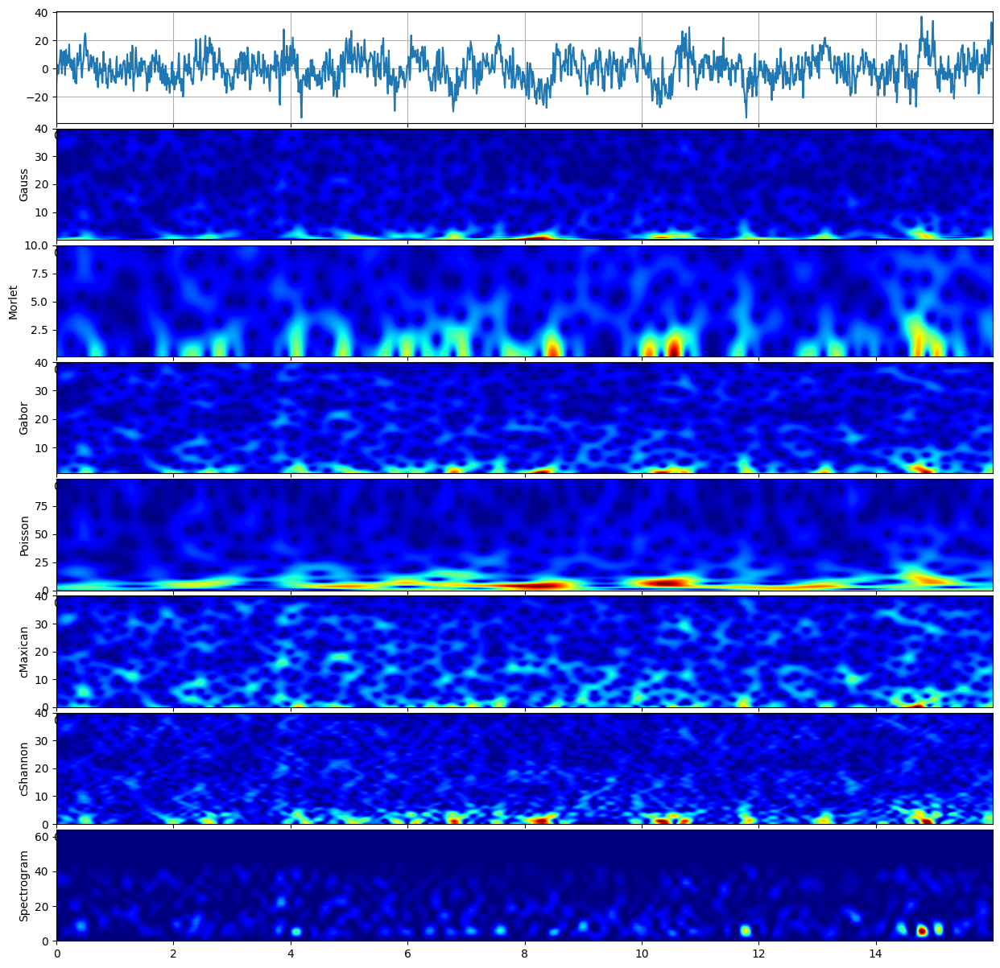

In [22]:
x, fs = sp.load_data.eegSample_1ch()
t = np.arange(len(x)) / fs
sp.cwt.compare_cwt_example(x, t, fs=fs)

In [23]:
EEG_Data = Filter_eeg.get_data()

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [24]:
print(EEG_Data.shape)

(14, 682716)


In [25]:
channel_index = 0
signal = EEG_Data[channel_index, :]

In [26]:
fs = new_sfreq

window_start = 0
window_end = 25600
signal_segment = signal[window_start:window_end]

In [27]:
t = np.arange(len(signal_segment)) / fs

/usr/local/lib/python3.10/dist-packages/spkit/cwt/cwt_fn.py:675: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.10/dist-packages/spkit/cwt/cwt_fn.py:675: RuntimeWarning: overflow encountered in multiply
/usr/local/lib/python3.10/dist-packages/spkit/cwt/cwt_fn.py:675: RuntimeWarning: invalid value encountered in multiply


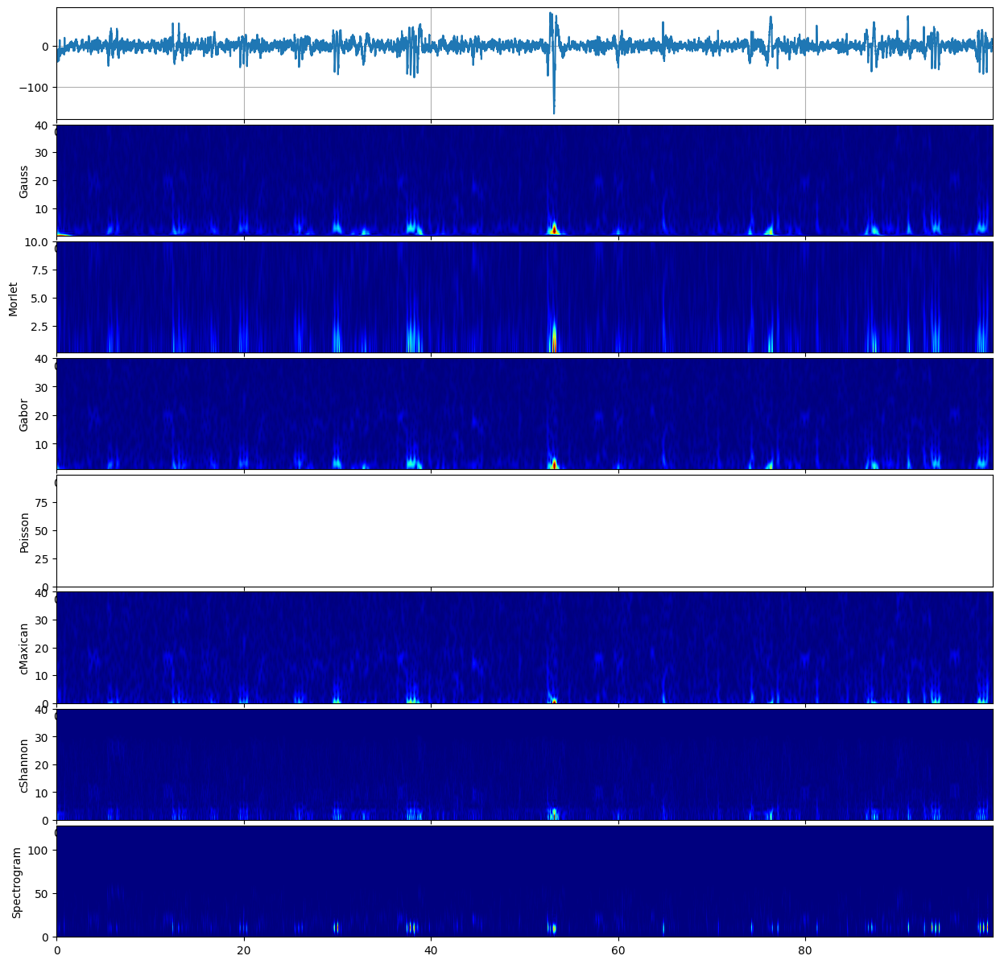

In [28]:
sp.cwt.compare_cwt_example(signal_segment, t, fs=fs)

In [29]:
fmin = 0.5
fmax = 50
nf = 40

In [30]:
print(dir(sp))

['A_law', 'Create_Dictionary', 'HistPlot', 'ICA', 'Mu_law', 'OutLiers', 'PCA', 'PeriodStrength', 'Periodogram', 'Quantize', 'RFB', 'RFB_example_1', 'RFB_example_2', 'RFB_prange', 'SVD', 'TD_Embed', 'TWM_algo', 'TWM_f0', 'WPA_coeff', 'WPA_plot', 'WPA_temporal', 'Wavelet_decompositions', '__all__', '__author__', '__builtins__', '__cached__', '__doc__', '__file__', '__loader__', '__name__', '__package__', '__path__', '__spec__', '__version__', 'absolute_import', 'add_noise', 'agg_angles', 'amplitude_equalizer', 'bin_width', 'blackman_lobe', 'cdf_mapping', 'clean_phase', 'conv1d_fb', 'conv1d_fft', 'conv1d_nan', 'conv2d_nan', 'core', 'create_dictionary', 'create_multidim_space_signal', 'create_signal_1d', 'create_signal_2d', 'cwt', 'data', 'denorm_kernel', 'dft_analysis', 'dft_synthesis', 'direction_flow_map', 'dispersion_entropy', 'dispersion_entropy_multiscale_refined', 'division', 'dominent_freq', 'dominent_freq_win', 'eeg', 'elbow_knee_point', 'entropy', 'entropy_approx', 'entropy_cond'

In [31]:
print(signal_segment.shape)

(25600,)


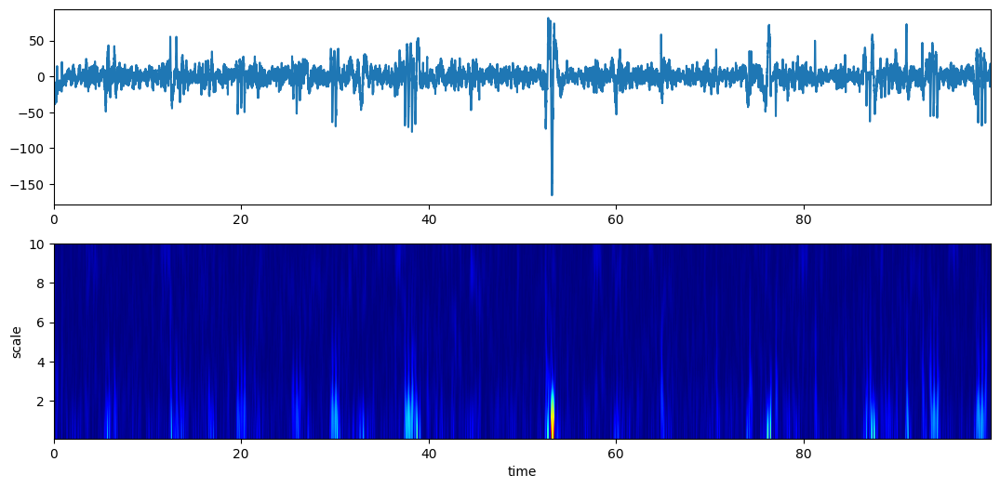

In [32]:
XW, S = sp.cwt.ScalogramCWT(signal_segment, t, fs = fs, wType = 'Morlet', PlotPSD=True)

In [33]:
power_morlet = np.abs(S)

In [34]:
print(power_morlet.shape)

(100,)


In [35]:
print(S.shape)

(100,)


In [36]:
print(power_morlet.mean())
print(power_morlet.std())
print(power_morlet.max())
print(power_morlet.min())

5.05
2.886607004772212
10.0
0.1


In [37]:
import itertools

In [38]:
threshold = 0

significant_times = np.where(power_morlet.max(axis=0) > threshold)[0]
print(len(significant_times))

1


<ipython-input-38-ccfebc641f2b>:3: DeprecationWarning: Calling nonzero on 0d arrays is deprecated, as it behaves surprisingly. Use `atleast_1d(cond).nonzero()` if the old behavior was intended. If the context of this warning is of the form `arr[nonzero(cond)]`, just use `arr[cond]`.


In [39]:
time_segments = [list(group) for _, group in itertools.groupby(significant_times, key = lambda x, c = itertools.count(): x - next(c))]
print(len(time_segments))

1


In [40]:
print(time_segments)

[[0]]


In [41]:
for segment in time_segments:
    start_time = t[segment[0]]
    end_time = t[segment[-1]]
    print(f"Significant time segment: {start_time:.2f}s to {end_time:.2f}s")

Significant time segment: 0.00s to 0.00s


In [42]:
# change another method, not using scalogramCWT
import pywt

In [43]:
scales = np.arange(1, 256)
sampling_period = 1.0 / fs
wavelet = 'morl'

In [44]:

coefficients, frequencies = pywt.cwt(signal_segment, scales, wavelet, sampling_period=sampling_period)

# (n_scales, n_times)
print("CWT coefficients shape:", coefficients.shape)


CWT coefficients shape: (255, 25600)


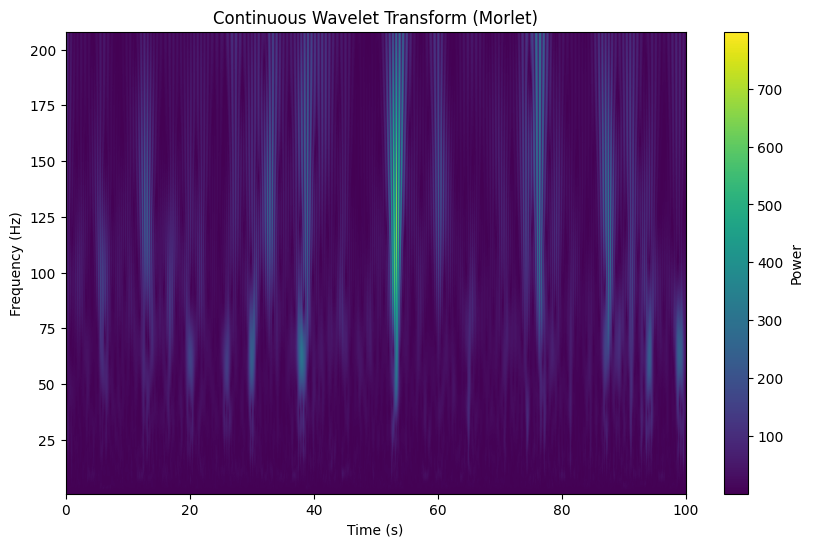

In [45]:
#
plt.figure(figsize=(10, 6))
plt.imshow(np.abs(coefficients), extent=[0, len(signal_segment) / fs, frequencies[-1], frequencies[0]],
aspect='auto', origin='lower')
plt.colorbar(label='Power')
plt.title('Continuous Wavelet Transform (Morlet)')
plt.xlabel('Time (s)')
plt.ylabel('Frequency (Hz)')


plt.show()

In [46]:
power = np.abs(coefficients) ** 2

In [47]:
max_power_per_time = power.max(axis=0)
max_power_index = np.argmax(power, axis=0)

In [48]:
dominant_frequency = frequencies[max_power_index]

In [49]:
threshold = np.percentile(max_power_per_time, 60)
print(threshold)

7424.289920956682


In [50]:
significant_times = np.where(max_power_per_time > threshold)[0]
print(len(significant_times))

10240


In [51]:
time_segments = [list(group) for _, group in itertools.groupby(significant_times, key = lambda x, c = itertools.count(): x - next(c))]

for segment in time_segments:
    start_time = segment[0] / fs
    end_time = segment[-1] / fs
    print(f"Significant time segment: {start_time:.2f}s to {end_time:.2f}s")

Significant time segment: 0.13s to 0.16s
Significant time segment: 2.11s to 2.16s
Significant time segment: 2.41s to 2.43s
Significant time segment: 5.06s to 5.67s
Significant time segment: 5.72s to 6.22s
Significant time segment: 6.28s to 6.51s
Significant time segment: 6.59s to 6.77s
Significant time segment: 6.91s to 6.91s
Significant time segment: 6.93s to 6.93s
Significant time segment: 6.95s to 6.95s
Significant time segment: 11.71s to 12.85s
Significant time segment: 12.91s to 13.27s
Significant time segment: 13.27s to 14.09s
Significant time segment: 14.11s to 14.21s
Significant time segment: 16.25s to 16.51s
Significant time segment: 16.53s to 16.72s
Significant time segment: 16.81s to 17.00s
Significant time segment: 17.07s to 17.31s
Significant time segment: 17.46s to 17.62s
Significant time segment: 19.29s to 19.55s
Significant time segment: 19.57s to 19.74s
Significant time segment: 19.78s to 19.92s
Significant time segment: 19.96s to 20.10s
Significant time segment: 20.14

In [53]:
print(time_segments)

[[34, 35, 36, 37, 38, 39, 40, 41, 42], [539, 540, 541, 542, 543, 544, 545, 546, 547, 548, 549, 550, 551, 552, 553], [618, 619, 620, 621, 622, 623], [1295, 1296, 1297, 1298, 1299, 1300, 1301, 1302, 1303, 1304, 1305, 1306, 1307, 1308, 1309, 1310, 1311, 1312, 1313, 1314, 1315, 1316, 1317, 1318, 1319, 1320, 1321, 1322, 1323, 1324, 1325, 1326, 1327, 1328, 1329, 1330, 1331, 1332, 1333, 1334, 1335, 1336, 1337, 1338, 1339, 1340, 1341, 1342, 1343, 1344, 1345, 1346, 1347, 1348, 1349, 1350, 1351, 1352, 1353, 1354, 1355, 1356, 1357, 1358, 1359, 1360, 1361, 1362, 1363, 1364, 1365, 1366, 1367, 1368, 1369, 1370, 1371, 1372, 1373, 1374, 1375, 1376, 1377, 1378, 1379, 1380, 1381, 1382, 1383, 1384, 1385, 1386, 1387, 1388, 1389, 1390, 1391, 1392, 1393, 1394, 1395, 1396, 1397, 1398, 1399, 1400, 1401, 1402, 1403, 1404, 1405, 1406, 1407, 1408, 1409, 1410, 1411, 1412, 1413, 1414, 1415, 1416, 1417, 1418, 1419, 1420, 1421, 1422, 1423, 1424, 1425, 1426, 1427, 1428, 1429, 1430, 1431, 1432, 1433, 1434, 1435, 1436,

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [54]:
min_length = 2 ** 4

short_segments = [segment for segment in time_segments if len(segment) < min_length]

for i, segment in enumerate(short_segments, 1):
    print(f"Short segment {i}: {segment}")

Short segment 1: [34, 35, 36, 37, 38, 39, 40, 41, 42]
Short segment 2: [539, 540, 541, 542, 543, 544, 545, 546, 547, 548, 549, 550, 551, 552, 553]
Short segment 3: [618, 619, 620, 621, 622, 623]
Short segment 4: [1770]
Short segment 5: [1775]
Short segment 6: [1780]
Short segment 7: [6458, 6459, 6460, 6461, 6462, 6463, 6464, 6465, 6466, 6467, 6468]
Short segment 8: [6780, 6781, 6782]
Short segment 9: [8782]
Short segment 10: [9422]
Short segment 11: [9426]
Short segment 12: [11556, 11557, 11558, 11559, 11560, 11561, 11562, 11563, 11564, 11565, 11566]
Short segment 13: [15749]
Short segment 14: [16518, 16519, 16520, 16521, 16522, 16523, 16524, 16525, 16526, 16527, 16528, 16529, 16530, 16531, 16532]
Short segment 15: [16534]
Short segment 16: [17955, 17956]
Short segment 17: [17960, 17961, 17962, 17963, 17964, 17965, 17966, 17967, 17968, 17969, 17970]
Short segment 18: [17972]
Short segment 19: [18090, 18091, 18092, 18093, 18094, 18095, 18096, 18097, 18098, 18099, 18100, 18101]
Short seg

In [55]:
first_derivatives = []
second_derivatives = []

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


Segment from index 1770 to 1770 is empty. Skipping.
Segment from index 1775 to 1775 is empty. Skipping.
Segment from index 1780 to 1780 is empty. Skipping.
Segment from index 8782 to 8782 is empty. Skipping.
Segment from index 9422 to 9422 is empty. Skipping.
Segment from index 9426 to 9426 is empty. Skipping.
Segment from index 15749 to 15749 is empty. Skipping.
Segment from index 16534 to 16534 is empty. Skipping.
Segment from index 17972 to 17972 is empty. Skipping.
Segment from index 18704 to 18704 is empty. Skipping.
Segment from index 18706 to 18706 is empty. Skipping.
Segment from index 22975 to 22975 is empty. Skipping.
Segment from index 23818 to 23818 is empty. Skipping.
Segment from index 23820 to 23820 is empty. Skipping.
Segment 1:
  First derivative (cD1) length: 7, values: [ 2.21282988  7.08198065 -1.42154644  0.88633097 -0.79786183 -0.70179618
 -7.25993706]
  Second derivative (cD2) length: 7, values: [-0.38794945 -1.51561582 -2.96895662  1.13063356 -0.67483495  3.67275

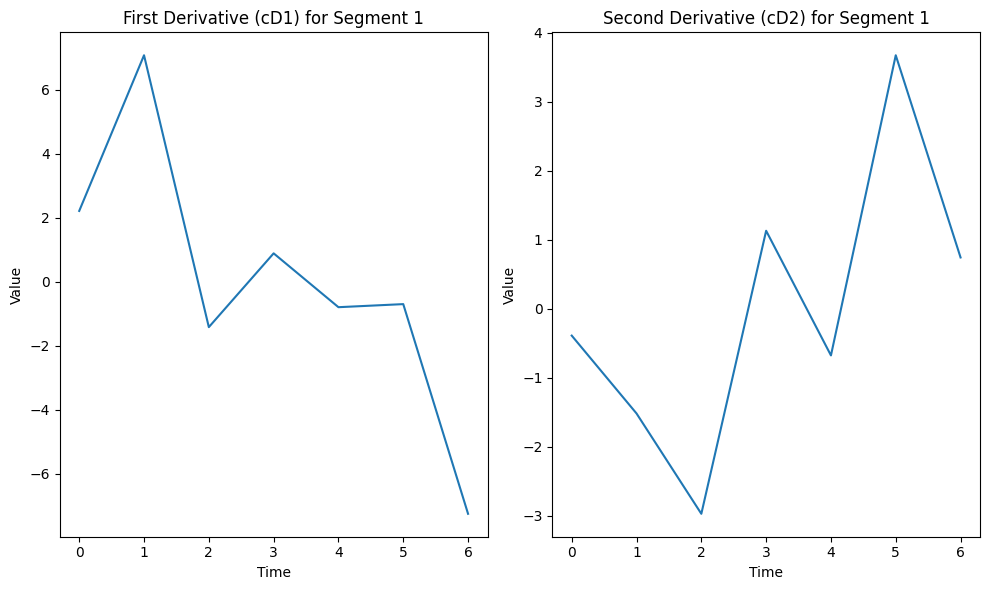

Segment 2:
  First derivative (cD1) length: 8, values: [ -3.13365693 -10.13216911   3.43484604   5.60677998  -6.29003517
   1.92660569   3.94678877  -7.79892165]
  Second derivative (cD2) length: 7, values: [-1.21890589 -3.27910444  6.63040027 -3.18473927  1.63536369 -0.27747289
 -4.91900768]


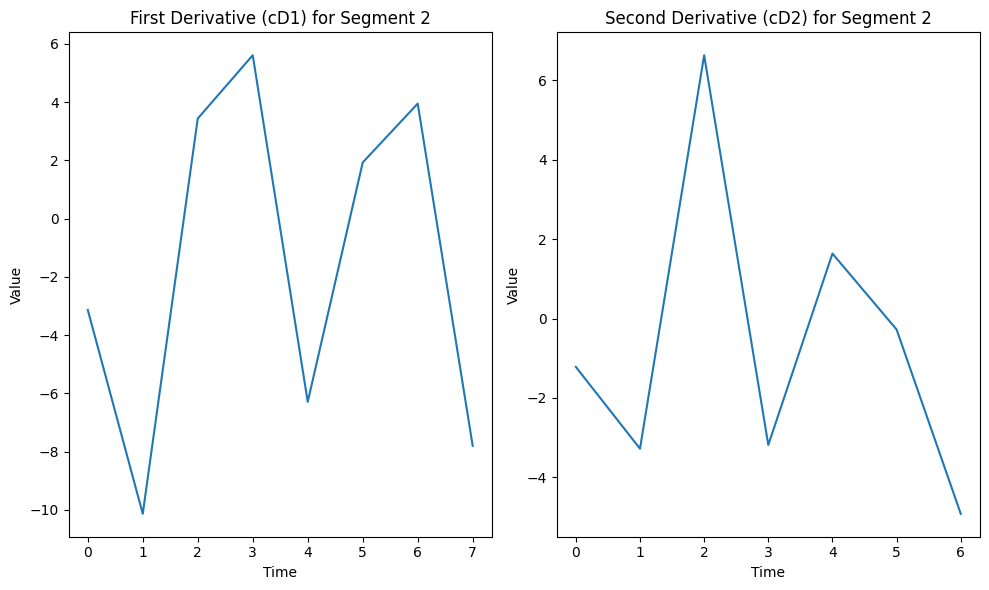

Segment 3:
  First derivative (cD1) length: 6, values: [ 1.58681567  5.07564764 -0.46686968  0.21117783 -1.38570913 -5.02106233]
  Second derivative (cD2) length: 6, values: [-0.35531281 -1.27688925 -1.04004867  0.35784388  1.28233108  1.03207577]


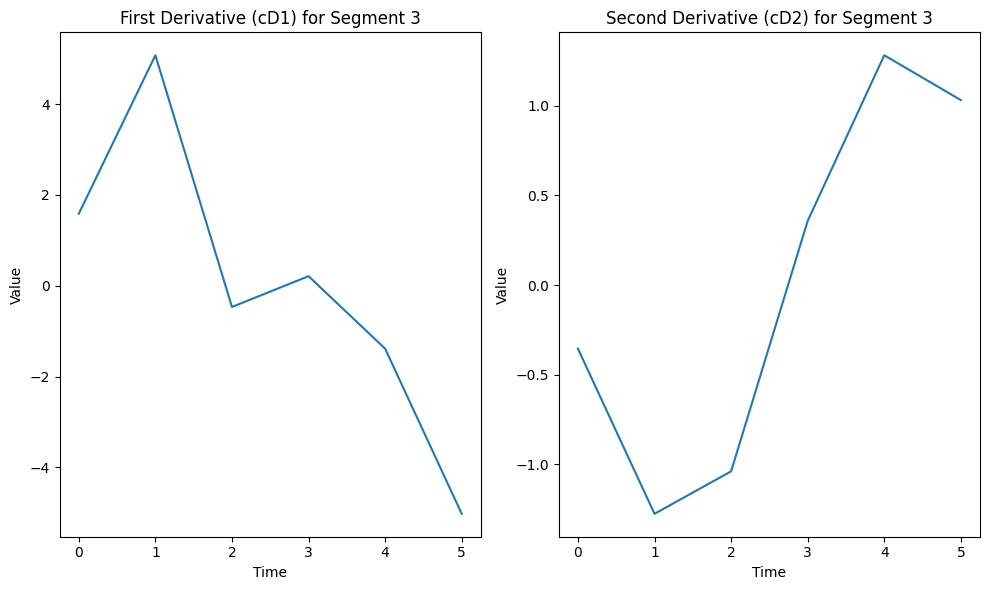

Segment 4:
  First derivative (cD1) length: 44, values: [ -0.6578107   -1.7719539    3.14668752  -0.90083146   2.77480418
  -2.35520553  -3.89857521   1.90482853  -0.73982055   4.45366051
  -2.27764162   0.44649491   1.28535393  -3.00424324  -2.12489804
   5.96991987  -6.18528601   4.68888934  -0.91063502   0.55695065
  -0.41178173  -3.651445     4.00388282  -0.57628565   3.25438562
  -1.33982826 -17.4445313   12.22822116   9.45514273  10.15077901
 -19.69229548  -9.50796097  24.127659   -27.28696287  14.03940837
   4.86033662   6.43474422  -4.42669274  -6.87328708  -0.04882927
  -4.49859469   1.72349933   4.13553417   0.66451353]
  Second derivative (cD2) length: 25, values: [  1.48242311   4.85230423   1.0232322    1.31511186  -2.49120495
   2.68008063  -1.50671836   6.87342872 -16.85659505   6.78749693
   1.70720107  -0.04448161   1.6946365   -5.33623468  12.25800911
   2.06524155  -1.06524468  -1.38653725  -3.85989717  -0.42463165
  -5.23454527   0.28156763  -0.23850195   1.52826834

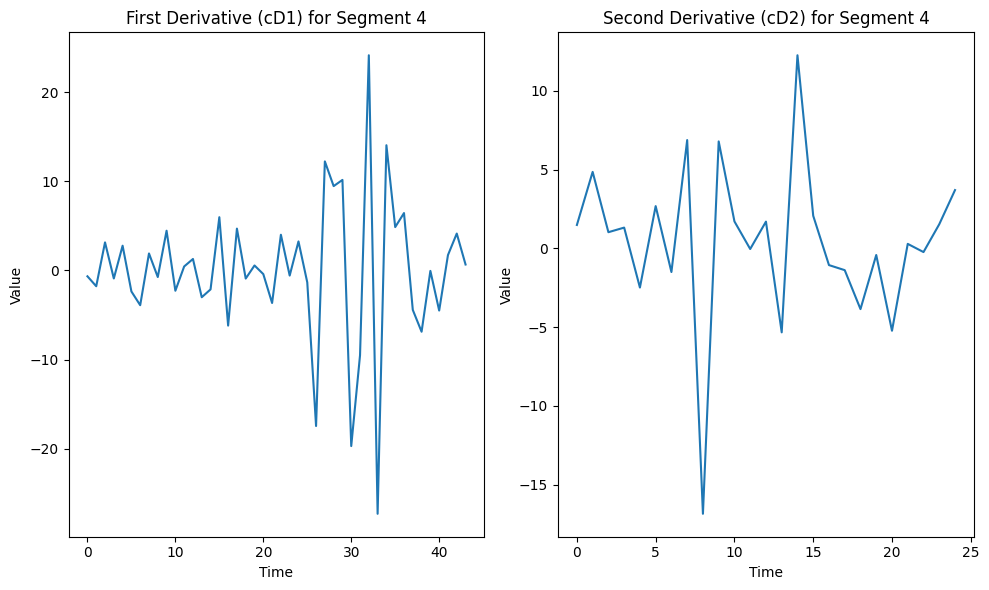

Segment 5:
  First derivative (cD1) length: 37, values: [-1.30647550e-02  2.03901705e+00  1.56081638e+01 -1.62991609e+01
 -3.63723858e+00  2.48509709e+00 -4.26654281e+00  9.66703660e+00
 -7.13808454e+00  8.32371215e+00  3.53365304e+00 -5.06059973e+00
 -1.22717158e+01 -2.83492208e+00  1.07615144e+01  1.42225887e+01
 -1.66514644e+00 -1.23924860e+01 -1.27958014e+01  6.08144075e-01
  1.67651812e+01  1.33971579e+01 -7.97907988e+00 -1.88245851e+01
 -4.28254143e-01  1.54614260e+01 -4.07561034e+00 -7.19513542e+00
  4.99261014e+00  5.65647845e+00 -8.81617164e+00  1.16244999e+01
  3.62962218e+00 -9.06811094e+00  2.95891296e+00  7.62414067e+00
 -1.11927555e+01]
  Second derivative (cD2) length: 22, values: [ 10.13046012  32.60445706  -1.23882772  18.01071018   6.16776631
   5.15650689  -0.23106938   0.10103466  -9.70239368  -4.95429816
  -2.32013548   1.44247943 -13.32196074  10.32625063  -2.11520826
   5.99551413 -14.36022356   3.22189638 -13.19377923  17.04543633
  -4.13742036  12.53531574]


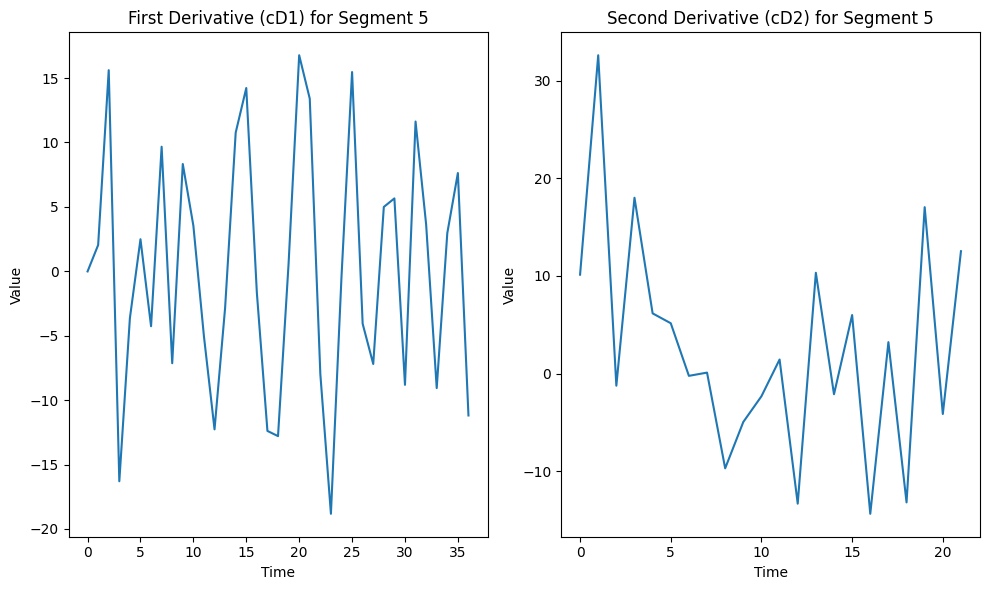

Segment 6:
  First derivative (cD1) length: 20, values: [ -2.26293525  -7.71448051  -0.69718556  10.20418607   2.1514798
  -6.64740653 -12.70371699  -1.05320344   5.2835194   16.71937331
  -6.48416889  -2.95179971  -3.56944212   9.19414785  -6.66903485
  -9.3051104   -0.13250722   3.83196415  10.0621753    0.11459165]
  Second derivative (cD2) length: 13, values: [ -2.73506471  -8.43826194   3.99195474   3.4587889    2.20030694
 -10.70657734  -5.52809365   9.44357015   2.61866132  -3.90675324
   2.43480335   0.9073146   -6.32835837]


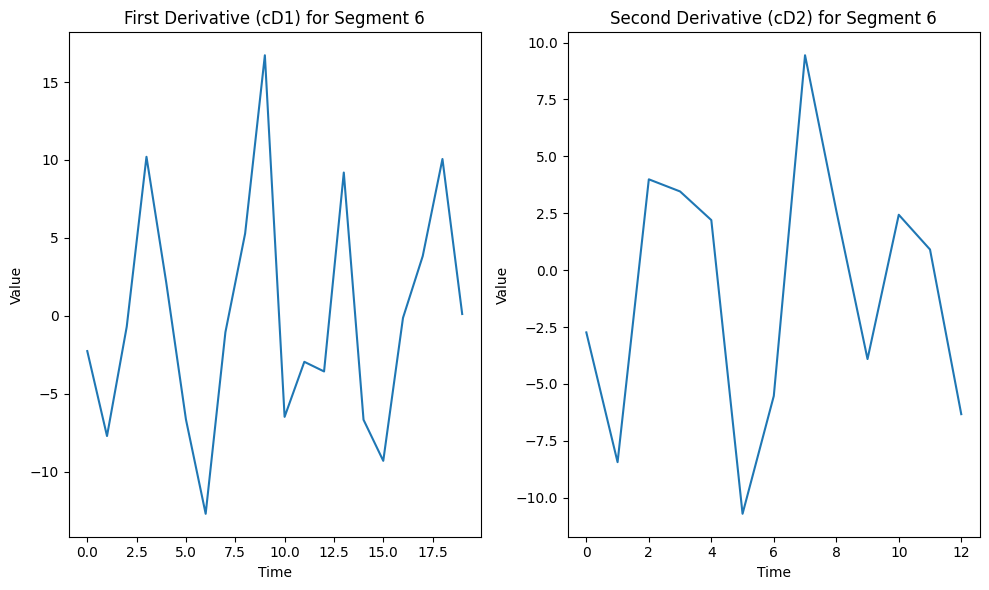

Segment 7:
  First derivative (cD1) length: 16, values: [ -2.02920696  -8.00628852 -13.72701303   1.06805636  16.72028744
  13.39689257  -7.9790322  -18.82480895  -0.42831116  15.46127414
  -4.07561715  -7.18846604   5.3617486   -2.14117299  -2.0159977
   8.70539904]
  Second derivative (cD2) length: 11, values: [ -4.94474373 -16.08743398  -0.43063477   0.97303582 -12.89549765
  10.31567652  -2.00053699  10.40581962  -4.04301493  -8.20584542
   1.23216299]


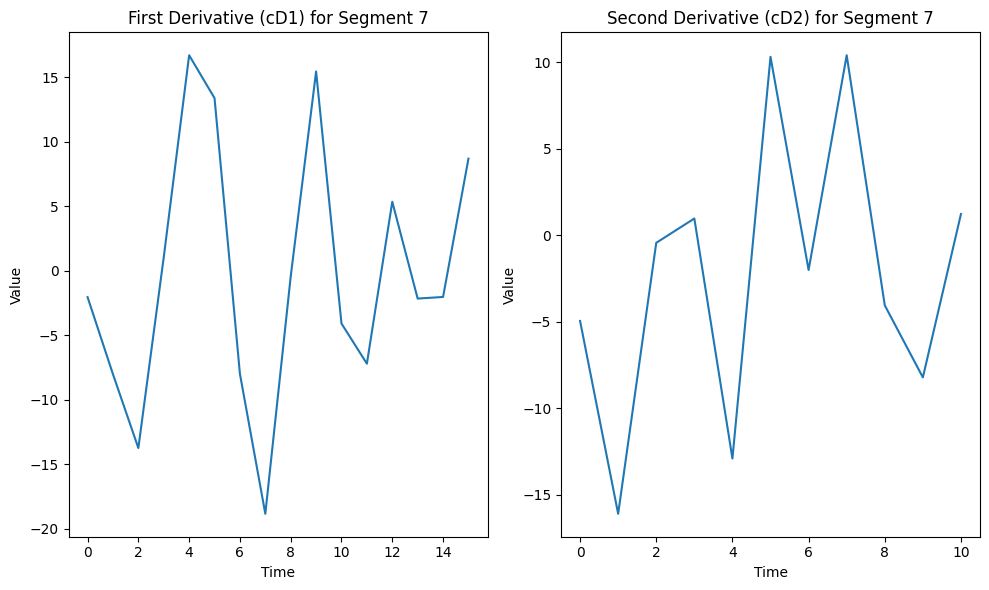

Segment 8:
  First derivative (cD1) length: 7, values: [ 2.21282988  7.08198065 -1.42154644  0.88633097 -0.79786183 -0.70179618
 -7.25993706]
  Second derivative (cD2) length: 7, values: [-0.38794945 -1.51561582 -2.96895662  1.13063356 -0.67483495  3.67275697
  0.74396631]


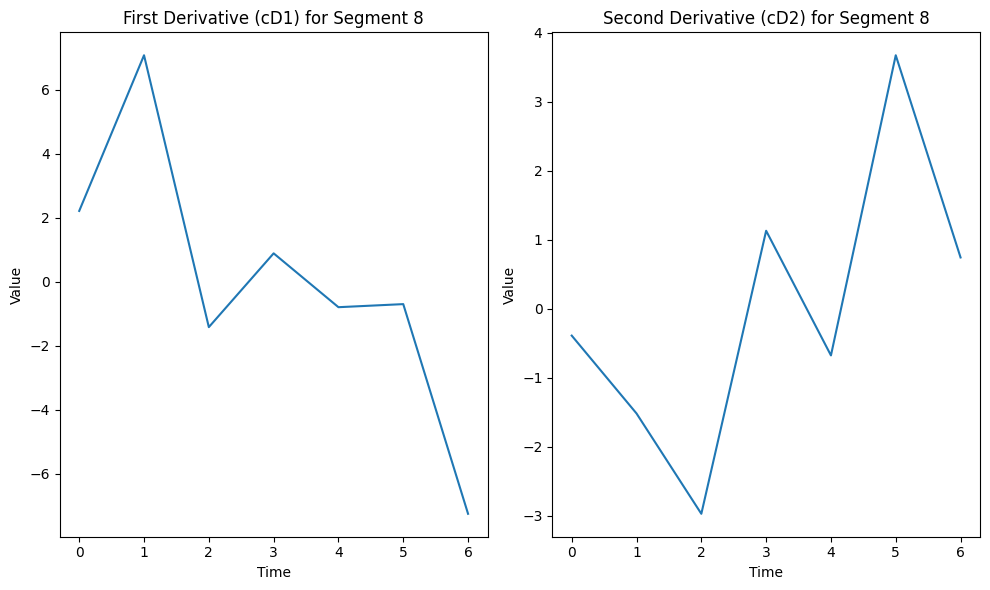

Segment 9:
  First derivative (cD1) length: 8, values: [ -3.13365693 -10.13216911   3.43484604   5.60677998  -6.29003517
   1.92660569   3.94678877  -7.79892165]
  Second derivative (cD2) length: 7, values: [-1.21890589 -3.27910444  6.63040027 -3.18473927  1.63536369 -0.27747289
 -4.91900768]


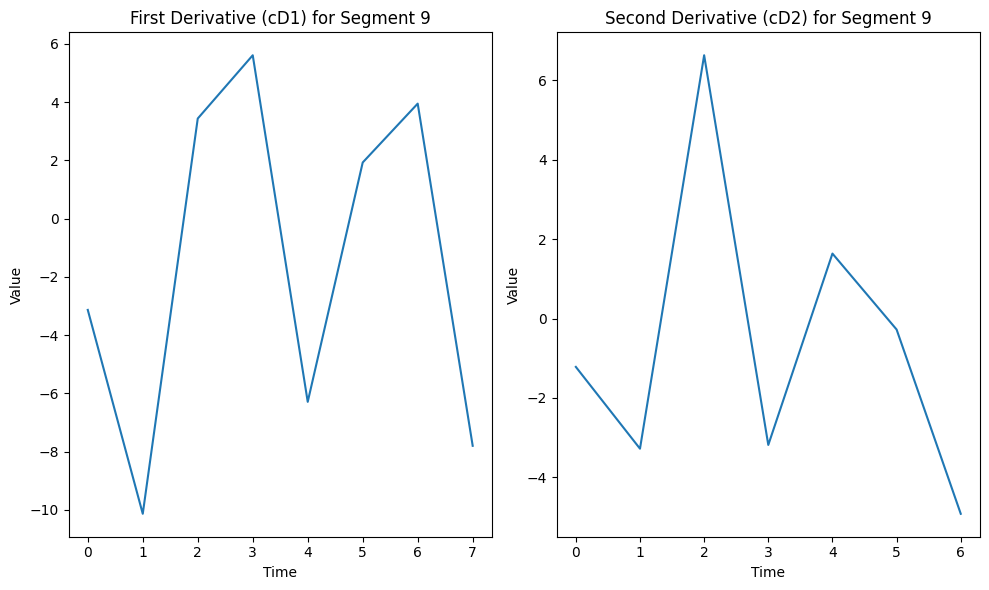

Segment 10:
  First derivative (cD1) length: 6, values: [ 1.58681567  5.07564764 -0.46686968  0.21117783 -1.38570913 -5.02106233]
  Second derivative (cD2) length: 6, values: [-0.35531281 -1.27688925 -1.04004867  0.35784388  1.28233108  1.03207577]


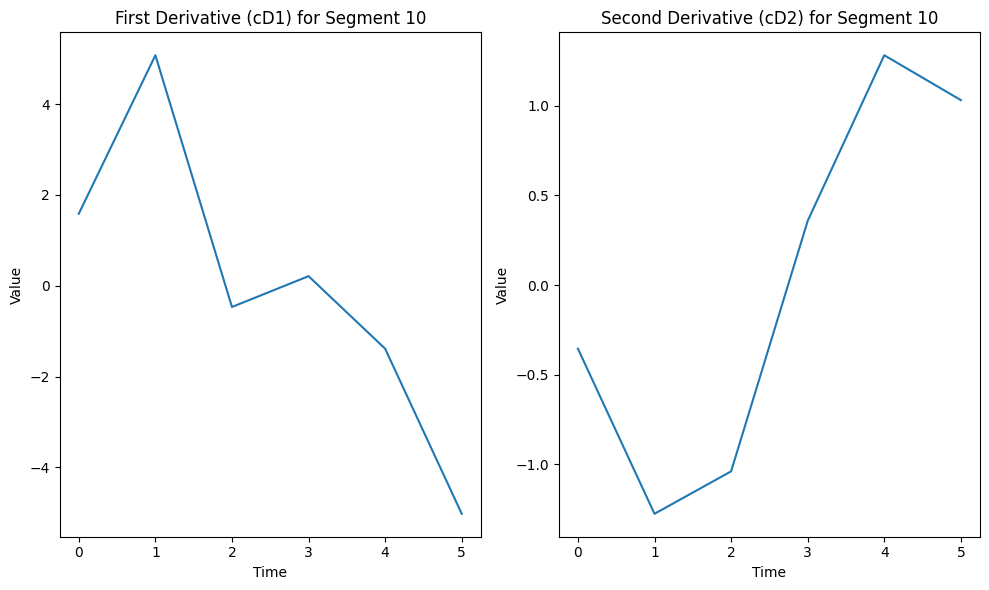

Segment 11:
  First derivative (cD1) length: 44, values: [ -0.6578107   -1.7719539    3.14668752  -0.90083146   2.77480418
  -2.35520553  -3.89857521   1.90482853  -0.73982055   4.45366051
  -2.27764162   0.44649491   1.28535393  -3.00424324  -2.12489804
   5.96991987  -6.18528601   4.68888934  -0.91063502   0.55695065
  -0.41178173  -3.651445     4.00388282  -0.57628565   3.25438562
  -1.33982826 -17.4445313   12.22822116   9.45514273  10.15077901
 -19.69229548  -9.50796097  24.127659   -27.28696287  14.03940837
   4.86033662   6.43474422  -4.42669274  -6.87328708  -0.04882927
  -4.49859469   1.72349933   4.13553417   0.66451353]
  Second derivative (cD2) length: 25, values: [  1.48242311   4.85230423   1.0232322    1.31511186  -2.49120495
   2.68008063  -1.50671836   6.87342872 -16.85659505   6.78749693
   1.70720107  -0.04448161   1.6946365   -5.33623468  12.25800911
   2.06524155  -1.06524468  -1.38653725  -3.85989717  -0.42463165
  -5.23454527   0.28156763  -0.23850195   1.5282683

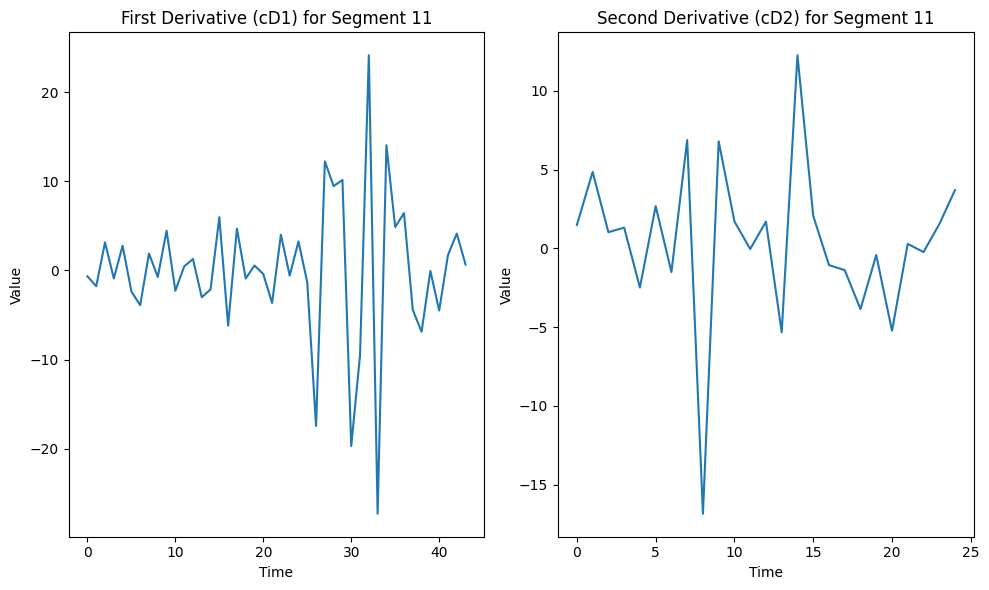

Segment 12:
  First derivative (cD1) length: 37, values: [-1.30647550e-02  2.03901705e+00  1.56081638e+01 -1.62991609e+01
 -3.63723858e+00  2.48509709e+00 -4.26654281e+00  9.66703660e+00
 -7.13808454e+00  8.32371215e+00  3.53365304e+00 -5.06059973e+00
 -1.22717158e+01 -2.83492208e+00  1.07615144e+01  1.42225887e+01
 -1.66514644e+00 -1.23924860e+01 -1.27958014e+01  6.08144075e-01
  1.67651812e+01  1.33971579e+01 -7.97907988e+00 -1.88245851e+01
 -4.28254143e-01  1.54614260e+01 -4.07561034e+00 -7.19513542e+00
  4.99261014e+00  5.65647845e+00 -8.81617164e+00  1.16244999e+01
  3.62962218e+00 -9.06811094e+00  2.95891296e+00  7.62414067e+00
 -1.11927555e+01]
  Second derivative (cD2) length: 22, values: [ 10.13046012  32.60445706  -1.23882772  18.01071018   6.16776631
   5.15650689  -0.23106938   0.10103466  -9.70239368  -4.95429816
  -2.32013548   1.44247943 -13.32196074  10.32625063  -2.11520826
   5.99551413 -14.36022356   3.22189638 -13.19377923  17.04543633
  -4.13742036  12.53531574]


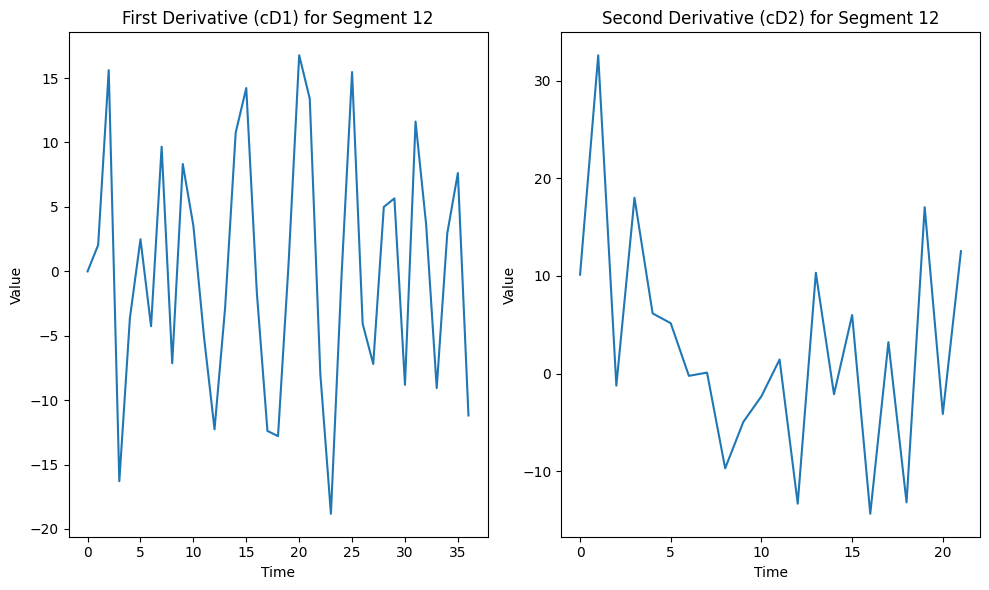

Segment 13:
  First derivative (cD1) length: 20, values: [ -2.26293525  -7.71448051  -0.69718556  10.20418607   2.1514798
  -6.64740653 -12.70371699  -1.05320344   5.2835194   16.71937331
  -6.48416889  -2.95179971  -3.56944212   9.19414785  -6.66903485
  -9.3051104   -0.13250722   3.83196415  10.0621753    0.11459165]
  Second derivative (cD2) length: 13, values: [ -2.73506471  -8.43826194   3.99195474   3.4587889    2.20030694
 -10.70657734  -5.52809365   9.44357015   2.61866132  -3.90675324
   2.43480335   0.9073146   -6.32835837]


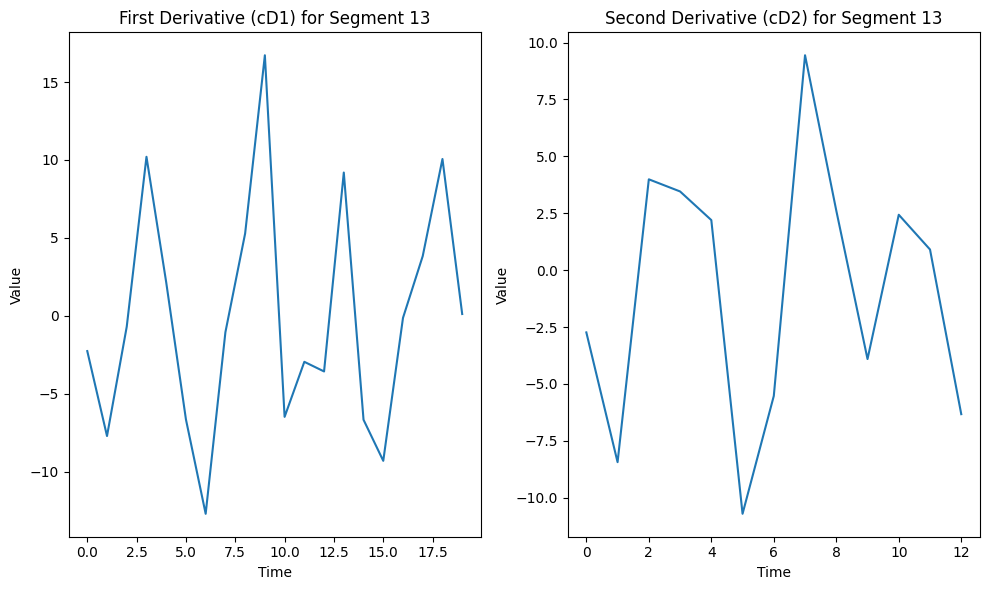

Segment 14:
  First derivative (cD1) length: 16, values: [ -2.02920696  -8.00628852 -13.72701303   1.06805636  16.72028744
  13.39689257  -7.9790322  -18.82480895  -0.42831116  15.46127414
  -4.07561715  -7.18846604   5.3617486   -2.14117299  -2.0159977
   8.70539904]
  Second derivative (cD2) length: 11, values: [ -4.94474373 -16.08743398  -0.43063477   0.97303582 -12.89549765
  10.31567652  -2.00053699  10.40581962  -4.04301493  -8.20584542
   1.23216299]


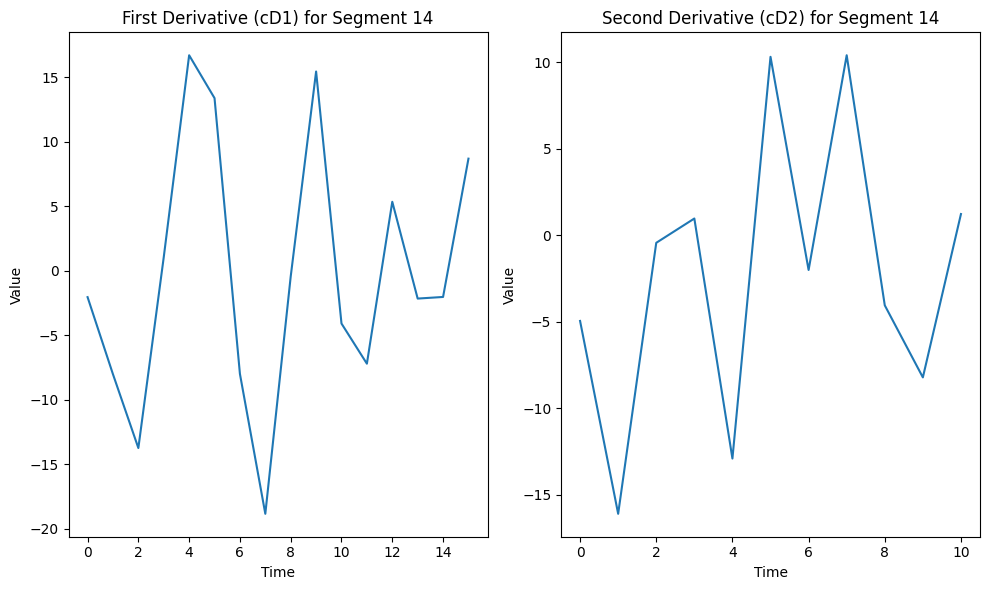

Segment 15:
  First derivative (cD1) length: 78, values: [ 1.06078888  2.27182168 -5.15919187 -4.34381365  9.1274759  -3.58400804
 -4.67966792  8.77039996 -3.59229268 -6.11316521  8.83818528 -3.78556786
  1.4566856  -4.08407415  7.49562139 -8.4287223  -3.28039609 13.33238877
 -4.40884944 -1.44405725 -2.06665051  0.04616973  3.64355403 -0.07846378
 -6.18158055  5.63015906  0.60554299  0.40416127 -6.85394594  2.14246356
  6.07452487 -5.70319792  2.03536777  0.85970778 -1.04997191 -3.18032049
  6.41918102 -0.20758418 -3.71746547  0.49550897 -0.33235959 -1.81928436
 -1.32780346  4.96584515 -0.66309778 -4.02635165  8.75876454  3.23823741
 -8.65713898 -7.25870633 10.39830002 -7.31544321  3.80767287  0.60958924
  3.54239477 -5.89358911  1.74135121 -2.10033515  9.58836751 -5.40275852
 -7.29614747  4.83408158 -1.93512216 10.26047227 -7.14727643 -5.82720915
  4.09096122  0.42117119  5.73522854 -7.47877942  7.31491156 -2.84424108
 -2.66507099 -2.6031286   1.13055546 -1.30851213  3.87991694  3.530

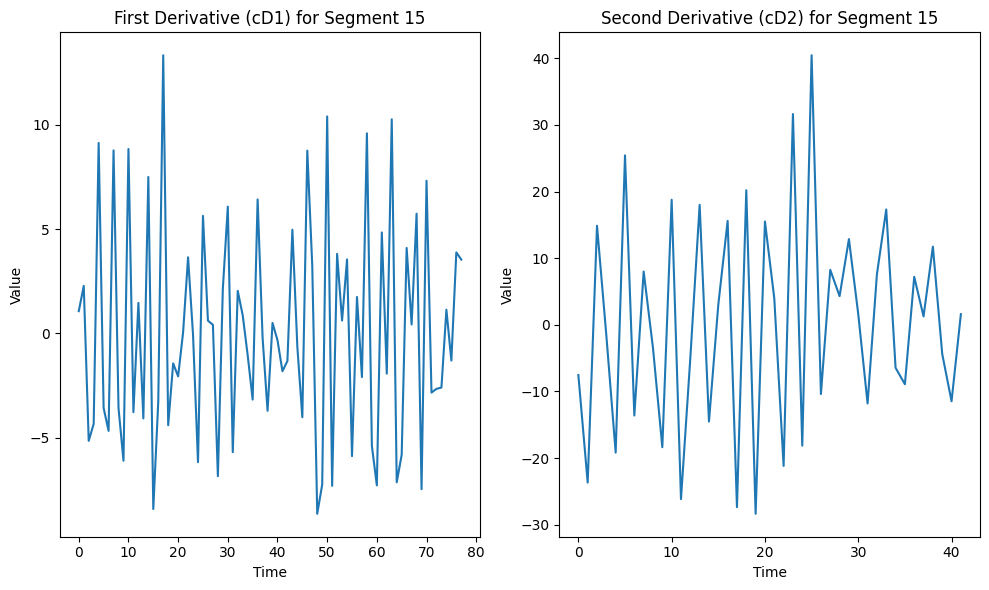

Segment 16:
  First derivative (cD1) length: 27, values: [ -4.32862835 -13.49146582   7.23903797   8.03932574  -4.03684462
  -4.60131266  -1.0418667    3.78664907   0.25899281  -2.11282129
  -4.35829753   6.52638338   2.42426537  -5.30654679  -0.49650286
   9.18217691  -1.69429427  -9.08980164  -1.82088923   1.27023445
   2.62336428   3.65777544   0.37552442   3.72994258  -0.44962794
  -4.65486568   0.4677092 ]
  Second derivative (cD2) length: 17, values: [  1.20730077   4.53050632   5.04461962  13.62519875   6.55993122
   4.66677639  15.39832853   6.8341627  -10.86354525   7.93719375
  -5.48107966  -3.02840348  11.39342714   7.35313453 -13.07198134
  -7.24891952   7.96096997]


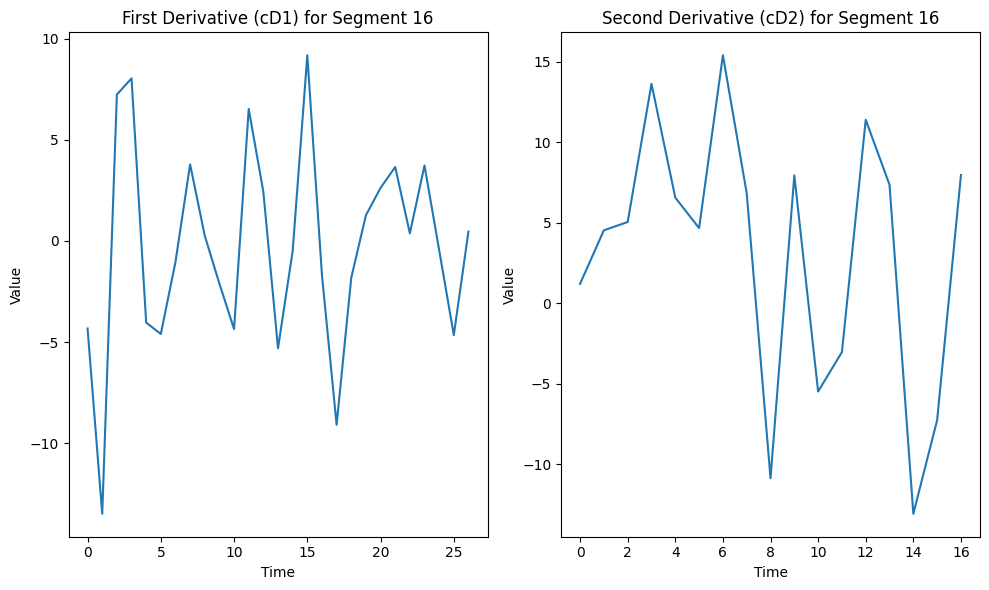

Segment 17:
  First derivative (cD1) length: 57, values: [ -1.97396656  -7.82957723  -7.01391246   3.44451666  -4.57006891
   9.66410757   0.41957976   4.25346963 -14.45738093   7.1970454
  -0.70981851   1.33601222   0.35876595  -0.14813756  -0.15557748
  -1.49258698  -1.626098     1.81032768   1.93788943   1.10525704
  -8.32021009   7.75812544   1.5054918   -5.35086785   0.05398377
   5.05783902  -4.32923655   4.74478768  -1.56465782 -11.6007322
  12.37882471  -1.30306743  -2.66216718   2.76267294   4.57369752
 -14.36512379   6.84029878   6.23253519  -7.18843106   5.04794251
 -12.22509807  15.74181633  -1.58184998  -6.37780864  -0.08437682
   1.0513135    5.75479367 -15.27391175  14.65832023  -3.58879407
   1.16342996  -4.14703423   6.28580089  -7.34610666   2.80686884
   3.59121899  -6.44552689]
  Second derivative (cD2) length: 32, values: [ -8.29814761 -25.92703455  12.66853314   9.88511087  -9.84303513
   1.78825413  14.18001314 -33.63400875   2.04053711   6.99363398
 -10.99725583

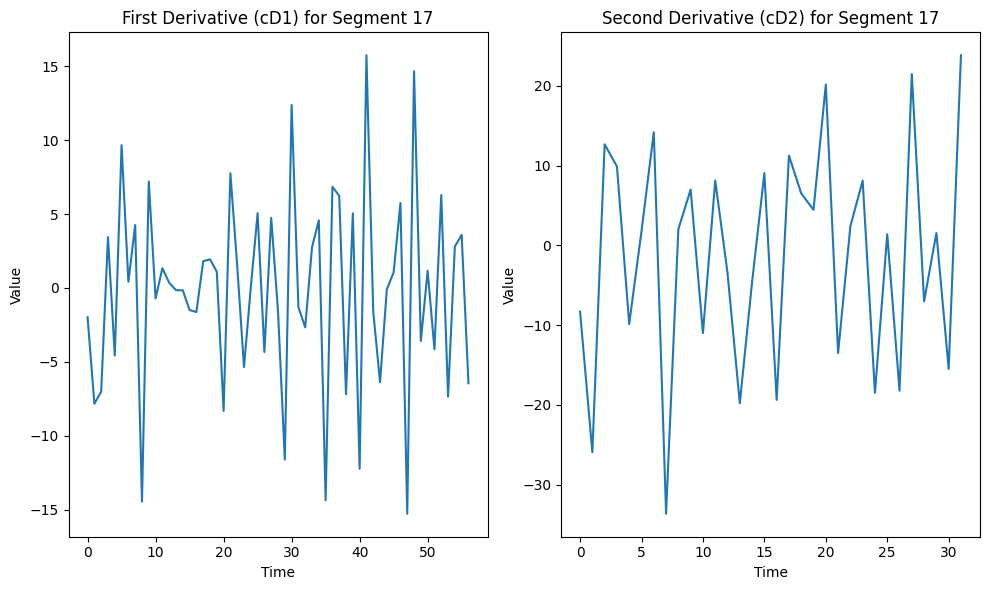

Segment 18:
  First derivative (cD1) length: 11, values: [ 0.97989644  3.25978513 -1.51287039 -8.81704353  8.89036415 -1.58214958
  0.61499983 -3.92421343  5.08479436 -1.31393055 -1.62539824]
  Second derivative (cD2) length: 9, values: [  1.63964425   4.95357464  -2.01616119  12.34876247  -3.46775273
   0.89953319   0.34445661  -1.3205645  -11.45343747]


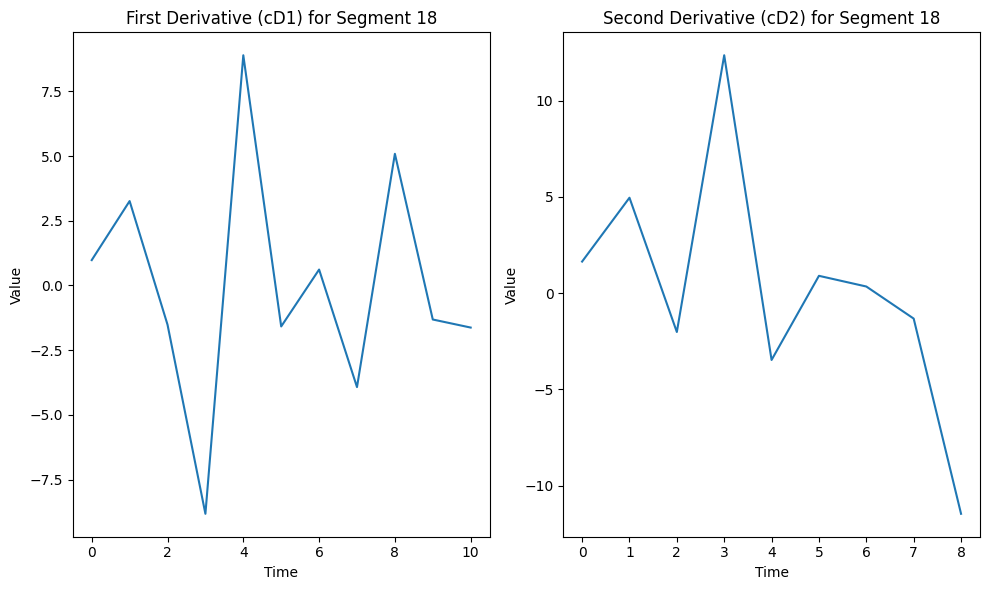

Segment 19:
  First derivative (cD1) length: 21, values: [-1.95235314 -5.77165242  7.64285337  0.32896711 -7.32711397  4.5034347
 -7.64822371 13.83411164 -7.43974174  2.07802771 -1.86345323  4.39793793
 -9.77195019  8.66844061 -0.75414173 -5.83471726  5.49796079 -2.06956776
  0.57081664  0.36325586 -3.67507827]
  Second derivative (cD2) length: 14, values: [  0.9320462    3.61921582   7.00565388  10.01113403   8.0483713
  -6.55746883   7.18190205  -1.29887965  10.59342205  -8.65177407
   2.68610895  -1.42067268   6.30912163 -12.91152195]


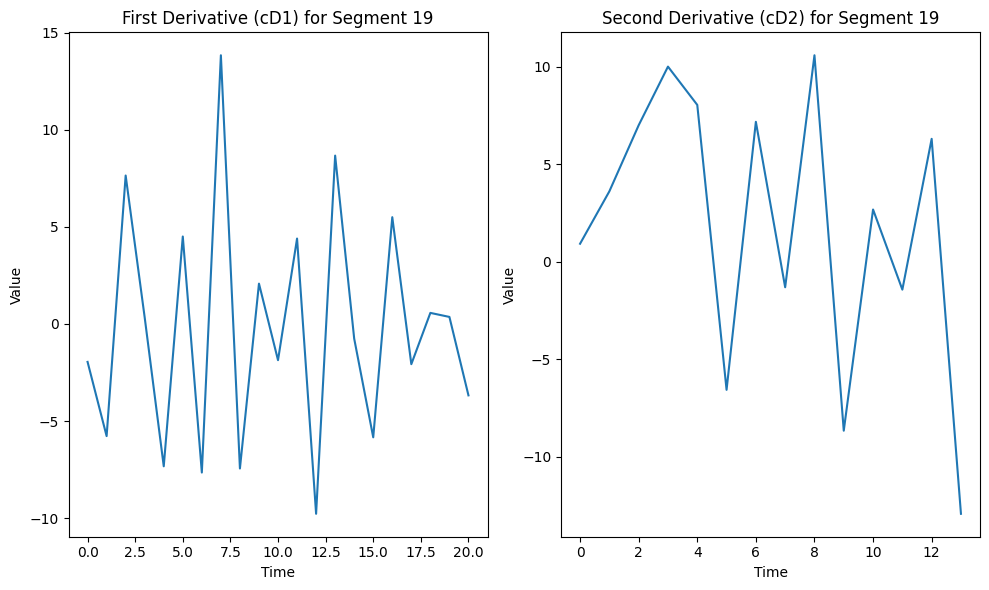

Segment 20:
  First derivative (cD1) length: 17, values: [ 0.86471556  1.99405519 -4.66019218  0.87592869  2.41253209 -0.02767221
 -0.54826945 -1.70022913 -0.01552418  2.30302267 -2.01826367 -0.12944651
 -1.07647928  3.06529563 -0.83744145 -2.7080646   1.85740205]
  Second derivative (cD2) length: 12, values: [ -4.70554851 -14.95300956   5.65892903  -6.13969987  11.29060176
  -7.75949128  -7.6654605    6.35975686  -1.11577473  -0.90146212
  -4.10649768  11.58035395]


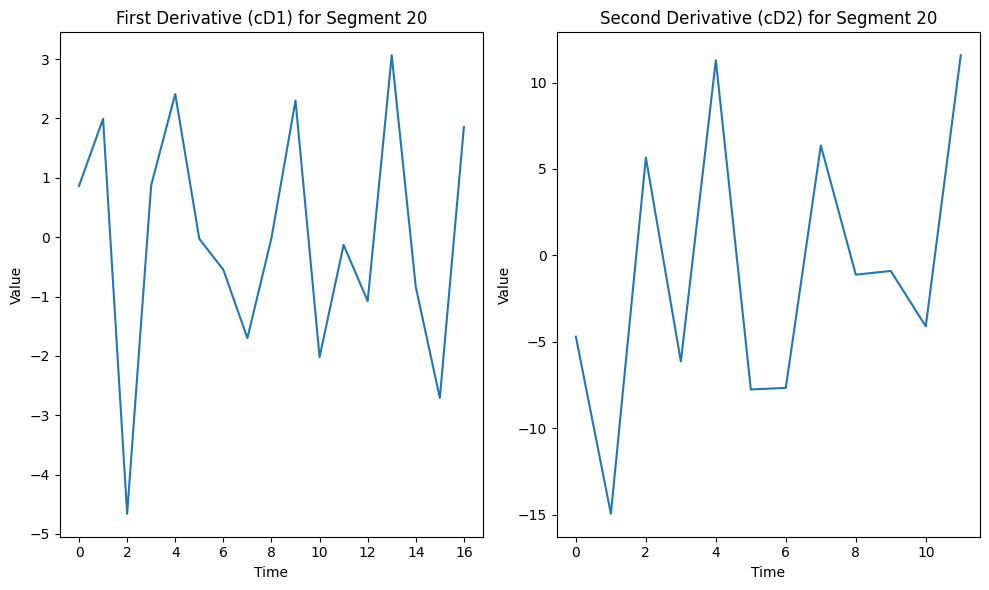

Segment 21:
  First derivative (cD1) length: 17, values: [-1.18998829 -3.30545379  5.6282259  -2.72357103 -5.14193837  6.05306588
 -0.86039772 -1.22160676  1.34056352 -5.25231309  4.80267806  1.04967916
 -3.39131652  0.08494827 -0.15902459  1.14666612  2.8881065 ]
  Second derivative (cD2) length: 12, values: [ 1.97928494  6.67871193  2.97262284 -8.10353092 13.1803516  -5.87536624
 10.10872361 -3.68055237  0.14026006  0.83941211  0.92383845 -8.30901653]


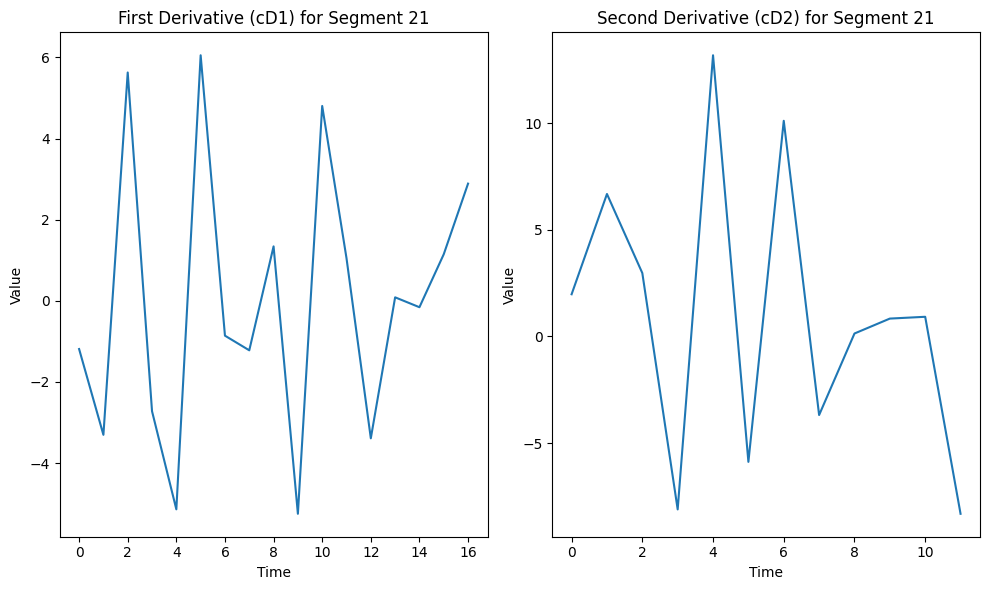

Segment 22:
  First derivative (cD1) length: 21, values: [ 0.64074593  2.09689696 -1.01534593  5.33398302  0.19080415 -0.2043569
 -2.07732358 -0.86812363  1.84951458 -0.69207645 -0.53197721 -1.5128421
  1.99340052 -4.63739517  8.94799937 -1.91338622 -1.27335615 -0.34206627
  0.5443782   1.72399273 -1.42491373]
  Second derivative (cD2) length: 14, values: [ 0.4531125   1.19021207 -5.09970832 13.46664502 -1.34779881  1.78948521
  6.47650532 -1.28694491 -1.66181763  6.89872639 -4.47651769  2.70361931
 -7.2074149   5.55949661]


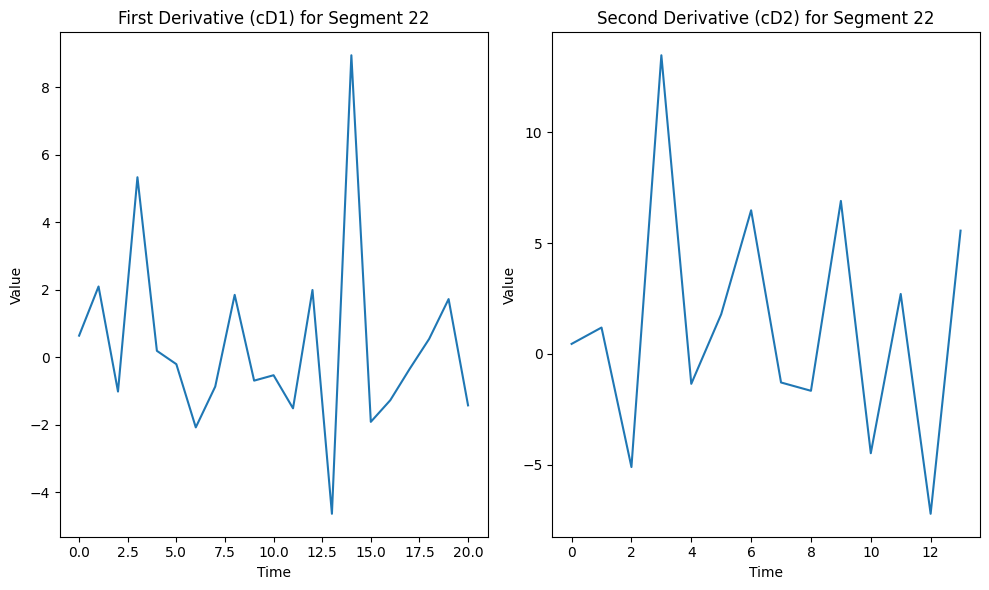

Segment 23:
  First derivative (cD1) length: 15, values: [ 0.73931703  2.01253595 -3.65687192  1.31021262  1.35827982 -2.01644303
 -2.05701177  4.55304952 -2.88008396  0.73474453  3.15848224 -7.09259576
  2.3908861   5.03763297 -5.0435045 ]
  Second derivative (cD2) length: 11, values: [-1.39697084 -4.65910333 -1.59274664  0.08309415 -8.52366387  2.25076738
  6.59926974 -5.32226835  4.56247871 -8.17384282  3.19106376]


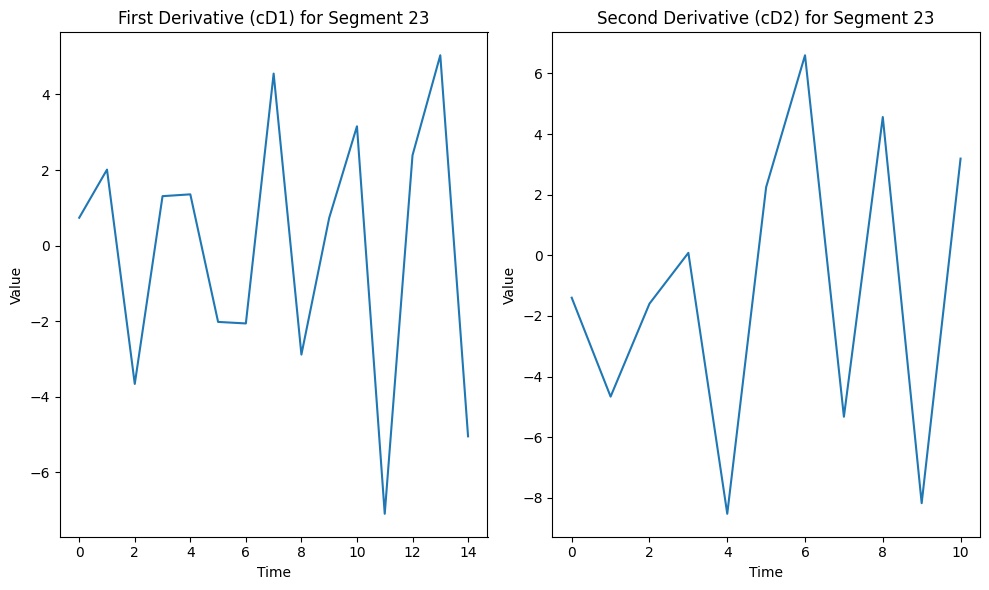

Segment 24:
  First derivative (cD1) length: 22, values: [ 1.75247719  6.27189004  2.63059462 -1.53713528 -4.34969853  2.14949452
  5.56197509 -7.38347568  0.69337416  1.80816277  2.85569425 -3.69373749
 -0.61950964  2.10951511  3.71618282 -9.15877296  4.5342547   2.69045533
 -0.74454432  0.2472186  -4.25852414 -0.16906092]
  Second derivative (cD2) length: 14, values: [ 3.481226   10.80449894 -7.06149816 -1.30983606 -4.48633867 -8.31721092
 -0.50867413 -2.24761092  4.53135006 -1.51211423 -1.7346034   0.86387561
  2.05050275 -0.51618104]


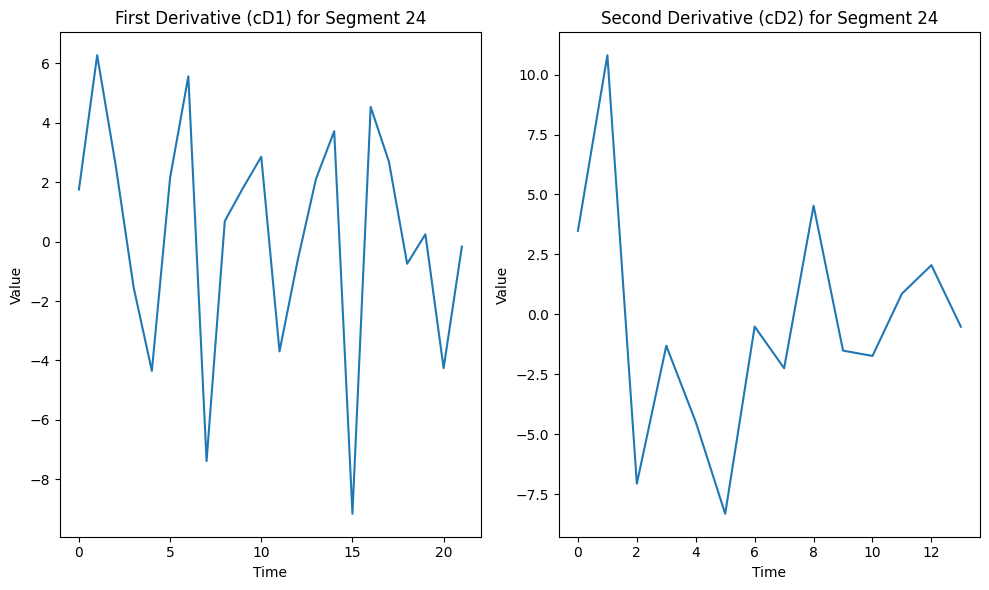

Segment 25:
  First derivative (cD1) length: 15, values: [-2.93360812e-01 -1.28666459e+00 -2.07329493e+00  4.63997666e+00
 -4.02236828e+00  4.78028010e+00 -5.02177818e+00  4.94641452e+00
  1.41653801e-04 -2.52375303e+00 -1.93263139e+00 -4.26496602e-02
 -1.50490774e-01  1.22087668e+00  1.73629124e+00]
  Second derivative (cD2) length: 11, values: [ -1.91900773  -6.08417483   0.29114798 -11.17119324  23.92501687
  -3.03579417  -5.81046586  -3.96531042   5.83488579   3.67324529
  -3.35156729]


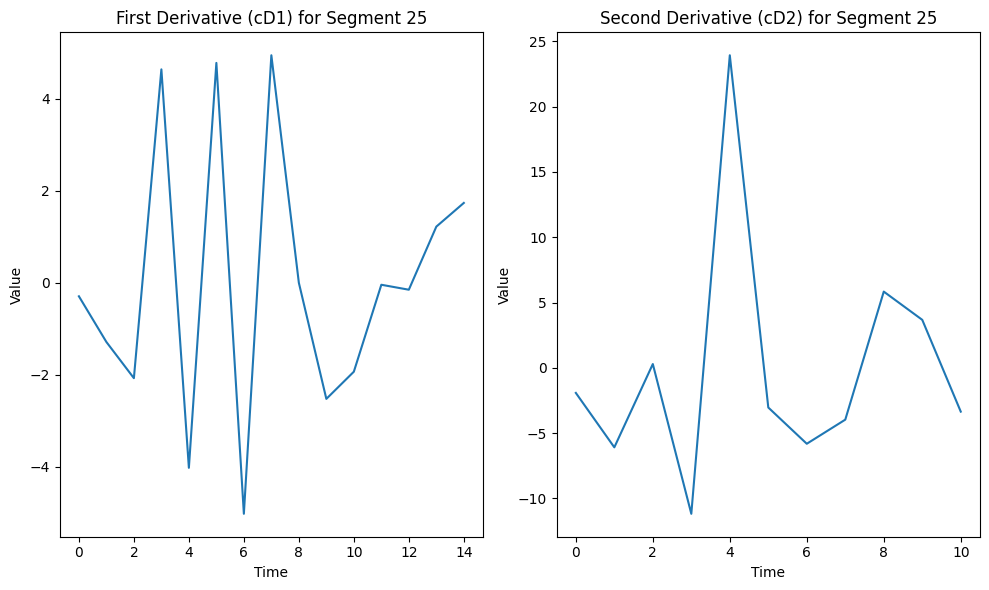

Segment 26:
  First derivative (cD1) length: 14, values: [-1.77620042e+00 -5.22847181e+00  4.22310084e+00  2.94459248e+00
 -4.45400866e+00  2.04993429e+00  2.33013046e+00 -3.98815545e-01
 -5.50803605e+00  1.47991211e+00 -6.29919690e-04 -8.89152854e-02
 -2.56953937e-01  4.40318574e-01]
  Second derivative (cD2) length: 10, values: [ 2.50314465  8.1653287  -1.71734935 -1.39957826 -1.71685672  1.50251823
  0.84996878  0.26767146 -1.34164179 -1.13107788]


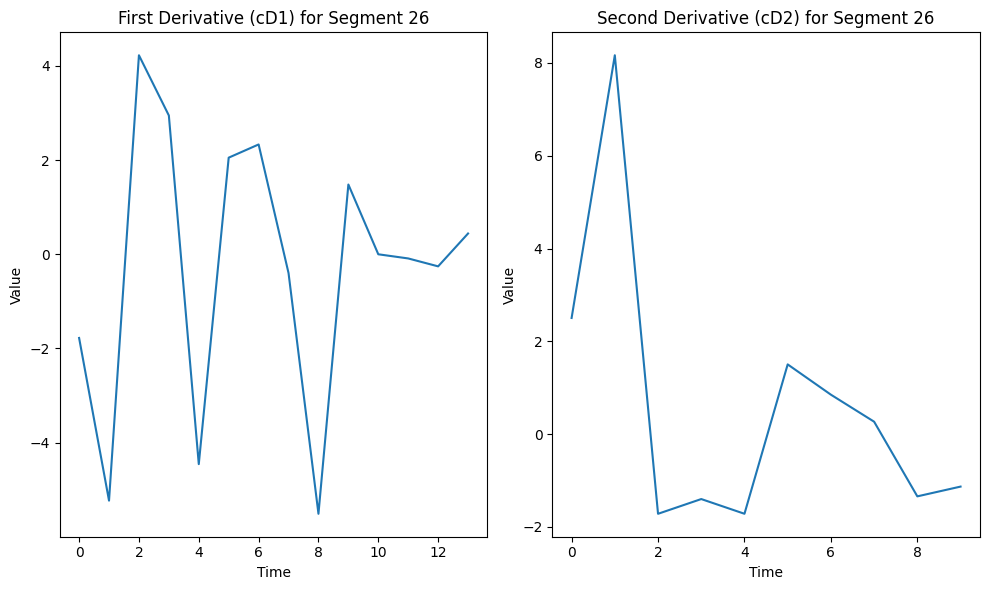

Segment 27:
  First derivative (cD1) length: 14, values: [ 0.05632104 -0.0336813   1.36204428 -5.86898139  8.98825377 -2.70296931
 -5.83314686  8.08207059 -8.41133174  4.58324268 -2.25686192  1.6169342
 -3.33291964  7.70333376]
  Second derivative (cD2) length: 10, values: [ -2.89281099  -8.80873596  11.92184942 -38.60380786  -2.25675375
  27.97386476   6.71805232  -2.81572159 -16.95415163 -20.25833892]


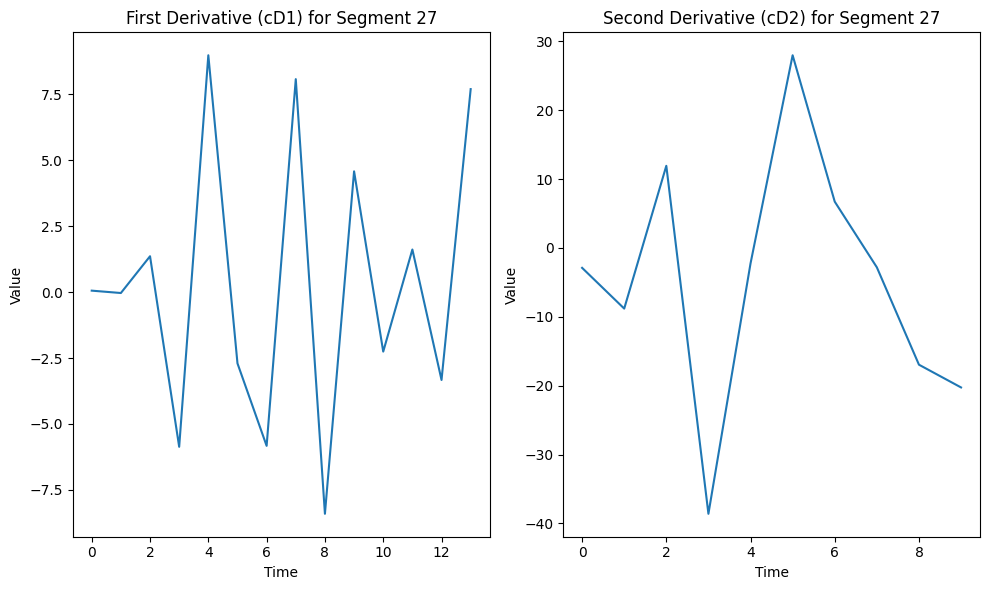

Segment 28:
  First derivative (cD1) length: 14, values: [ 2.15763591  6.20699409 -7.54910802  2.72028798 -0.9917033   0.75631581
  3.48673044  0.44895427 -2.46316983 -1.85390343 -0.60947975  1.73480934
  2.19857721  1.24707279]
  Second derivative (cD2) length: 10, values: [ -3.00015727 -10.01679604  -3.99628084   2.26243299   4.95140368
  -3.13584011  -3.0581803    1.76700047   3.04713776   0.20165993]


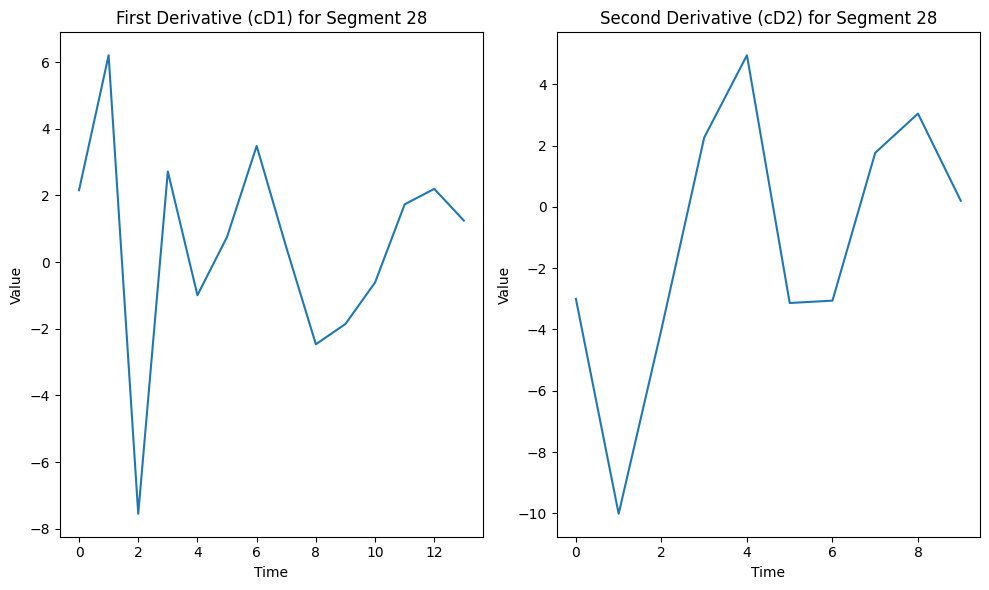

Segment 29:
  First derivative (cD1) length: 14, values: [ 1.80724739  4.72916297 -1.62764554  1.73879085 -1.25381912 -4.32939262
  5.43697496 -1.92887174  5.88510713 -7.1637831   1.95496482  0.03658047
 -0.43812966  5.41547995]
  Second derivative (cD2) length: 10, values: [ -9.46879067 -29.54597969  19.45559563  -9.88475136  10.30841443
 -11.37985163  -8.0087067    1.74714077  11.00816842   3.05707357]


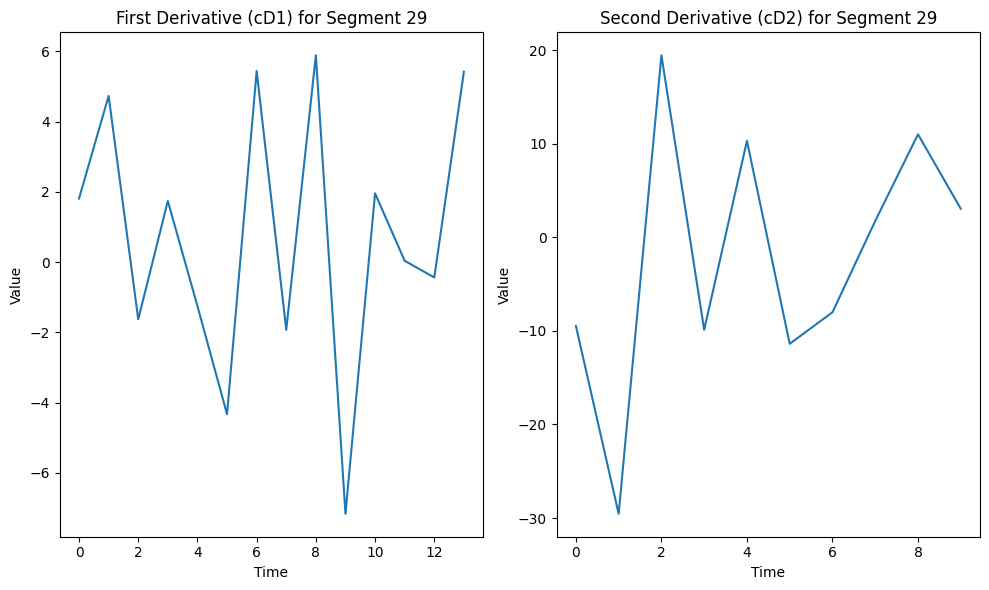

Segment 30:
  First derivative (cD1) length: 15, values: [-1.48383119 -4.58363941  2.18589341 -3.21681371  6.43541299 -7.2433463
  4.02394094  0.38601971 -4.0275106  -0.69902133  1.43665252 -0.11558558
 -0.24549557 -1.12201351  2.1891955 ]
  Second derivative (cD2) length: 11, values: [ 1.04462744  3.52460081  3.15322338  2.74786894 -0.25565289 -0.26152801
  4.24746763 -1.35196649  0.51603088 -4.33084299  1.43056161]


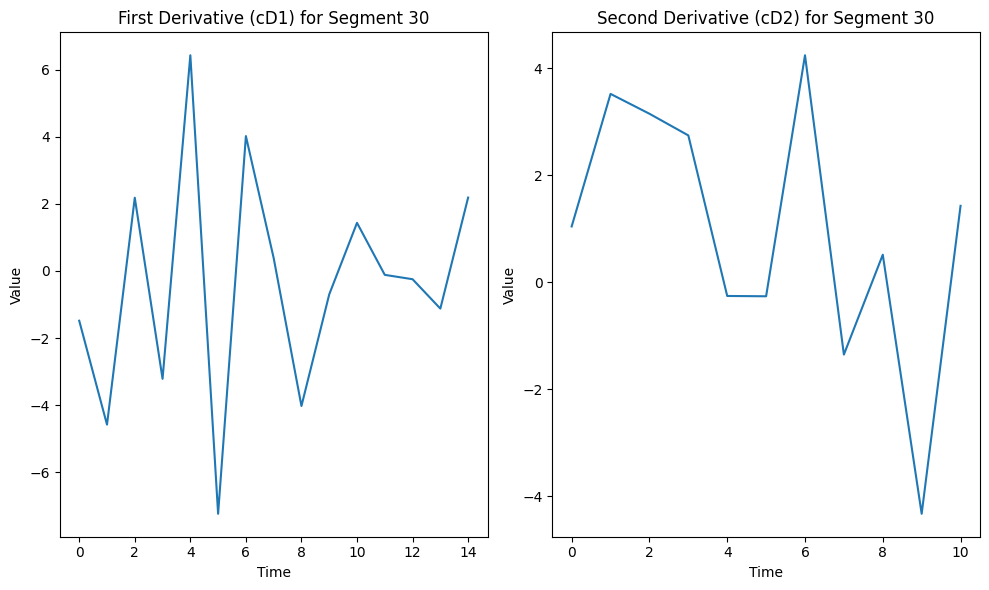

Segment 31:
  First derivative (cD1) length: 10, values: [-1.69171822 -5.1397697   4.03138602 -4.19925404 -2.58754977  1.3564932
 -1.93402918  0.62402652  1.14819536 -0.96306408]
  Second derivative (cD2) length: 8, values: [ 1.24319421  4.35029404  4.42717927  1.52458354 -0.92593671 -0.03155202
  0.49227019 -2.85654158]


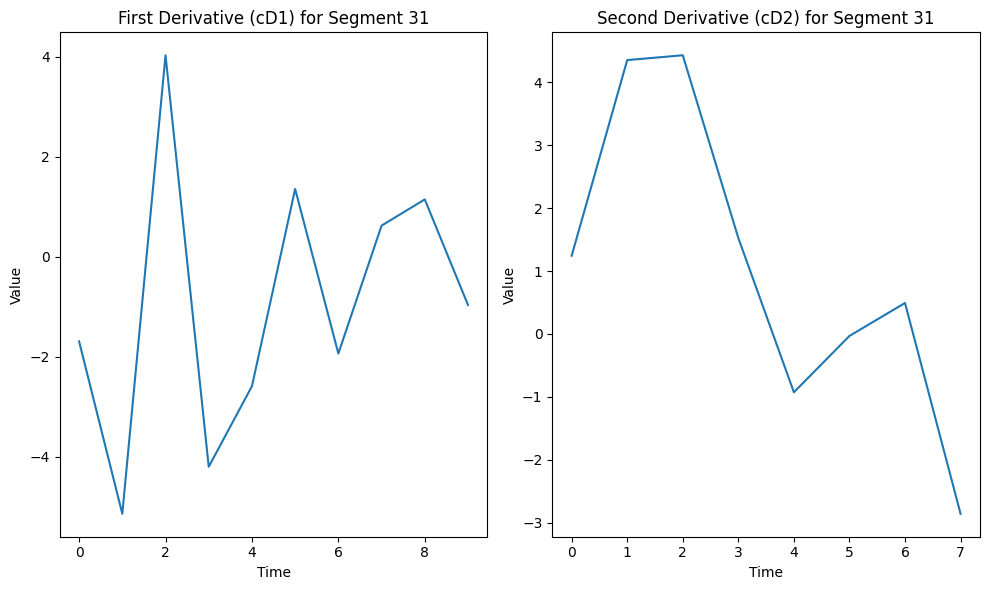

Segment 32:
  First derivative (cD1) length: 14, values: [-2.93219734 -9.12311192  3.793922   10.25433221 -8.22783911  3.25600247
 -9.78231938  6.72414534  0.47676762  4.58217174 -4.06172917  3.81096003
 -5.86288863 -1.18689767]
  Second derivative (cD2) length: 10, values: [  1.52084708   5.1273579   -2.19928994  -0.65919094 -10.1260925
  -0.24541364  -1.49725233   0.0690974    2.55210283   2.63522022]


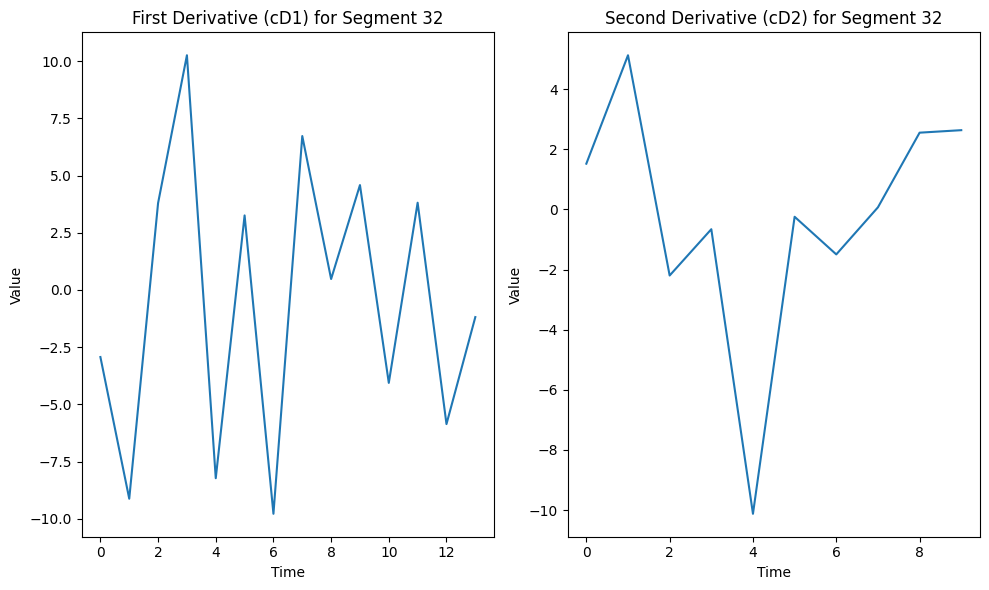

Segment 33:
  First derivative (cD1) length: 14, values: [ 0.52217218  1.21675104 -2.01061789 -4.2784973  11.52409229 -0.84876277
 -4.10838853 -8.56035056  8.93303905 -2.47373686  5.03866791 -6.5222648
  1.90214153 -5.92236033]
  Second derivative (cD2) length: 10, values: [ -3.36142107 -10.55972377   8.4853796   -7.8634776   15.8592888
 -13.91298419   4.82356173  -2.15801619   0.4993563    8.27369591]


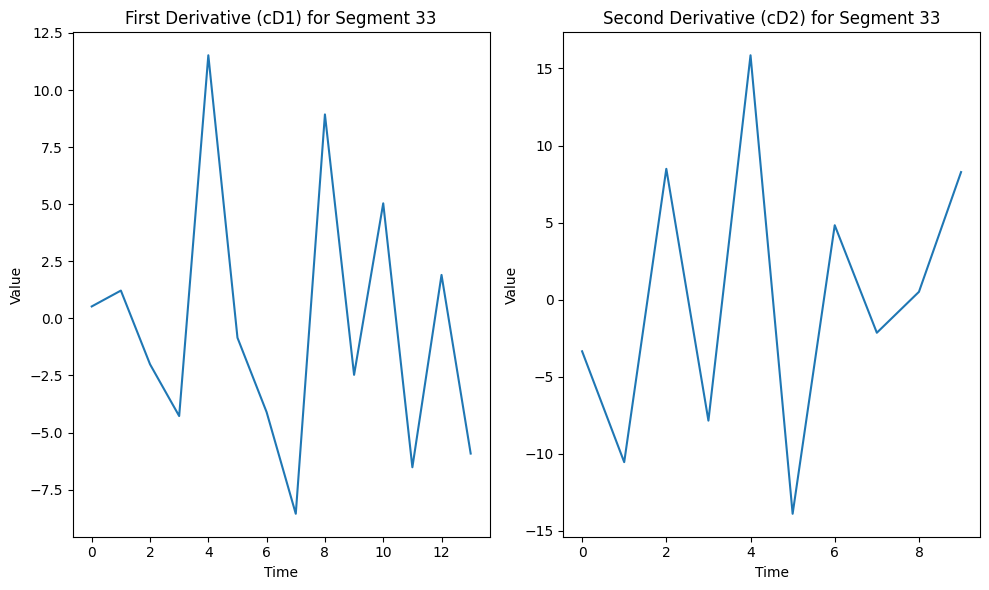

Segment 34:
  First derivative (cD1) length: 10, values: [ 1.60071321e+00  4.72287500e+00 -3.87563531e+00 -8.43726912e-03
  1.42650979e+00 -5.24362210e+00  1.02864550e+01 -2.62185017e+00
 -8.91481527e+00  8.78372949e+00]
  Second derivative (cD2) length: 8, values: [ -2.1117976   -6.94932595  -0.188479     8.50669724 -27.76716392
   9.91938012  20.30611195 -14.03913124]


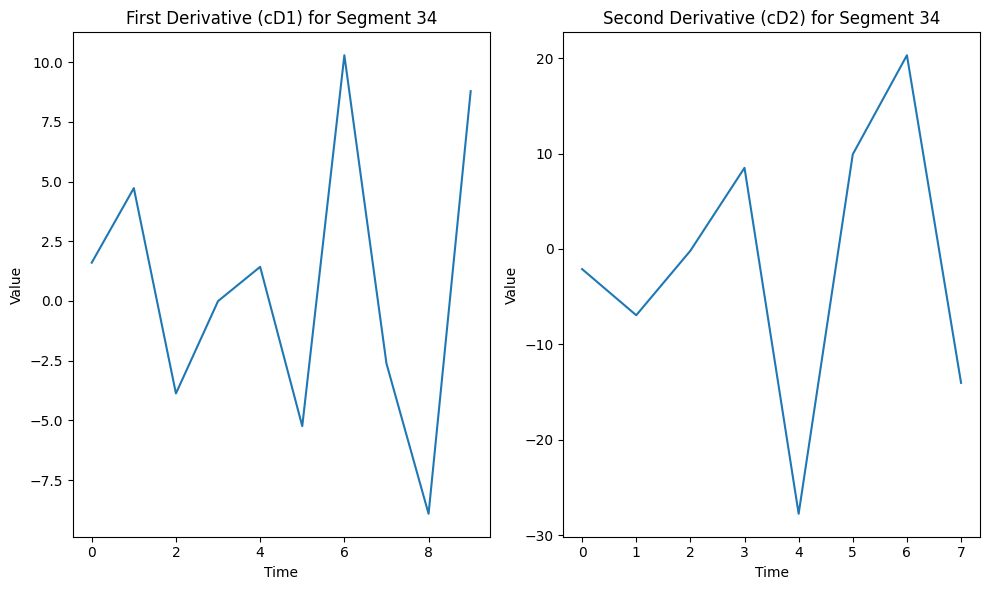

Segment 35:
  First derivative (cD1) length: 7, values: [-0.62672534 -1.64788882  1.96741084  2.86701832 -1.27544768 -3.32925586
  0.40094063]
  Second derivative (cD2) length: 7, values: [ 2.39191026  7.541136   -4.50757325  5.83371754 -6.75188466  4.27724895
 -8.78455485]


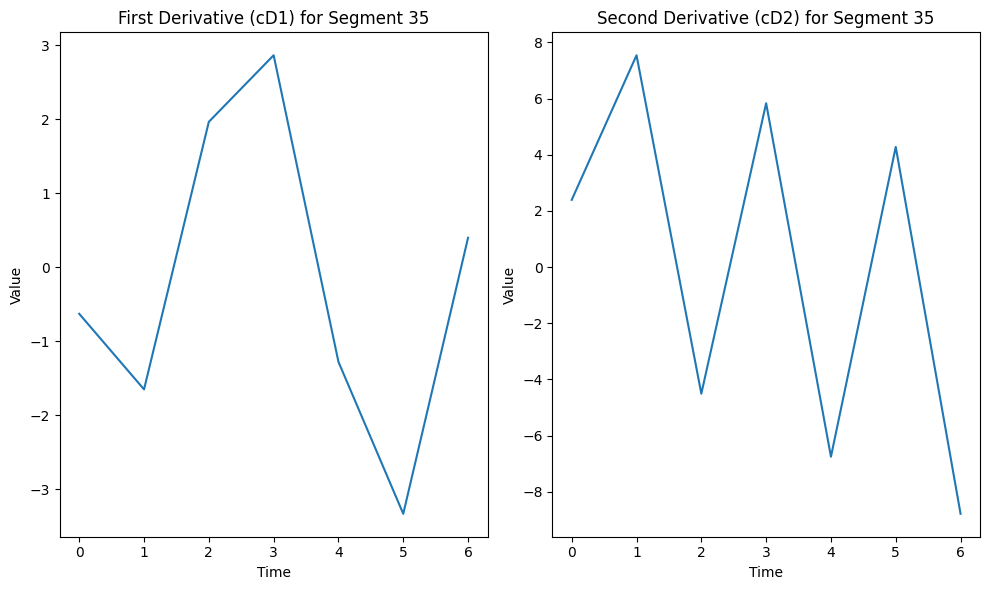

Segment 36:
  First derivative (cD1) length: 13, values: [ 0.16746166 -0.07831076 -6.29015447  4.92560244 -3.10404972  7.69927002
 -6.53826134  2.44227635 -2.5712714  -3.09545199  4.65763805  1.42539928
 -2.11575179]
  Second derivative (cD2) length: 10, values: [ -1.95944979  -6.54061531  -4.69329411  -2.17596009  29.18023836
  -4.74599047   0.73255016   0.76649189  -5.71589718 -26.71277897]


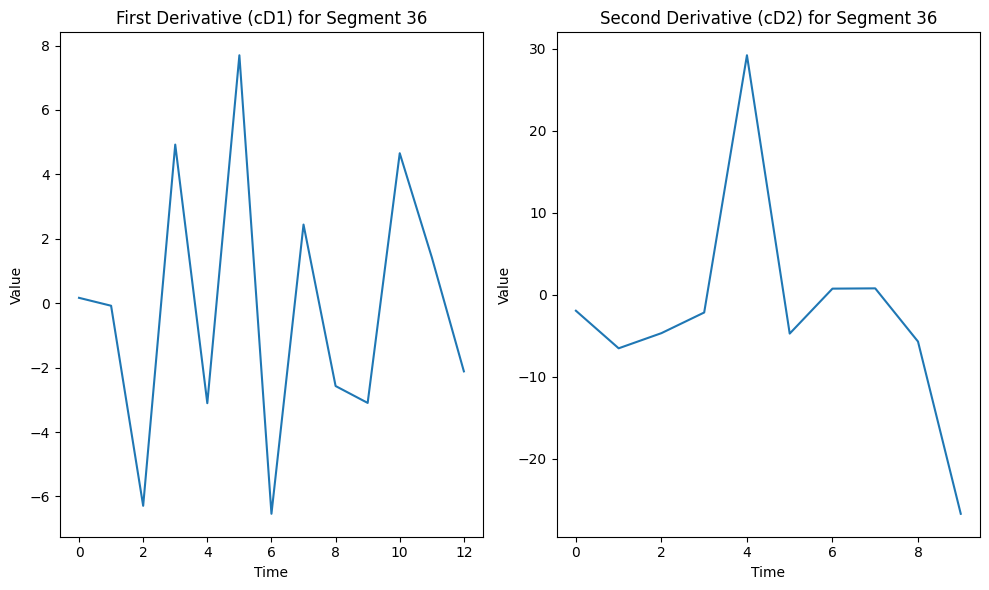

Segment 37:
  First derivative (cD1) length: 14, values: [ 1.52249219  4.88115781 -0.26461728  1.0538923  -2.39770147 -3.82356246
  7.02013429 -1.35320939  2.10307354 -4.37949557  1.28109593 -0.12632535
  3.6164035  -2.86532524]
  Second derivative (cD2) length: 10, values: [-0.5907595  -1.99742189 -0.75542085  2.19822369 -2.43266246  6.33182842
  1.20324472 -0.12133564 -4.41843404 -3.50627514]


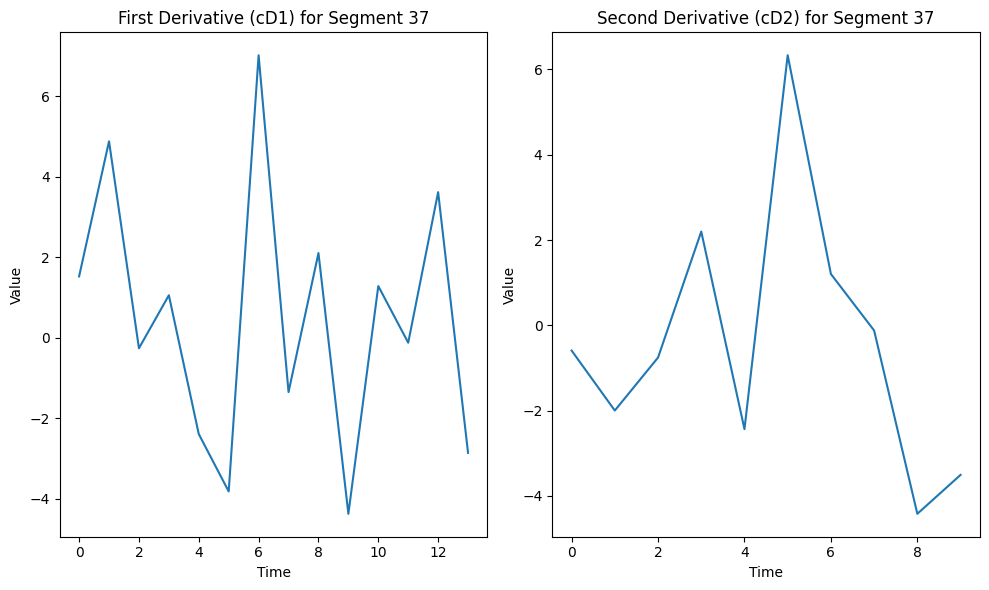

Segment 38:
  First derivative (cD1) length: 14, values: [-0.06795982 -0.69097045 -3.63090931  1.53732608 -0.87179057  2.34721319
  2.46718302 -5.20546485  4.78607624 -2.45023072  0.87725203 -0.3428445
  1.00892389 -3.37600217]
  Second derivative (cD2) length: 10, values: [-2.09552383 -6.72663595  0.49605113  0.39715573  9.76248173 -8.19640709
 -3.98039374  1.21711909  6.82112405  1.74601591]


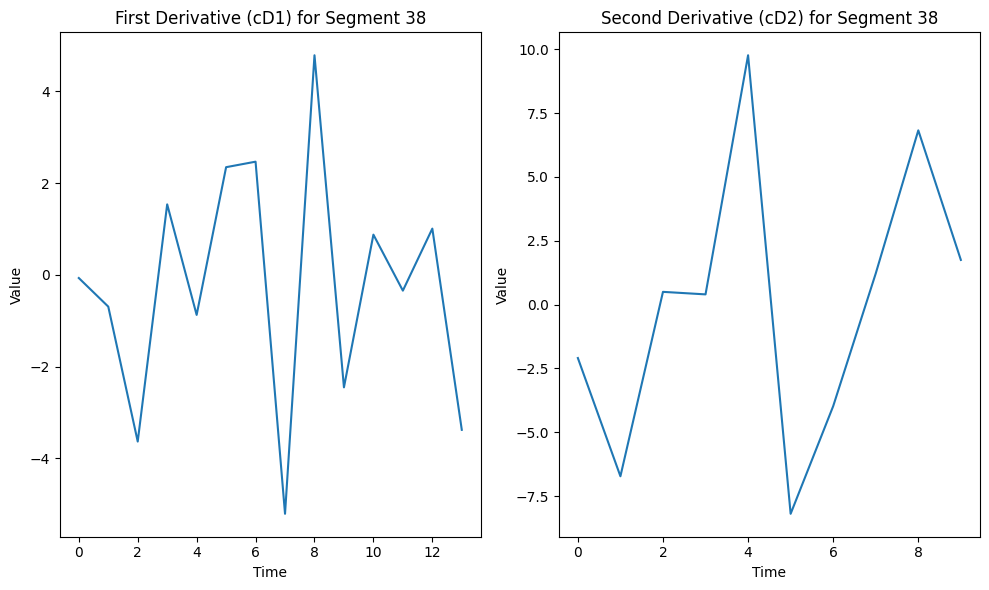

Segment 39:
  First derivative (cD1) length: 14, values: [ 1.85546182  4.75377595 -6.15319297  1.72851826  3.16924781 -2.50671504
  0.41212344  0.40857954  1.80578525 -3.28433591 -0.02153579  0.8259342
  2.15210978 -2.09819782]
  Second derivative (cD2) length: 10, values: [ -8.0752095  -25.57283453  11.28288512  -5.85197162  -0.46646688
   7.05801647   5.02522482  -2.3364994   -7.55765881  -4.05422491]


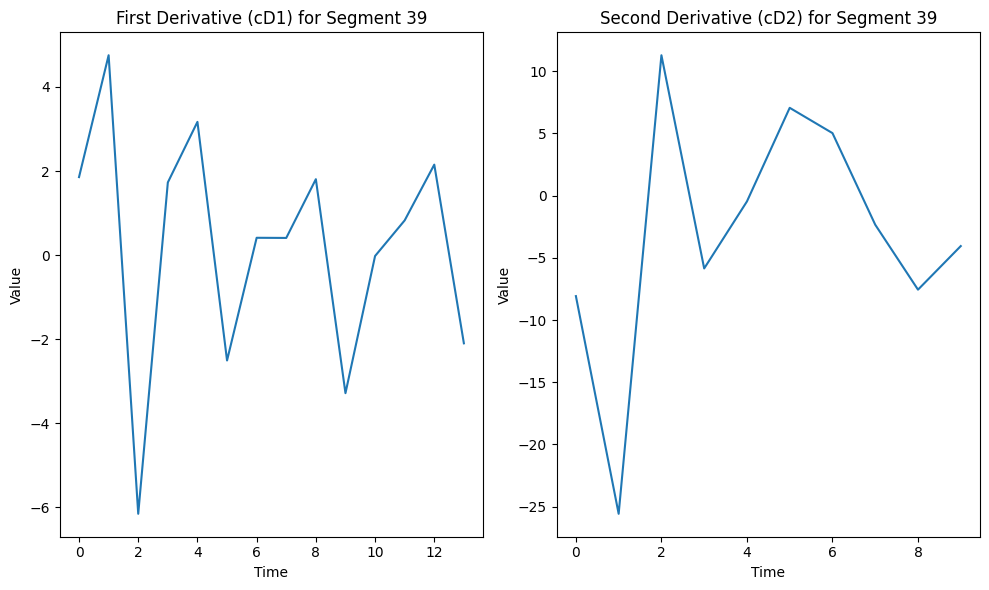

Segment 40:
  First derivative (cD1) length: 15, values: [ 0.3297428   1.09504491 -2.6725962   0.68597911  3.82787637 -1.77530095
  0.94826665 -7.00097442  8.01355576 -1.43988323 -3.00818998  0.84409577
 -0.29458238  0.29505388  3.39378588]
  Second derivative (cD2) length: 11, values: [ 1.64568377  4.83792289 -7.30326805 -1.5182685  10.81425389 -2.78939178
 -0.92932828  1.12613403 -0.88252976  1.76175534 -1.16232113]


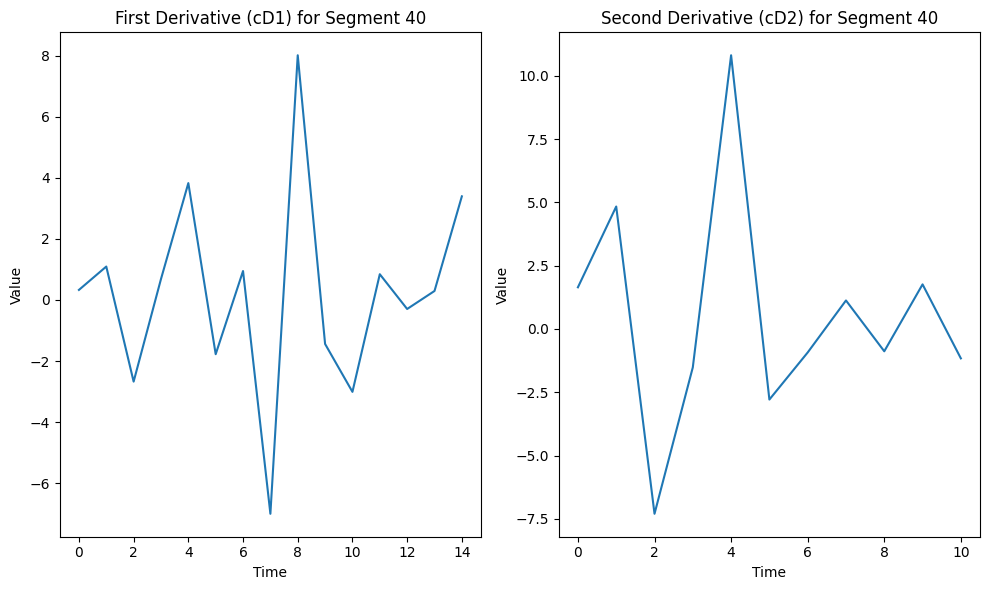

Segment 41:
  First derivative (cD1) length: 16, values: [ 1.70413243  5.08150606  1.59597247 -3.80712836  1.39308697  1.00456038
 -3.74598954  2.6966789   4.01938001 -5.06518753  1.355094   -3.79039598
  1.76332272 -0.82351641  3.40783868 -0.76470116]
  Second derivative (cD2) length: 11, values: [ -5.16664754 -15.95814557  14.89377027 -11.72169449  11.96521718
   0.47686343   2.85773845  -2.76585133   1.24126412   1.35174449
  -4.5791425 ]


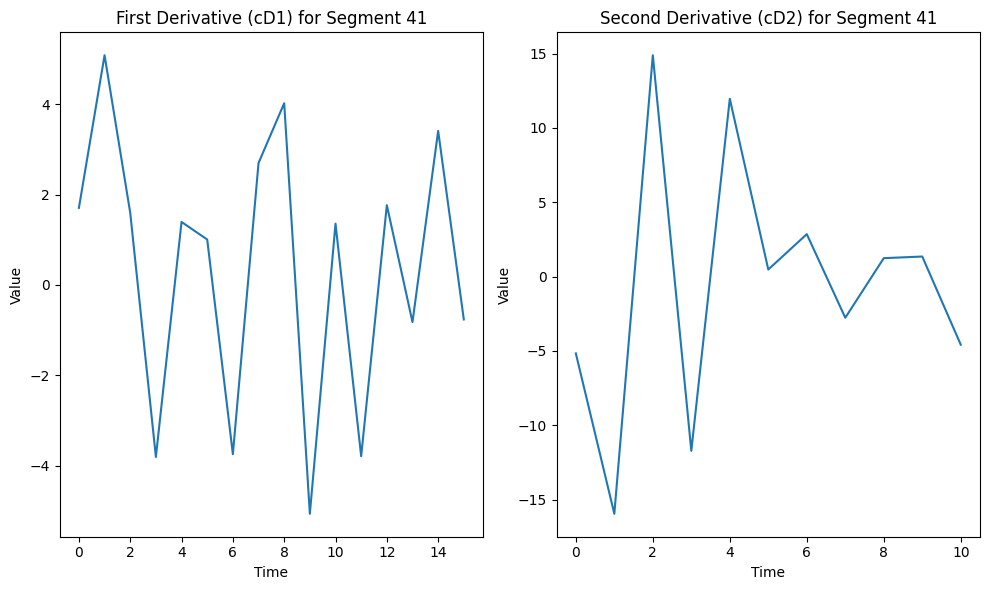

Segment 42:
  First derivative (cD1) length: 5, values: [-0.12051824 -0.38923329  0.12051824  0.38923329 -0.12051824]
  Second derivative (cD2) length: 6, values: [-0.05325247 -0.1357052   0.16933351 -0.17135716  0.19098132 -0.05325247]


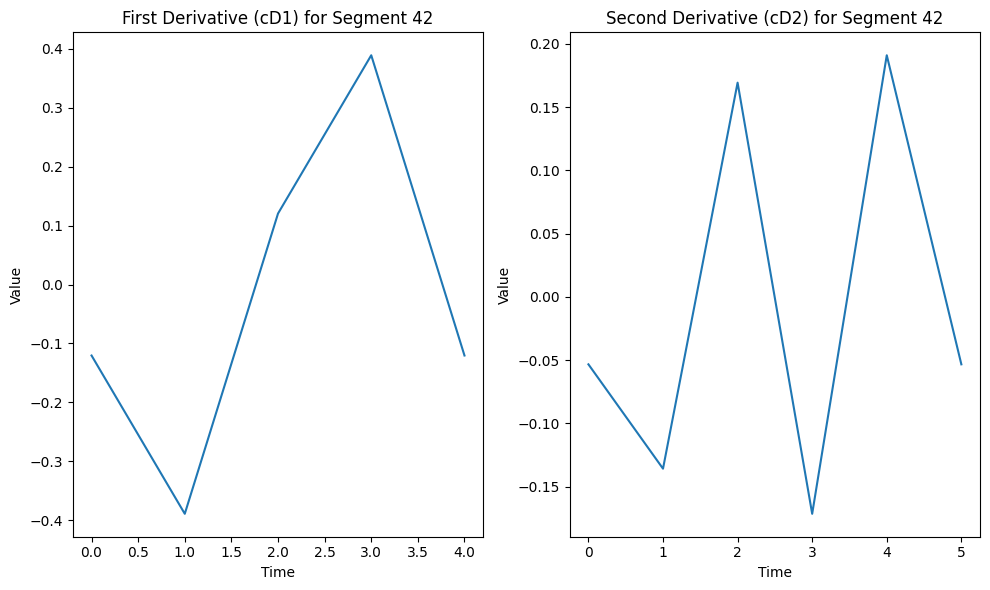

Segment 43:
  First derivative (cD1) length: 32, values: [ -2.332534    -6.64463113   6.16983782  -6.6104969    8.79117978
 -14.10011613  12.30614896  -5.0673452    4.99829191  -1.66550956
  -5.93438854  -1.67298937   7.52564003   0.36807044   0.60136376
  -3.31931694   3.42892869  -6.2221473   -1.37612806   7.77314898
  -0.70584385  -5.86616018   0.90625647   6.3391501   -1.40331494
  -4.56862195   1.12034837   0.55692438   0.80229267  -0.57824064
  -1.38071973   0.38560094]
  Second derivative (cD2) length: 19, values: [  4.99119058  16.08884714   0.15505516  -2.52885446  -1.1581364
 -14.33450312   8.43817991   1.62012477  -9.93465846  13.25364445
  -5.96407916   6.6780305  -10.07533194  -9.14000514  14.9965393
  -8.83118356   2.80595404   3.57167268 -13.67545471]


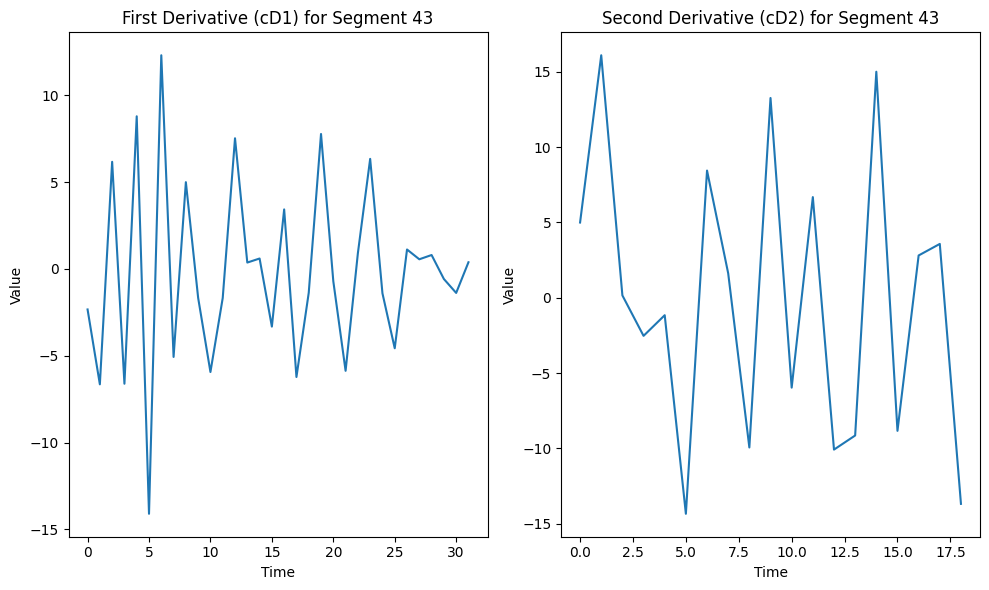

Segment 44:
  First derivative (cD1) length: 25, values: [-1.08254067 -3.33617681  5.48183987 -0.1397534  -5.52296341  9.56114499
 -8.33045708  1.10767473  2.23095996 -7.24805319 11.32143714 -6.63015979
  0.63868484 -2.13581069 -0.97122806  8.36534647 -4.65007103  0.30746796
 -4.45782945  6.142924    1.20932665 -5.05052239  6.75305259 -5.82907883
 -3.54782097]
  Second derivative (cD2) length: 16, values: [ -1.41129736  -3.84075573   9.99539393  -4.30524754  11.68887636
  -6.39232374   0.85872767  -3.47402813 -11.0215662   10.00029062
  -7.00999663  14.55934329  -4.65358875   1.49163658 -11.88783853
   5.63005422]


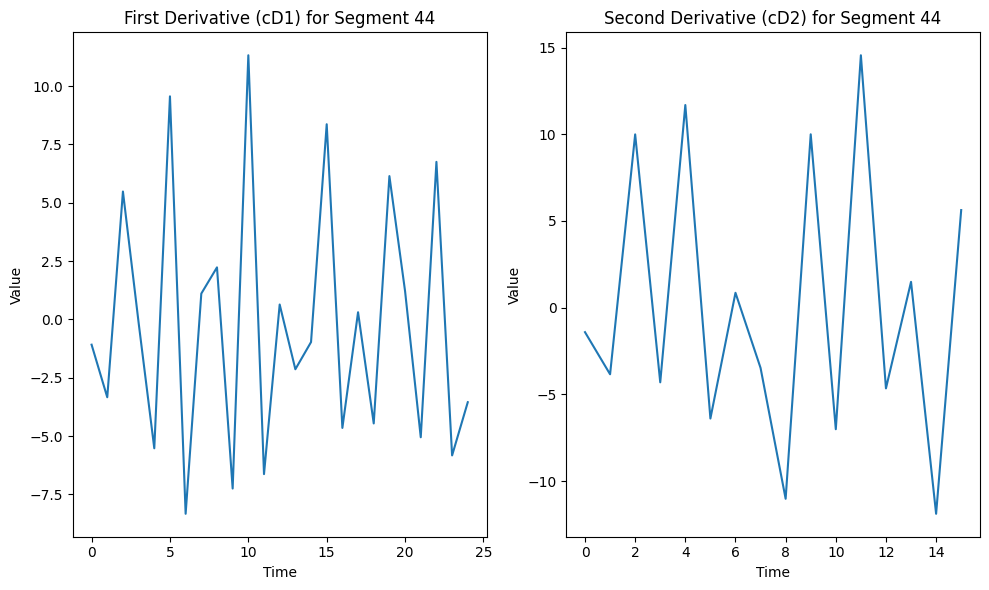

Segment 45:
  First derivative (cD1) length: 13, values: [-3.06515547 -9.8611993   2.78838648  1.77244535 -1.20785776  1.8690672
 -1.42925099  1.68377789 -3.06667328  1.65234609 -1.78725405  3.3558577
 -0.93049258]
  Second derivative (cD2) length: 10, values: [ -0.51861478  -1.13843314   6.12748775 -15.57548081  -1.82232145
  -8.16564746   2.55129679  -0.76777399   7.96821977   6.40000255]


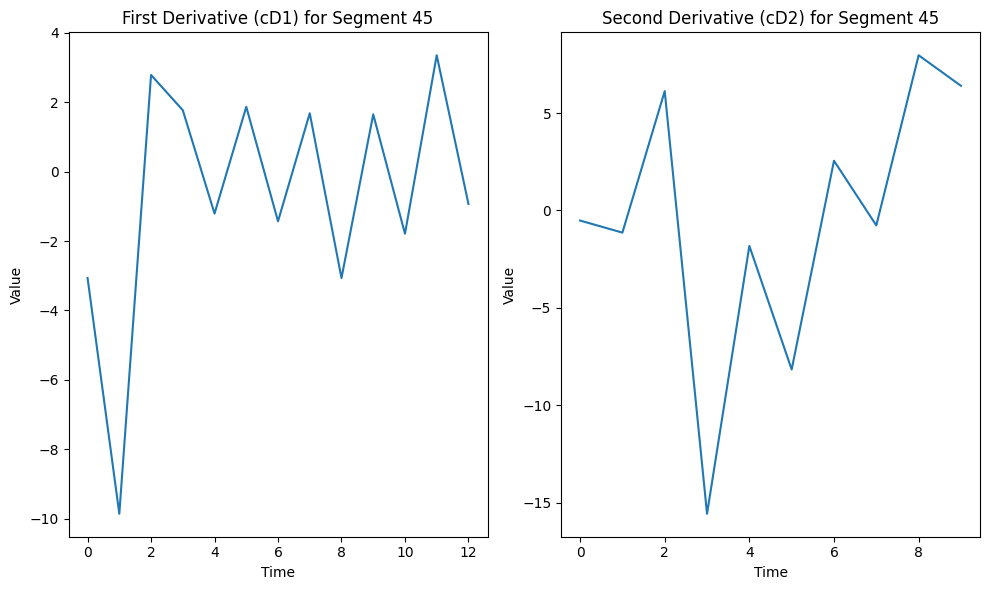

Segment 46:
  First derivative (cD1) length: 46, values: [ 0.42163189  1.02947036 -2.77877091  1.06611481 -2.32535492  6.31787754
 -0.20440684 -0.56685731 -9.40974508  7.76588165  0.46018766 -1.05541447
  3.27361405 -5.88791926  2.31871366 -0.45004648 -1.35794095  2.92165823
 -1.30951461  1.24572811  0.48529483 -3.22502366  0.99614154  2.4666083
  0.25017248 -0.79277513 -5.00456234  3.74128201  0.37840456  1.5374461
 -0.43174986 -6.72131358  8.80323538 -2.49911829 -2.2160689   3.32901319
 -4.50707206  1.75687989  0.80788638  0.94528823 -2.15467304  1.17730042
  3.78875023 -5.25905684  1.07876004  1.30712382]
  Second derivative (cD2) length: 26, values: [ -1.48205356  -4.80249605  -0.49846564  -3.0454904  -20.41052565
   5.376213    14.10049954   3.43404121  -0.6293215   -4.91507342
   8.43515215  -0.16689308  -2.32030483  -4.86882712   1.01073587
   7.4934556    5.43284242  -1.61443933 -25.66349531  20.14174869
  -1.65758889  -1.04025769  -4.61188042   1.28407065   4.35695017
  -2.981

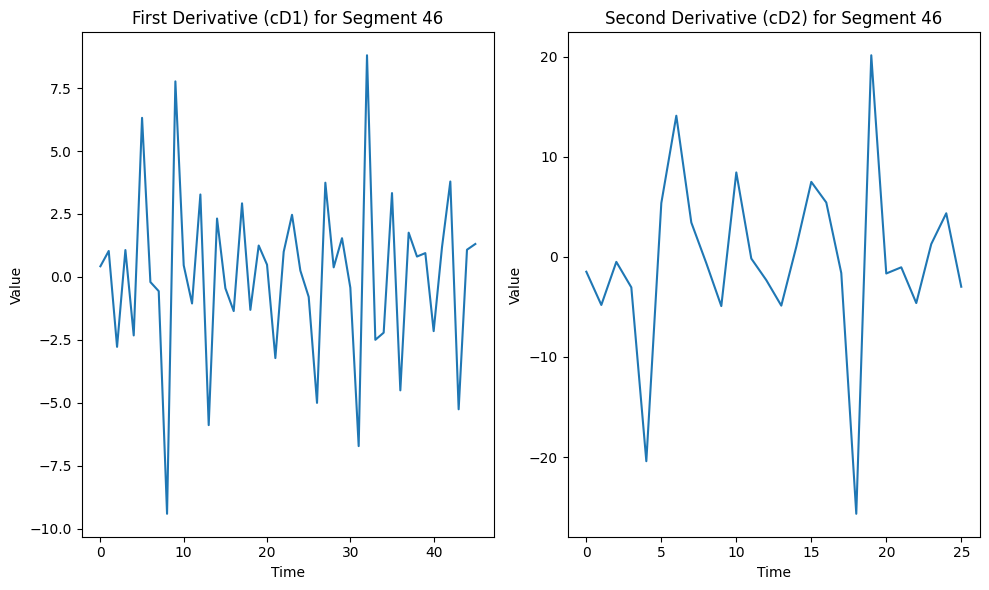

Segment 47:
  First derivative (cD1) length: 64, values: [  0.52800943   1.97241078  -1.06429188  -0.11412341  -2.12123534
   1.93426653   0.08456137   2.71465682  -2.93997734   0.83650894
  -0.03247798  -1.16838495   1.76548253  -3.10253307   0.99719243
   0.35729814   1.22526456   0.69946717   1.5131049   -7.83246189
   7.64667393   1.03508043  -5.10805343  -1.06186096   2.11940018
   3.11293325  -3.92108258   2.31046819  -2.28982308  -0.85600302
   3.75567756  -0.40219155   0.04409283  -0.76239596  -1.46842015
  -0.38103356   1.88190967  -2.17735534   0.78470748   0.03782011
   4.84879808  -5.30794169   0.28428653   1.61568868   2.30144691
  -3.0524625   -2.63411233  -0.36290827   4.18975484   2.93625025
  -2.76769935  -0.59346057  -7.21477095   5.283567     7.65035794
  -6.57631067  -0.33289397   0.34405952  -4.25003475   2.06175874
   8.32884871 -11.30093256   2.63684623   3.06500906]
  Second derivative (cD2) length: 35, values: [  2.90823772   8.8710396   -9.04828068   0.8182109

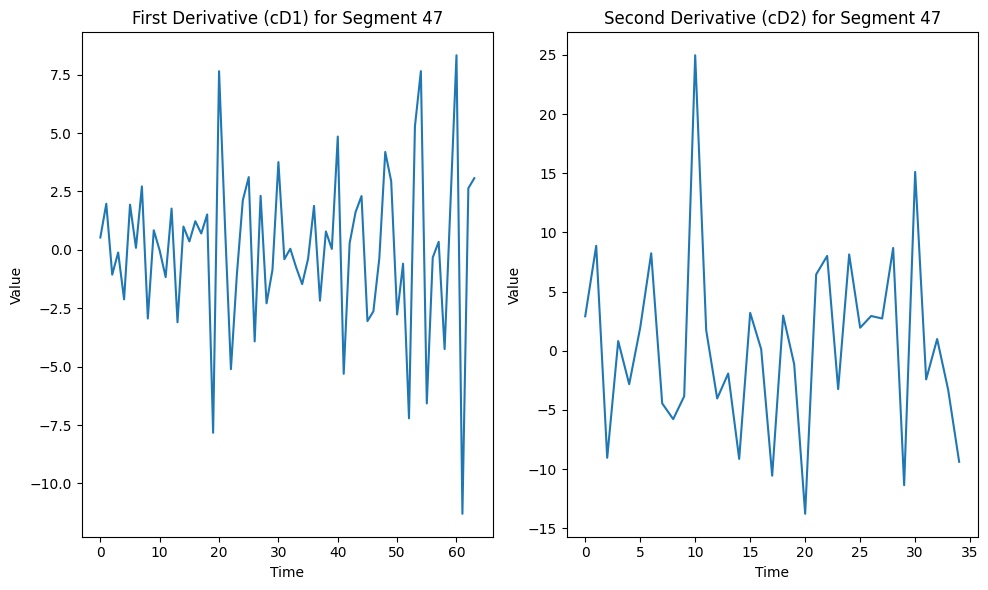

Segment 48:
  First derivative (cD1) length: 24, values: [ -0.36980533  -2.0752833   -5.94067709   9.33350941  -1.39927528
   1.70945058  -3.80765552  -2.25104674   5.39104442  -4.35006247
   2.54790425   0.73830472   2.28479352 -10.22589447   3.33353819
   6.25862214  -1.33384981  -1.1261679   -2.7582833    0.48585733
   4.06697196  -5.47478649   2.11197767   2.12497237]
  Second derivative (cD2) length: 15, values: [ -4.5353932  -14.49972267   0.90424962   0.20434303   4.89711493
  -0.53708846   2.51051544   6.4382182   -9.72167114  -3.78640339
   2.94209495  -3.12823725   0.64150191   2.17288145  -1.51287486]


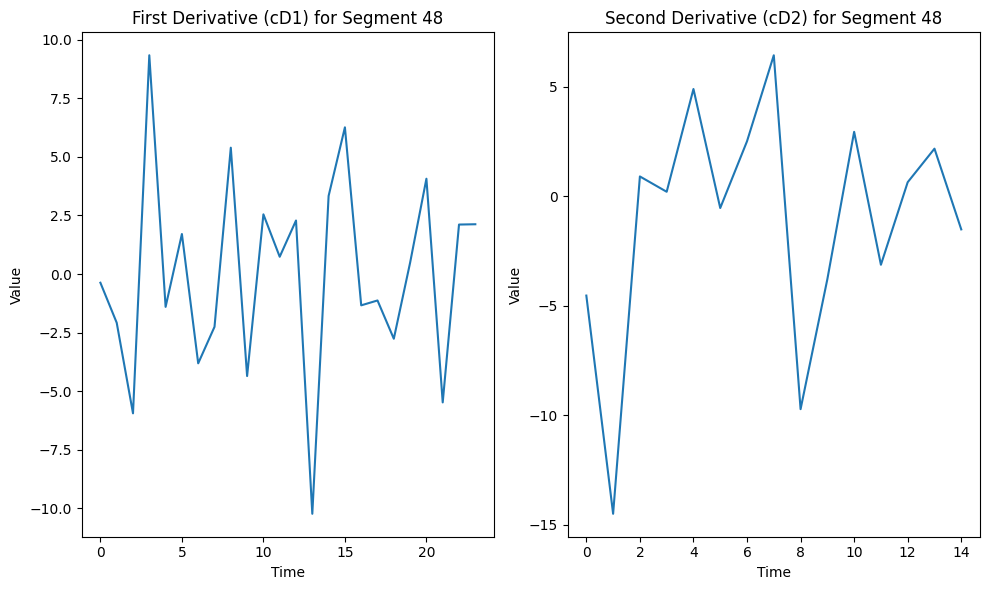

Segment 49:
  First derivative (cD1) length: 15, values: [-3.0357846  -9.79098392  2.35905867 -1.85142463  4.38339412  2.38747282
 -3.68574742  1.28586512  5.19765947 -7.05317416 -4.70472021  2.51984666
 -1.67490611  7.52771489  3.22383739]
  Second derivative (cD2) length: 11, values: [-0.56604309 -1.29073147  7.73583753 -5.514186    2.29197834 -4.44716172
 -4.32370662  2.77067444 -1.50562384  4.9889225   2.18346155]


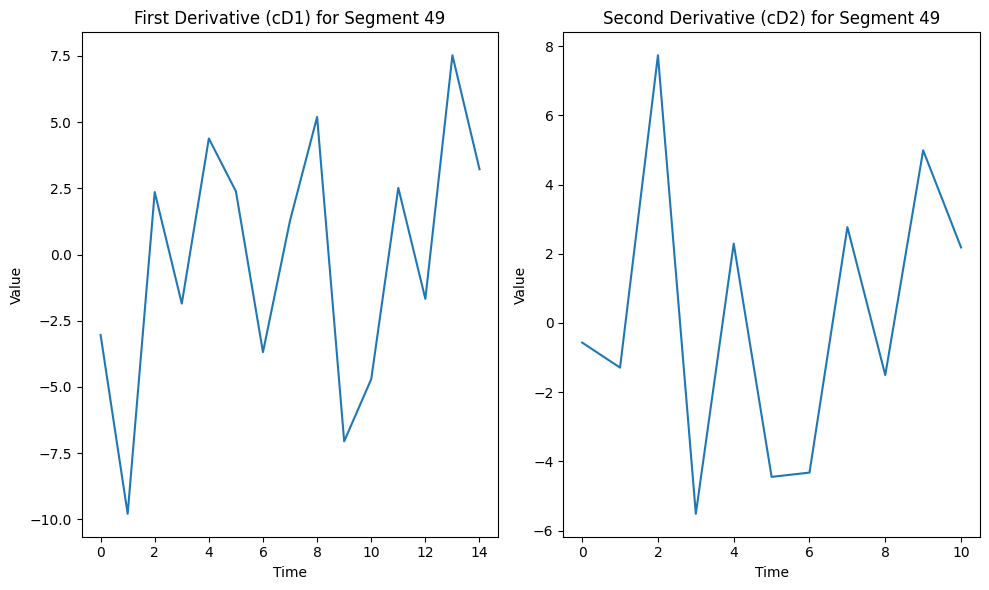

Segment 50:
  First derivative (cD1) length: 30, values: [ -0.17778984  -0.32127212   0.95227452   5.80070893  -1.87514249
   1.00509827  -6.91287203   9.80905531  -5.31690042  -4.20576149
  -0.92306538   7.04181959   2.52037975  -8.36969311   8.57305145
  -4.77975982  -4.0913633    4.12346313   1.43031842  -1.42958034
  -2.55100075   9.73706254 -11.22644765   0.56840387   4.94804522
  -1.10607686   3.53902466  -3.76165539  -0.05103278  -4.89091702]
  Second derivative (cD2) length: 18, values: [  1.60773469   4.97297864  -5.4613123   17.12917083 -24.40506412
  19.81412387 -17.24076312  10.12147737 -20.89589238  18.2837931
 -16.18284901   5.22951274   5.44547963  11.55133867  -7.64381743
   2.39701003   3.43725515 -14.64388774]


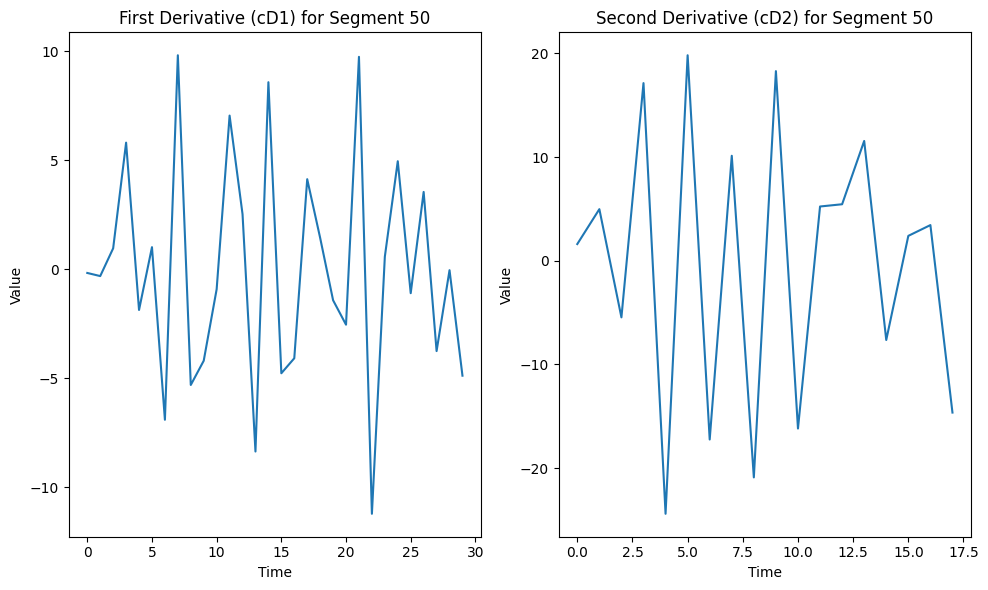

Segment 51:
  First derivative (cD1) length: 29, values: [-0.02094433 -1.10044969 -8.05884632  7.31251402  3.02452947 -5.29857584
  3.63280846  0.63666421 -3.85267224  0.64134077  0.56211907 -4.49340964
  1.7161932  10.25251167 -9.60111761  0.67874515  3.83629767 -1.93237747
 -0.31069679 -3.41859358  5.61711452 -5.20161085  4.47545427 -0.33528496
 -2.18981246  1.225707   -0.49138971  1.9664732  -2.01584625]
  Second derivative (cD2) length: 18, values: [ -4.70041    -15.18628535   0.02575582   5.41428909  -2.73693298
   4.81652577   0.31141373 -14.21399286  18.5860666  -10.39985873
 -12.0281577   20.34101508  -4.59645588  -7.5688064    3.11705992
  -1.80817947  10.07703166  -5.34307374]


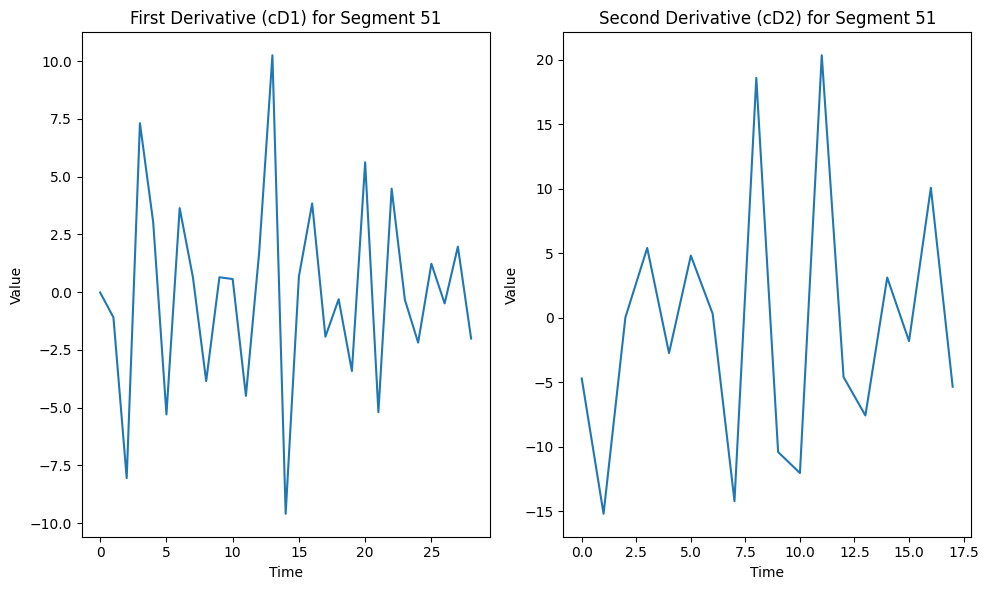

Segment 52:
  First derivative (cD1) length: 53, values: [ -0.31479878  -1.95318422  -5.26216253   6.86137546   0.16650622
  -3.23924844  -1.20560857   7.73927768  -5.70724168  -1.10137665
   3.71244242  -1.80911898  -4.57214588   4.24423714   6.27568339
  -4.99843965 -10.70581488  11.47565735   5.84441746  -7.79765301
   1.87008506  -6.76841509   2.80162369   5.74068725  -7.48542243
   6.42713139   1.50511198  -5.98544231  -4.15666486   6.24854494
   3.83312616  -1.54220378  -0.95092972  -7.58978268   7.69862501
 -10.94235255  16.89348519  -3.44190347   1.20113074  -5.23939645
  -3.42697112   0.9124819    0.58089784  -3.84881061   5.17512116
   3.56982107   9.57106041 -18.28529012   0.47304876   0.80024951
  -0.81026633   5.36670607  13.45105275]
  Second derivative (cD2) length: 30, values: [ -5.32636201 -16.87789049   4.87030748   2.87536229 -16.80569643
  13.05644745 -12.56004949   0.64531358  -0.86777247   6.45289667
  11.94542787 -13.48040943   6.01844446  -4.80654607 -17.1056291

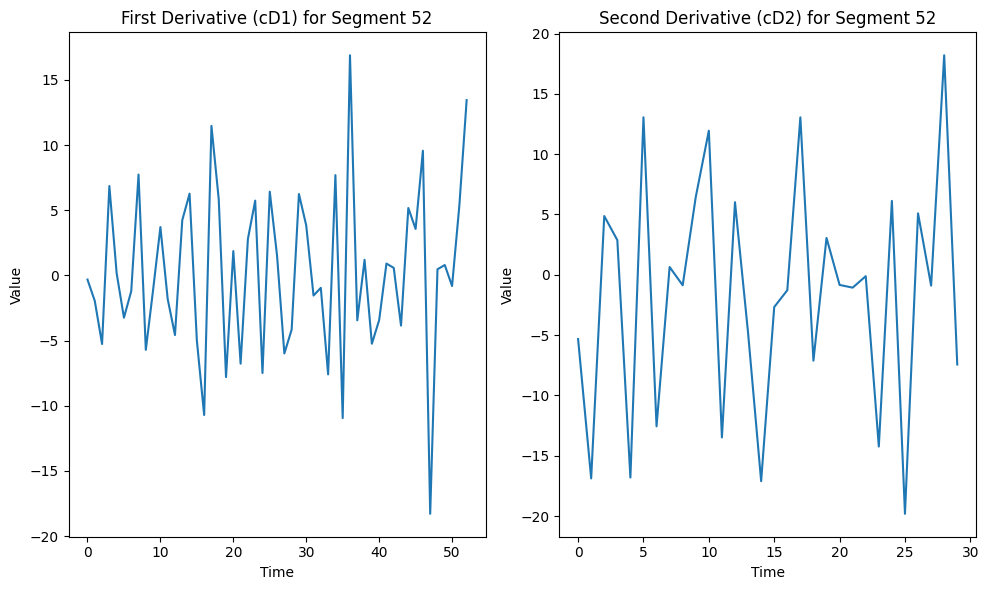

Segment 53:
  First derivative (cD1) length: 70, values: [ -1.17652843  -2.89923278   5.26505646  -1.74346081   1.85331745
  -1.13937371  -1.38096686  -3.20225667   7.689356    -2.52935763
  -2.94632276   1.36902218   0.80624473  -0.06260155   0.9998967
   0.09965282  -1.22305371  -4.48948432   7.88359109  -4.313564
  -1.31924329   8.26190022 -13.65209983   4.22802157  11.79088824
  -7.94108522  -3.68075719   2.79132271   2.40232069  -1.08233831
  -1.38415751  -1.4615694    1.94107423   0.36470769  -1.71129095
   0.96112878   5.11501749  -6.76314512  -2.01214184   3.79634896
   3.43413508  -3.48179842  -2.41719858   5.82042787  -4.30957741
  -1.51118153   4.4490474   -2.28478626   3.41881873  -8.60193605
  11.47669649  -2.49007669  -4.78954539  -7.97245583  13.2057934
  -0.36106766  -1.74673637  -1.57250033  -3.52926896   0.04766185
   3.37570048   2.27671098   1.35497556  -0.67211304 -14.83851767
  18.11890339  -5.8440423    1.54963575 -13.27990503  19.5119595 ]
  Second derivative (c

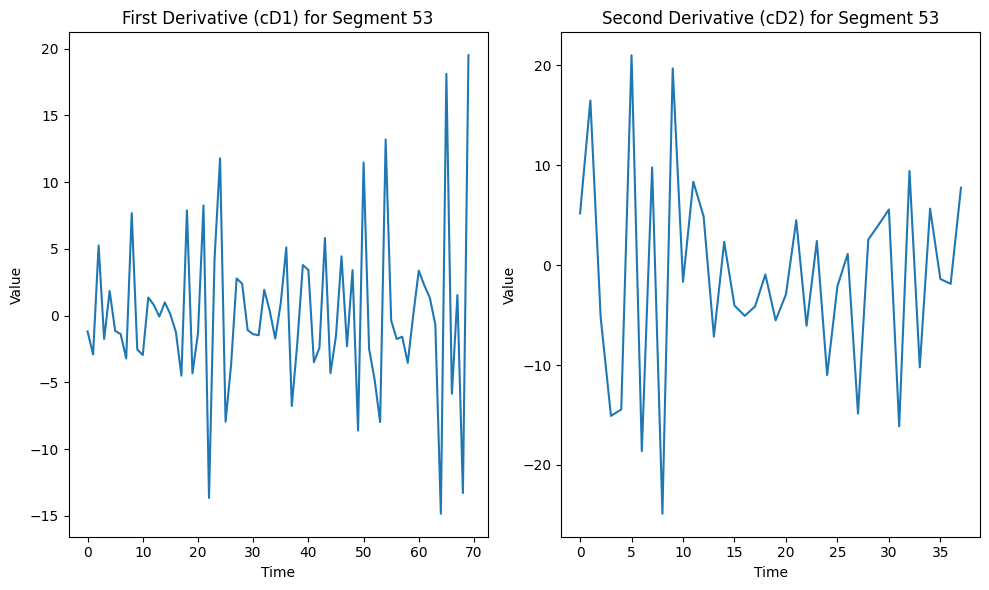

Segment 54:
  First derivative (cD1) length: 18, values: [-0.20442979 -1.16939737 -1.46783103  6.3959627  -5.81569952  2.10435152
  3.019982   -3.54711102 -2.82921394  4.76051178 -2.74181935  3.6168928
 -0.63387369 -2.33551182 -1.6740213   2.90499457  1.4994794  -0.78963964]
  Second derivative (cD2) length: 12, values: [ -3.64807342 -11.40605918   4.4160411   18.01917893   1.67140126
  -5.79952084  -6.01354149   8.42965161   5.50669154  -1.72637571
  -8.57204865  -2.7168625 ]


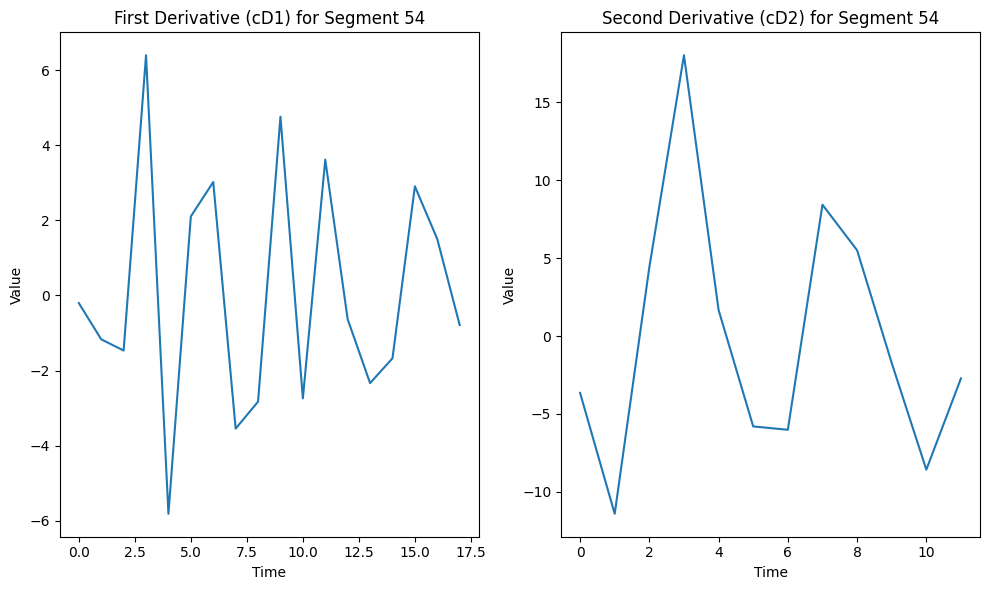

Segment 55:
  First derivative (cD1) length: 195, values: [-1.74775285e+00 -4.86675833e+00  2.44043701e+00 -9.00213951e+00
  1.21467118e+01 -5.74287220e-01 -8.97465206e+00  5.93306652e+00
 -6.68697326e+00  1.28572882e+01 -1.37918644e+01  1.02405806e+01
 -5.91836348e+00  5.09870581e+00 -5.02968509e+00  3.51564268e+00
 -2.16772829e+00  6.64556057e-01  2.45469313e-01 -2.94665187e+00
  2.14973672e+00  4.53717533e+00 -6.01111599e+00  2.33267103e+00
  3.73051755e-01 -4.93573669e-01  3.85511766e-01 -2.02633160e+00
 -8.18462048e-01  3.19803557e+00 -2.18421439e+00  4.05988194e+00
 -5.40317089e+00  4.58956095e+00  4.06252723e+00 -9.84657298e+00
 -1.10935542e+00  6.47923144e+00 -6.49605433e+00  1.42959797e+01
 -1.33379602e+01  2.14828557e-01  5.20338844e+00  2.96201380e+00
 -2.54024146e+00 -8.50865936e+00  9.22144709e+00 -4.55626644e+00
  3.16721430e+00  1.92927872e-02 -3.36016050e-01 -1.50317623e+00
 -8.56393009e-02 -2.12300949e+00  4.43038565e+00 -2.44942769e-01
 -1.40460542e+00 -1.27633033e+00

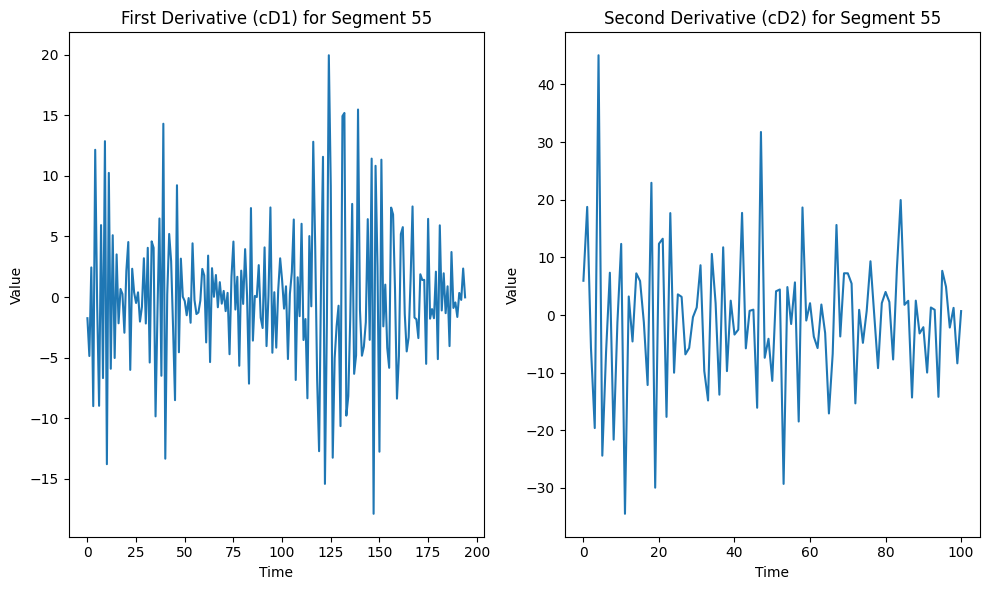

Segment 56:
  First derivative (cD1) length: 28, values: [ 0.79762587  2.25675323 -2.39453723  4.04327366 -4.60601456  1.98363549
 -2.02586332  1.18864405 -5.02100513  8.70206259 -2.07308005  0.72755223
 -0.77859112 -2.25492557 -0.38761626 -1.59012768  5.79851959 -4.6271867
  1.49257995  2.54688134  1.25627847 -7.71876836  3.54635728 -0.85679054
  2.32911056 -0.84124331 -1.85515768  0.66485316]
  Second derivative (cD2) length: 17, values: [-1.669163   -5.42691986 -1.31597716 -1.85047574 -6.24123176  2.37235128
 -2.48493048 -3.64915425 -6.28267712  0.64935041  0.16378427  0.8450364
 -3.92811322  1.57110469  0.11707613 -0.54296314  3.44127902]


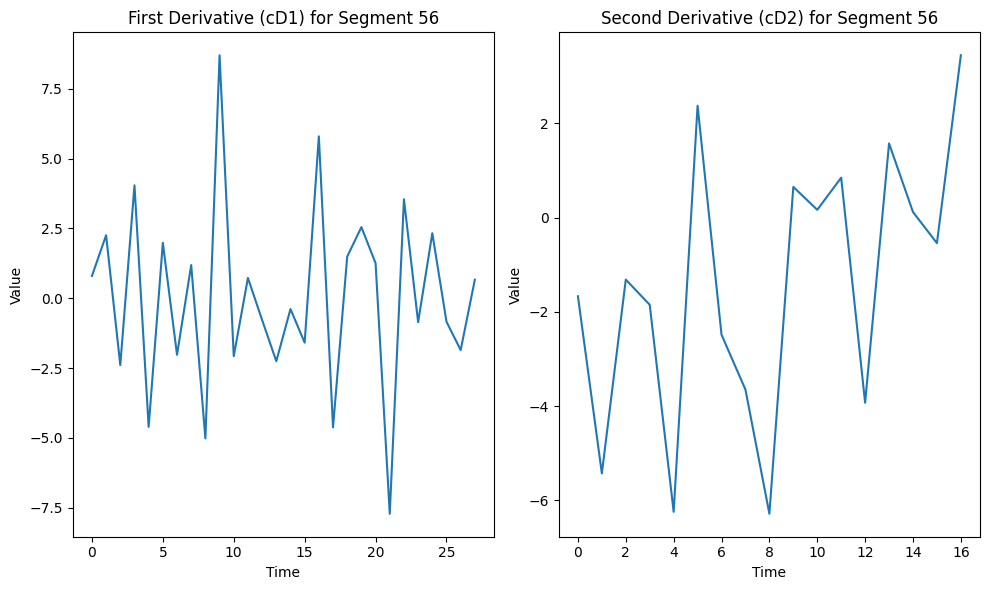

Segment 57:
  First derivative (cD1) length: 25, values: [ 2.06071599  6.10573821 -4.30435683 -0.84490941  1.51928336  0.3010363
  0.56210947  0.64002276 -5.42417727  3.16316862  0.30260126  3.1603742
 -1.84411379 -0.92875223 -1.4774202   2.58484406 -2.00342454 -1.71422164
  0.89878874  5.97288561 -3.70404029 -0.26919948  1.71788027  1.13020359
 -6.86751415]
  Second derivative (cD2) length: 16, values: [-2.88394103 -9.38641608  1.16684901 11.63654814 -2.08901626  0.86945983
  8.02587245 -7.61658143 -3.66435704 10.24837325 -3.51039619  4.29998864
 -0.64011137 -0.18430922 -3.60959411  0.78310927]


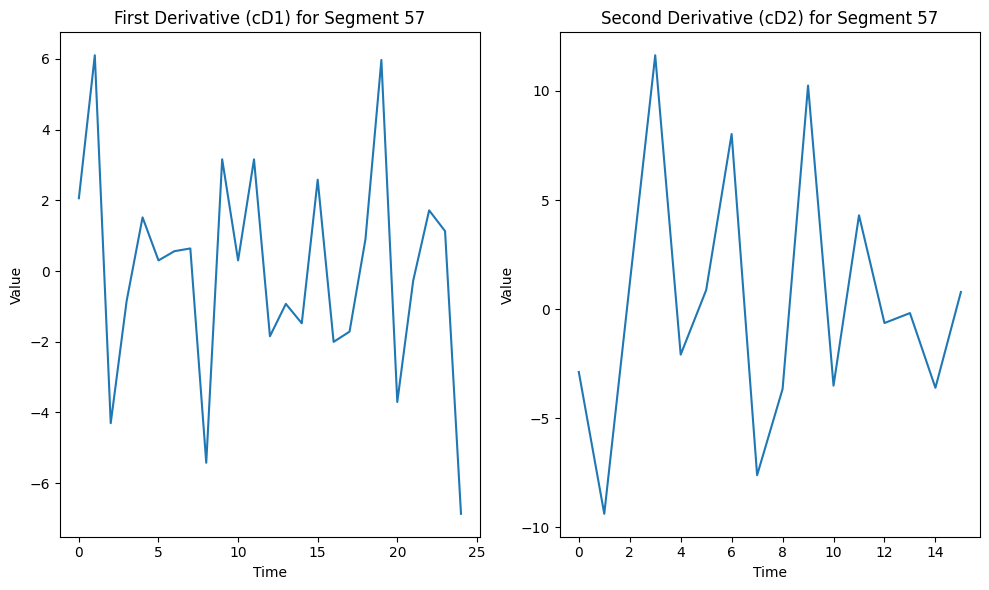

Segment 58:
  First derivative (cD1) length: 25, values: [-1.20432264 -3.40114065  2.27492059 -1.30408016 -0.36557487  3.15280983
 -2.06225231 -1.5361211   2.67405692 -2.36455002  0.28412178  3.28175622
 -3.65037783  0.16215096  0.91276391  0.39539309  0.52703546 -0.34035159
  0.63471507 -3.33313691  1.45547633  1.97491414 -0.25429673 -2.38333245
  0.38792011]
  Second derivative (cD2) length: 16, values: [ 3.38961076 10.76057923 -4.4114992   0.98499287 -1.7897171   4.39539361
 -6.345962    7.73751429  5.07850166  7.6661464  -5.66483722 -1.02476672
  7.89800217 -9.0768075   5.61641984  0.44565839]


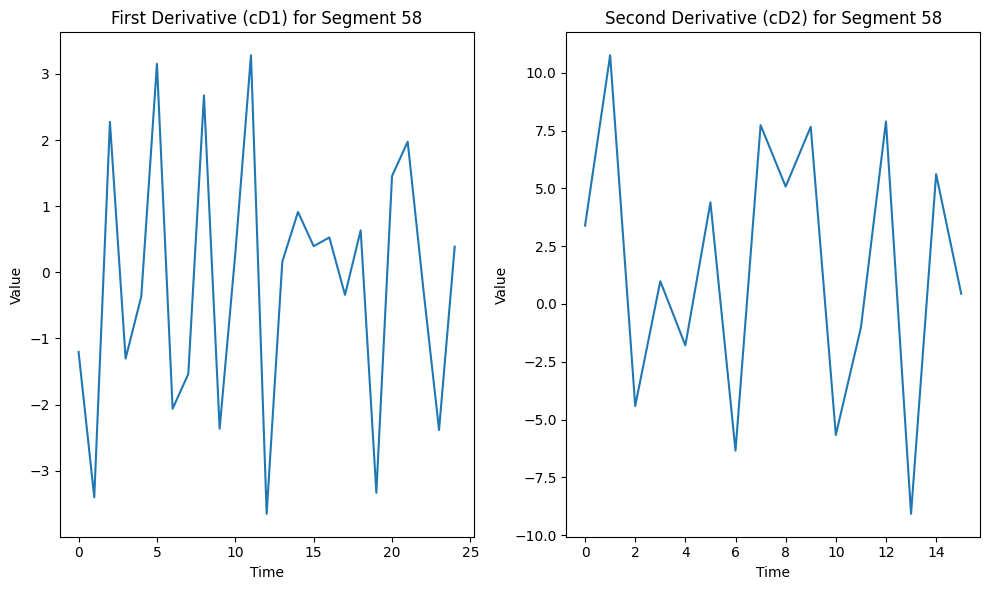

Segment 59:
  First derivative (cD1) length: 25, values: [-1.99839426 -5.7492466   5.64811645 -6.2456156   6.56148529 -5.91724982
  4.36657177 -1.43644145 -2.01011756  4.93310865 -7.44178479  4.94163718
  0.81507483 -2.82495666  1.41482311  1.76871272 -2.02572387  1.76757728
  0.07919943 -3.65233759  0.2087027   0.12665368 -0.07464656  0.99478239
  3.15491233]
  Second derivative (cD2) length: 16, values: [  3.60749002  11.76645296   2.30369963   7.95156781  -4.6403388
 -13.77660887   3.71665985  19.44306791  -8.95529667  -0.1107249
   9.8057945  -19.55497516   6.43838417  -2.3740994   17.5762245
 -15.61633308]


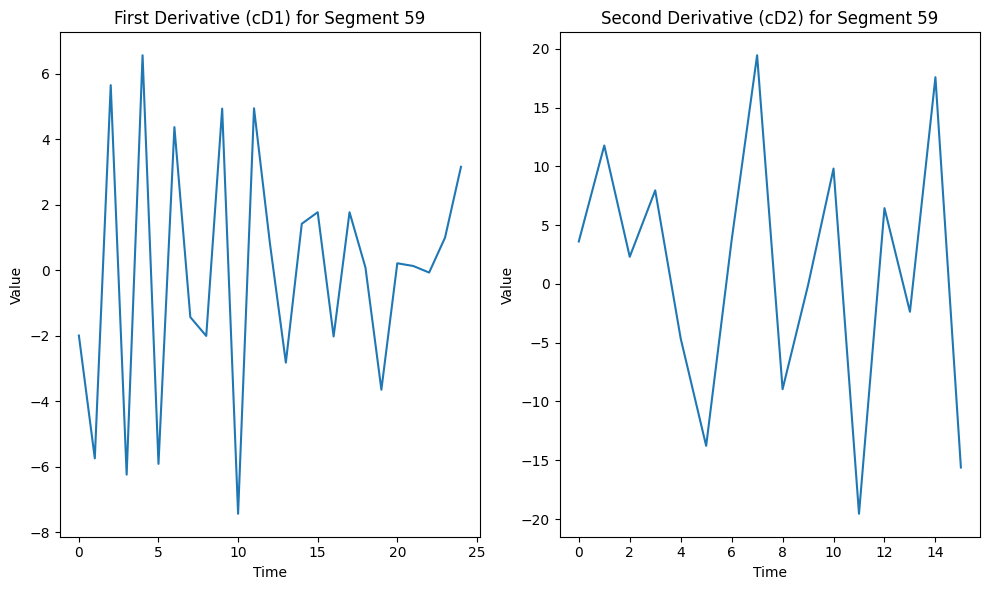

Segment 60:
  First derivative (cD1) length: 21, values: [-0.88518618 -2.82372885  2.8715719   2.24626516 -3.22360278 -3.89166396
  3.46901166  2.29929804 -0.09521594 -1.80277021 -4.23239869 -5.05775438
 15.16501009 -4.79779647 -0.47252323 -1.09239569  1.96107963  2.42607903
 -0.41528444 -3.89245871  0.2345815 ]
  Second derivative (cD2) length: 14, values: [ -1.03899412  -2.94928694   5.39305234  12.0351184    2.40644963
   4.29442024  15.44916287   0.71674999  -8.89447581  15.19960375
   0.43248262  -5.07970134 -12.35339125  14.07000191]


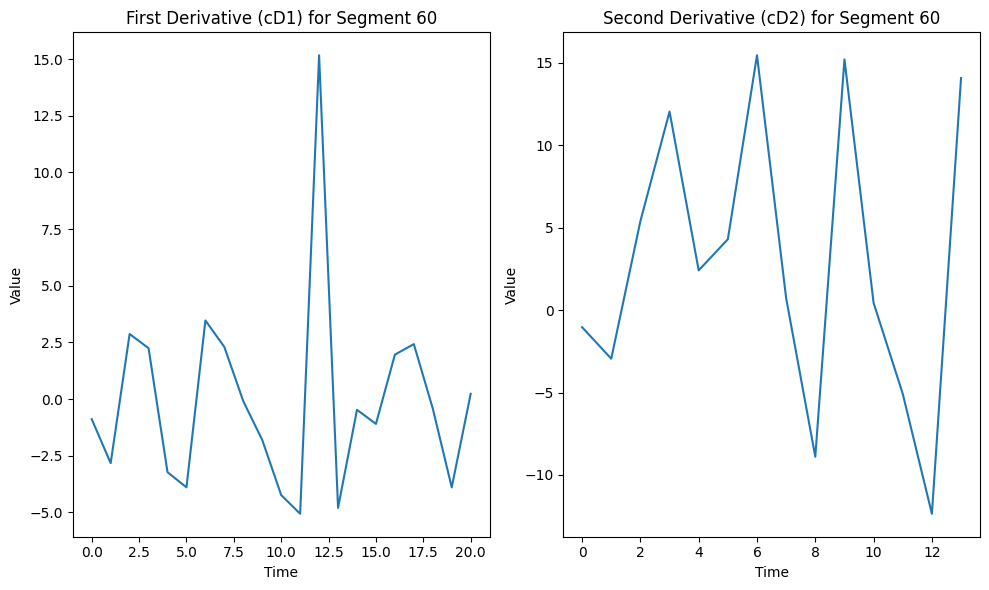

Segment 61:
  First derivative (cD1) length: 12, values: [ 1.46122624  5.15699997  2.83147522 -6.40830501 -1.95488146  3.79669674
  3.4339041  -3.43183733 -1.85252399  3.8369319   0.84568902 -5.32293863]
  Second derivative (cD2) length: 9, values: [ 2.0016305   6.33942846 -0.61507012 -5.01117492  5.1073305  -4.35356615
  1.26894569  2.33886679 -4.32701596]


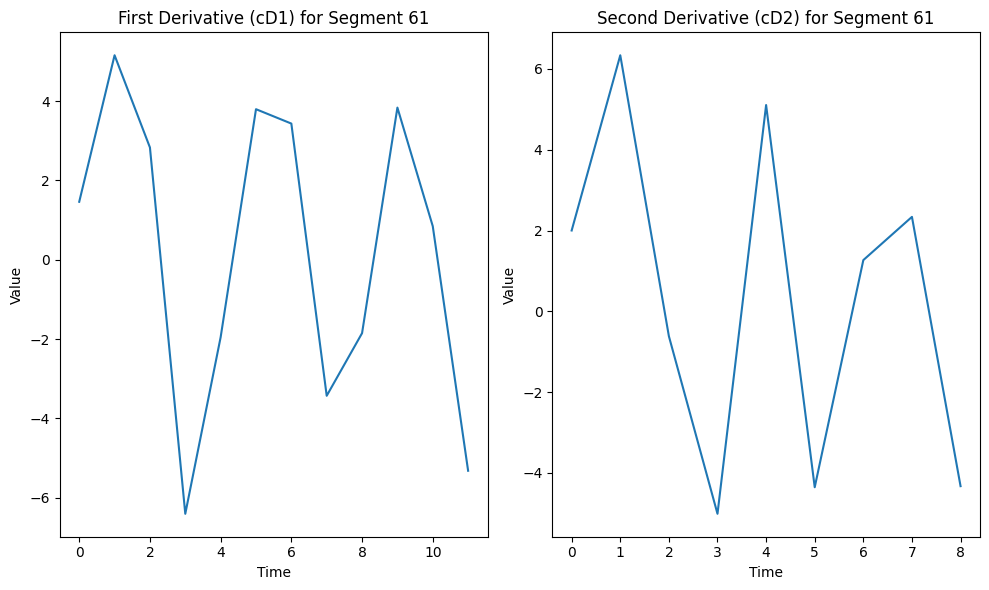

Segment 62:
  First derivative (cD1) length: 13, values: [  1.06993167   3.38247658   2.15064232   6.65279765 -16.63374205
   3.41999511   6.23909999  -1.21048792   4.0427821   -3.88745656
   0.90044954   2.44222531  -4.43347685]
  Second derivative (cD2) length: 10, values: [-2.01876835 -6.2030178   2.2158506   4.44908684 -5.42986385 -3.88696898
  1.90745952 -1.33660632  5.93549197  2.65677303]


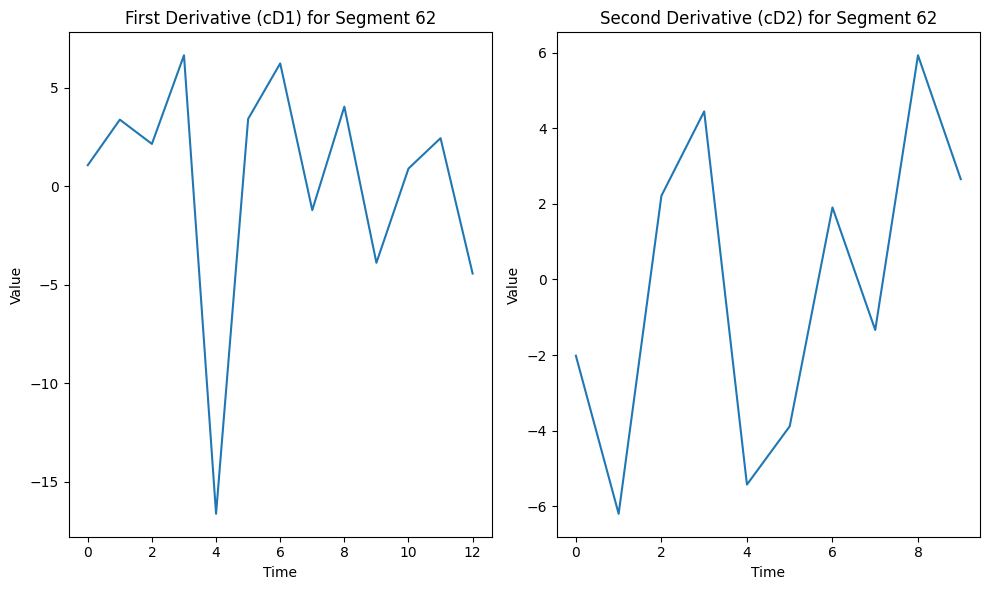

Segment 63:
  First derivative (cD1) length: 13, values: [-0.13536451 -1.71800411 -3.7224903   2.30588482 -1.57463182  4.09337148
 -7.82604803 10.45098868 -8.75342466 -7.39513842 12.2326253   0.5135379
 -6.79505706]
  Second derivative (cD2) length: 10, values: [ -9.14022594 -28.4805019   17.6786752    2.20474995 -38.73900027
  48.19551036 -17.89919562   6.90430616 -37.74287319  52.66179532]


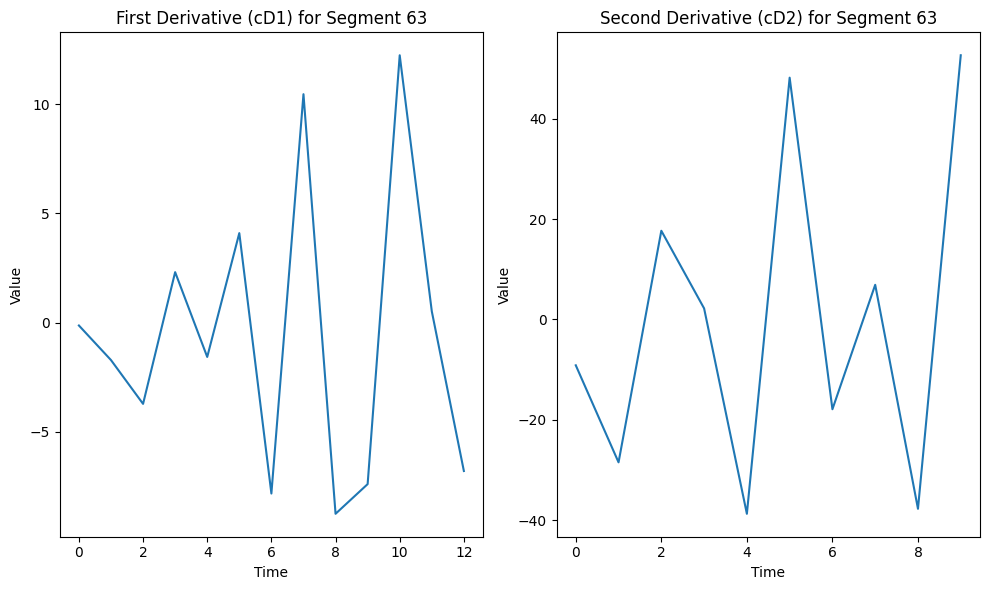

Segment 64:
  First derivative (cD1) length: 11, values: [ 1.06339233  3.04543605 -3.50241314  2.9279629   1.9417939  -5.0934805
 -0.71233479  2.81397826 -2.06696848 -1.3782095   4.08828814]
  Second derivative (cD2) length: 9, values: [ -1.74572934  -5.785854    -1.43128289  20.30937921 -26.8852512
  13.27862923  -8.70901413  22.10280607 -25.80335937]


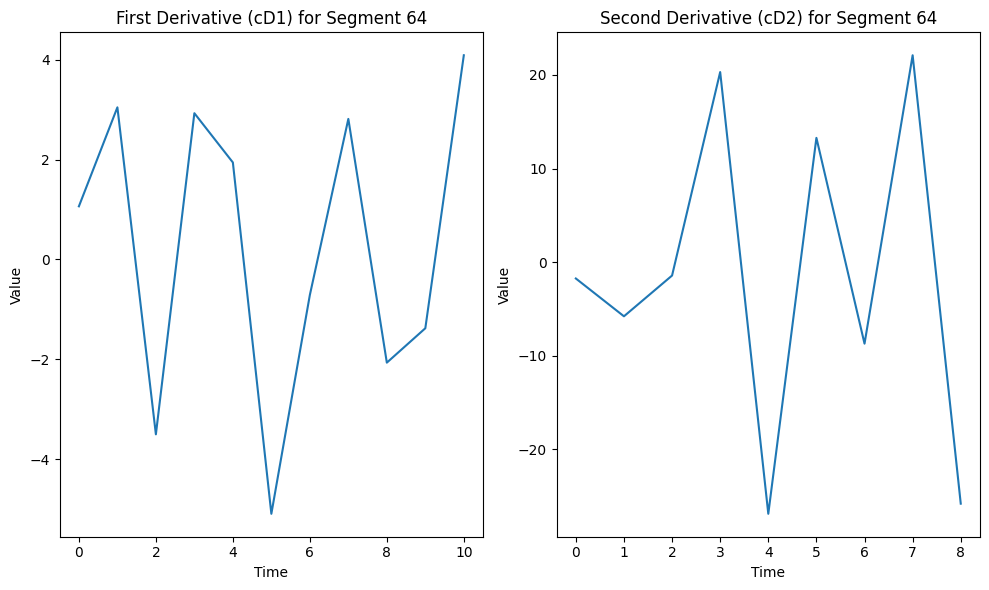

Segment 65:
  First derivative (cD1) length: 10, values: [ 1.91384199  5.19645709 -5.89204443 -0.80261514  3.53677482 -2.78497347
  1.69182974 -0.80447741  0.96387163 -3.32258353]
  Second derivative (cD2) length: 8, values: [ -5.84051473 -18.62422269   7.09783211  10.91055233  -9.73245789
   2.58245605   6.43599824 -16.26138281]


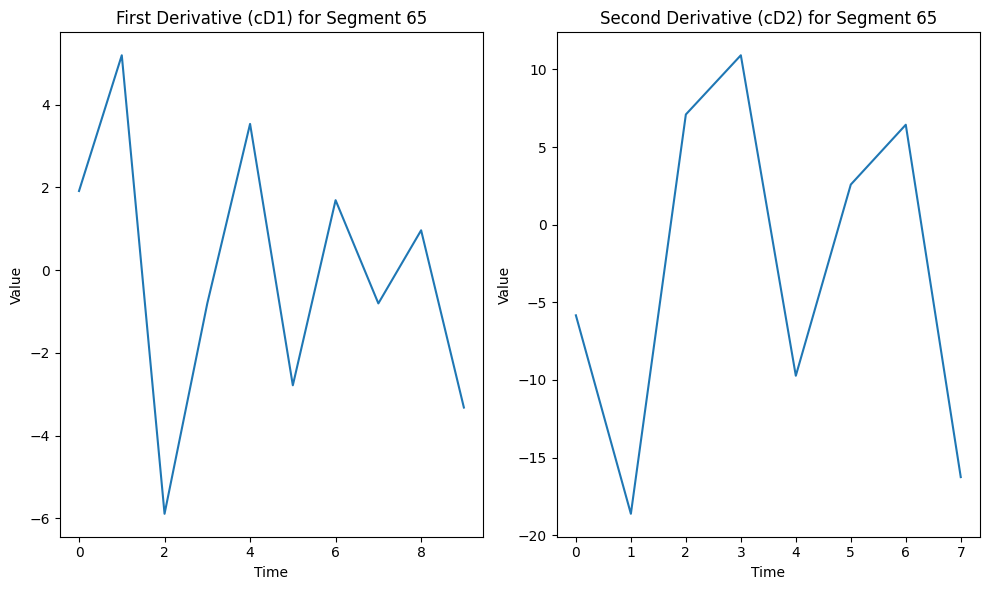

Segment 66:
  First derivative (cD1) length: 7, values: [-1.49343204 -4.18587153  3.3609673  -5.36083567  1.5062412   4.48786839
 -3.90440821]
  Second derivative (cD2) length: 7, values: [  4.14123168  13.23174252  -3.00147521 -17.20462032  24.15459438
  -9.34056684 -11.98090621]


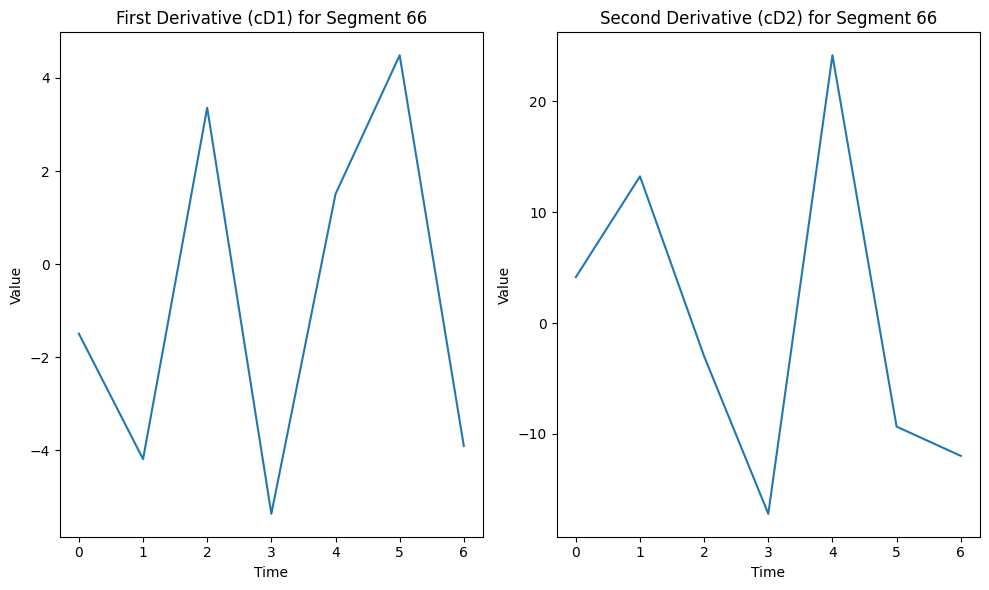

Segment 67:
  First derivative (cD1) length: 242, values: [-1.54382605e+00 -3.50986106e+00  1.33631891e+01 -3.68967187e+00
 -9.61582485e+00 -9.66648415e-01  3.49029252e+00  3.57527737e-01
  3.63101208e+00  2.15666818e+00  3.55534976e-01 -6.60312112e+00
 -3.58318373e-01  6.34024005e+00 -8.69582037e+00  2.56283374e+00
  1.20098408e+00  1.62406438e+00  5.95065650e+00 -8.81164434e+00
  2.87478362e+00 -3.04164834e+00  2.59200925e+00 -1.33879547e+00
 -1.03772317e+00  6.35306857e+00 -2.71397742e+00  3.88358960e-01
 -5.12596347e+00  2.11511033e+00  4.48194573e-01  4.49277981e+00
 -3.76558065e+00 -6.24511756e+00 -1.23165442e+00  7.46143860e+00
  1.65471296e+01 -8.33326382e+00 -1.40518466e+01  1.58185902e+00
 -4.99583368e+00  9.97425734e+00 -3.54493096e-01  1.48254564e+00
  5.47063836e+00 -5.66416142e+00 -6.29343155e+00  5.00460817e+00
 -7.70110469e+00  3.82208090e+00  1.18557195e+01 -5.71662211e+00
  2.25158046e+00 -7.02738608e+00 -9.30748120e+00  1.34239139e+01
  6.22527288e+00 -1.03444741e+01

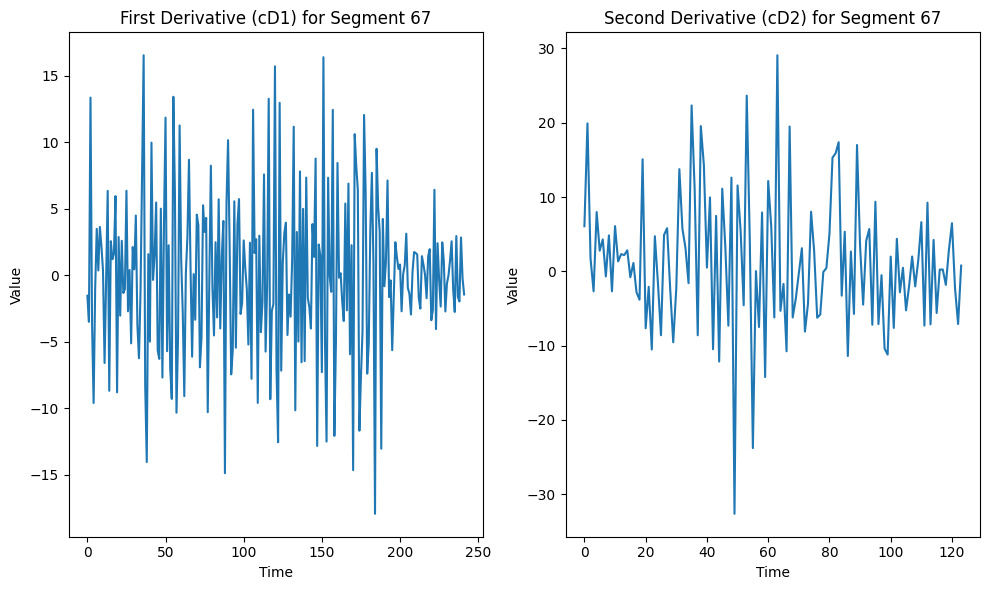

Segment 68:
  First derivative (cD1) length: 50, values: [-2.33936438 -7.15702026  4.83385365  0.28692755 -4.87508795 -3.47498814
  1.06234869  5.81616314  0.92798201 -2.08796242  1.32291829 -0.11229746
 -2.60041155  3.95183603 -3.45991701  2.56260217 -4.81241039  1.62465831
 -2.98746975 -0.08553223  8.4760278   0.85972613 -0.99678801 -4.22290446
 -1.79803099 -3.22308088  4.2102879  -0.81257728  5.40259921  0.680902
 -2.30029281 -2.46784039 -2.02758407  6.66900858 -9.8384932  -2.00182189
  6.73146504  5.38159246  1.75203937 -9.54163253  2.45647027  5.90709086
 -5.8364138   2.55621908 -4.98801645  0.1257822   7.28281781 -8.71778305
  3.53944081  2.4371653 ]
  Second derivative (cD2) length: 28, values: [  1.53825423   5.31648186   3.08362308  -0.28355344   0.69250204
   1.51887233   1.13604268   5.75829049   8.6536042   -0.08762647
   3.82796232  -4.05692041   2.67268594   4.29331903   7.39850072
   1.78693834 -17.10158667   3.318464   -15.56651296  -9.85477652
  23.71534324 -21.3219831

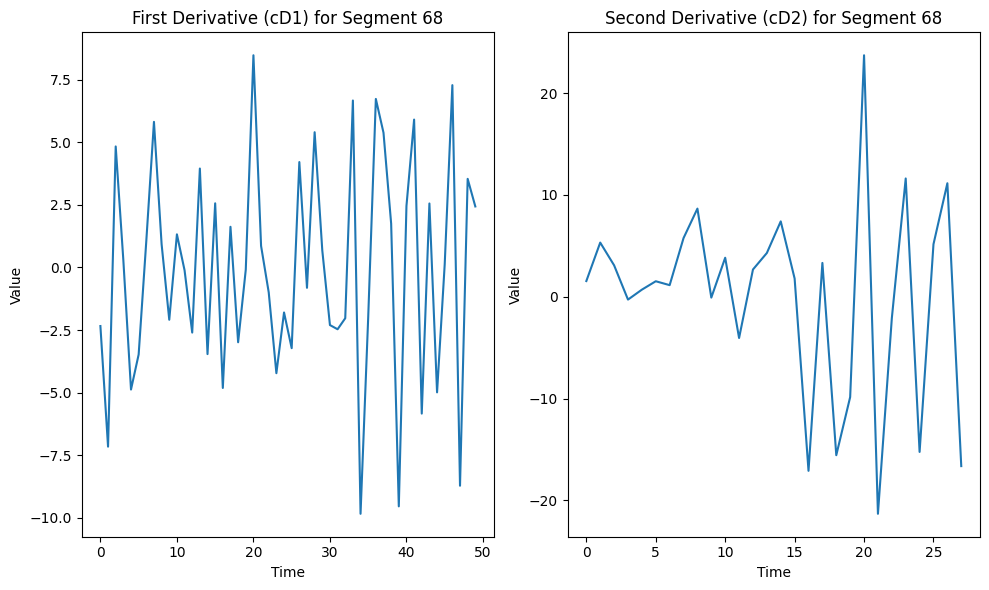

Segment 69:
  First derivative (cD1) length: 28, values: [-0.15469288 -0.36588698  0.97248631  4.55515686 -2.29110013 -3.32559362
  2.92809039  0.7206757  -6.95824808 -1.40791158 17.77603305 -6.22680879
 -6.93370573 -4.64628641 10.65966632 -3.94951091 -0.08137374 -7.21617827
 10.94498412  1.36032275 -1.21073591 -6.62458903  5.39823803 -9.93109373
  3.16260085 -1.08332066  8.18206852 -5.14160758]
  Second derivative (cD2) length: 17, values: [  0.55690386   1.73998969  -2.29539617   1.15085715 -15.12320868
  15.03005821  -7.87624785  -5.62248018 -22.31524789  11.9980433
 -23.03723501  23.21756276  -7.819586    -2.66566159   0.27223655
   5.29500087  -2.69580622]


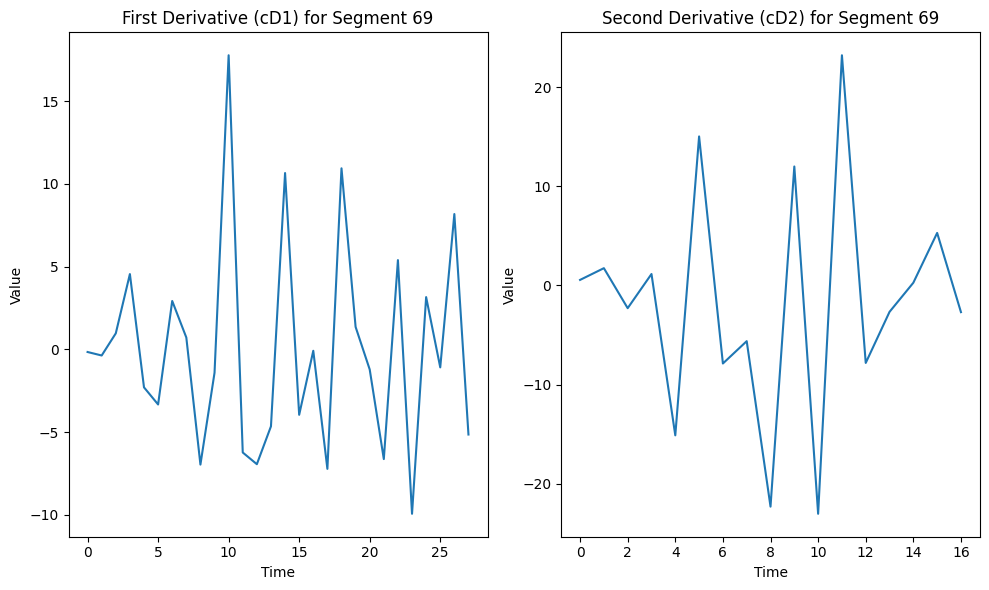

Segment 70:
  First derivative (cD1) length: 29, values: [ -1.59922554  -5.67883052  -0.39489561   1.91848293   1.07823705
  -6.32966524  -0.4596291    0.12041914   6.21919098   1.92446835
   5.58866496  -8.87347982  -7.08883138   6.23709411   8.73567471
 -16.13006544   6.40619986   0.82453165   3.56727814  -4.0151817
  -0.10159923   6.2990327  -11.05617303   2.73219145   9.57722013
  -9.61071075   2.99669723   6.5667975  -13.5708058 ]
  Second derivative (cD2) length: 18, values: [ -3.82595496 -11.72581243   9.91368709   5.09469944  -5.53527861
   6.17215472  -8.21417856   9.64075255 -53.17796176  18.04162737
  -8.33462773  -6.07765517   5.68039013  -9.1061292  -10.60849745
  17.50911925   1.66045115  -5.45266635]


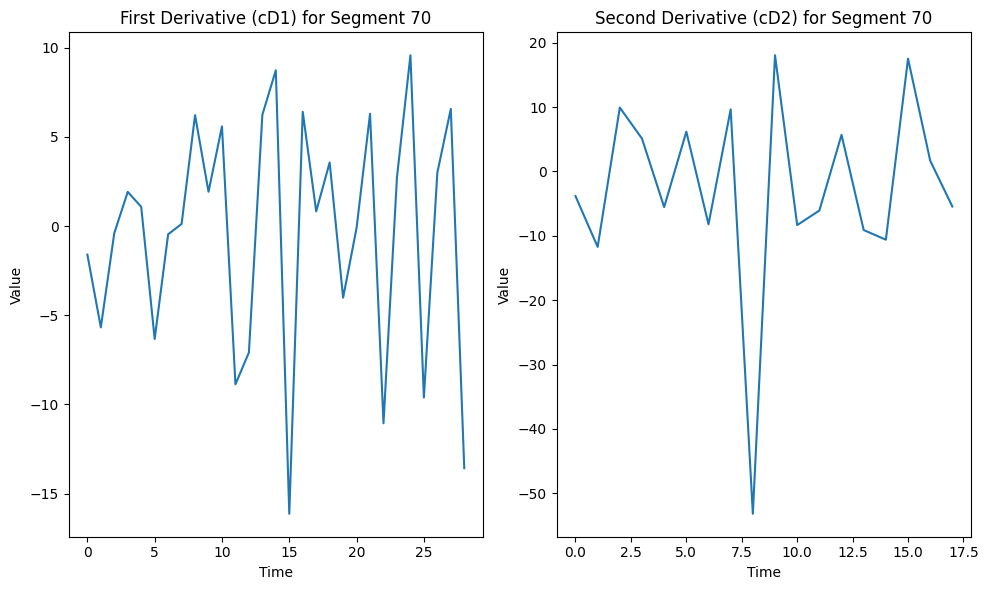

Segment 71:
  First derivative (cD1) length: 26, values: [ -0.47411904  -1.62552308  -4.84532174   6.09506352   0.79535694
  -3.92304121  11.65339814  -5.47295332  -2.30479679  -4.09248714
  -1.26529612   2.16008725  14.26322755  -9.6682685   -2.07904163
 -11.21234955   7.46671522   5.41947525   3.81686897  -6.61862818
   8.42387341 -10.97697859   2.11434806  -0.10071709   0.78976303
   8.25681478]
  Second derivative (cD2) length: 16, values: [  1.78290328   5.11804159 -11.98640235 -18.21629388  -7.72182534
   5.5582252    7.42624867  -7.90923572  -3.50458944  -4.10075206
   2.2612632  -13.50704218  -4.34077046   1.13244051   9.05339052
   9.15864528]


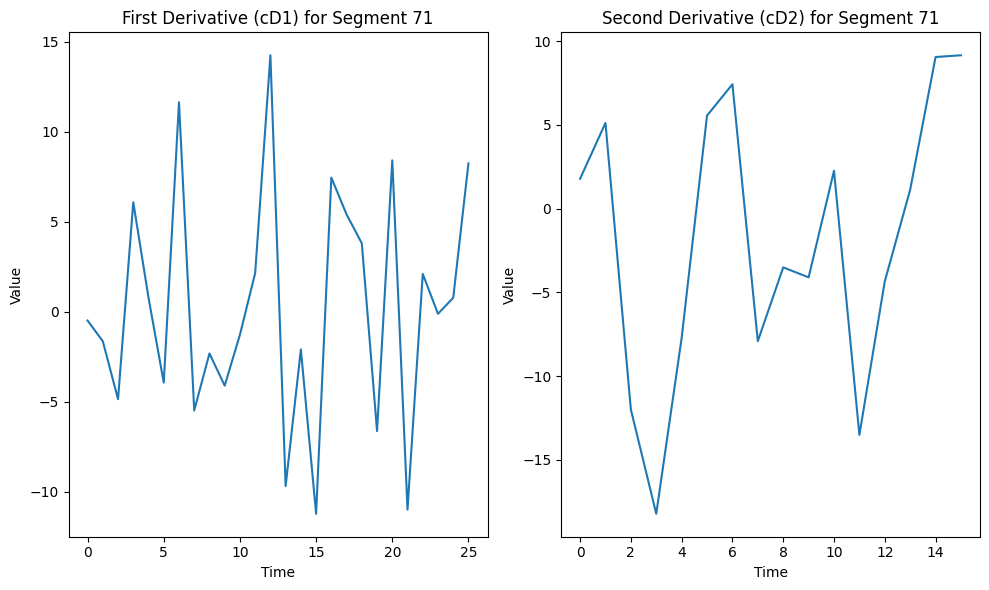

Segment 72:
  First derivative (cD1) length: 20, values: [  2.48241486   9.35073093  11.56766452 -12.77704247  -2.63459486
  -2.45365625   6.33721987  -1.44194179  -4.65316117  14.95940574
 -14.63591983   2.0414552    5.60735256  -6.11032704  10.03756435
 -13.40443295   0.35800419  -0.44100376   4.69019205   8.49107578]
  Second derivative (cD2) length: 13, values: [  4.89078347  15.84751073   3.77593101   8.06613738  -8.25625299
 -10.20033961  -1.25409634  -8.73213414   3.09348891   5.73363578
  -1.46000983  -6.38292866   1.48829566]


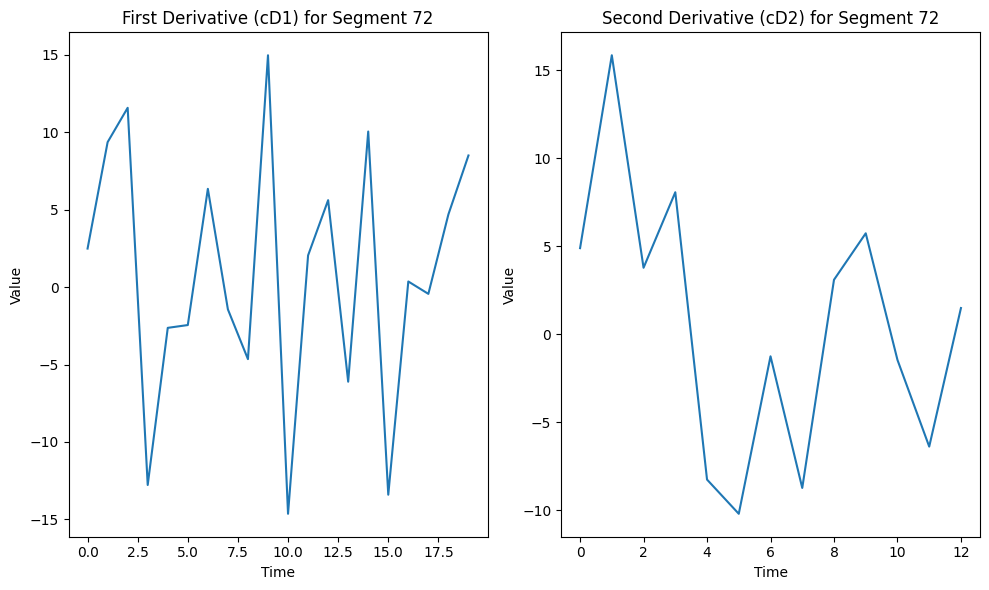

Segment 73:
  First derivative (cD1) length: 11, values: [-1.21435178 -3.07773327  6.27070226 -5.21828267  0.91782008  3.24939153
 -5.16477737  2.05968201 -0.63544059  3.58423969 -4.38670575]
  Second derivative (cD2) length: 9, values: [ 4.22724409 13.66893017 -0.31795724 -9.12734411 -3.45145906  1.53716888
 -1.26829189  7.04882631  6.80839151]


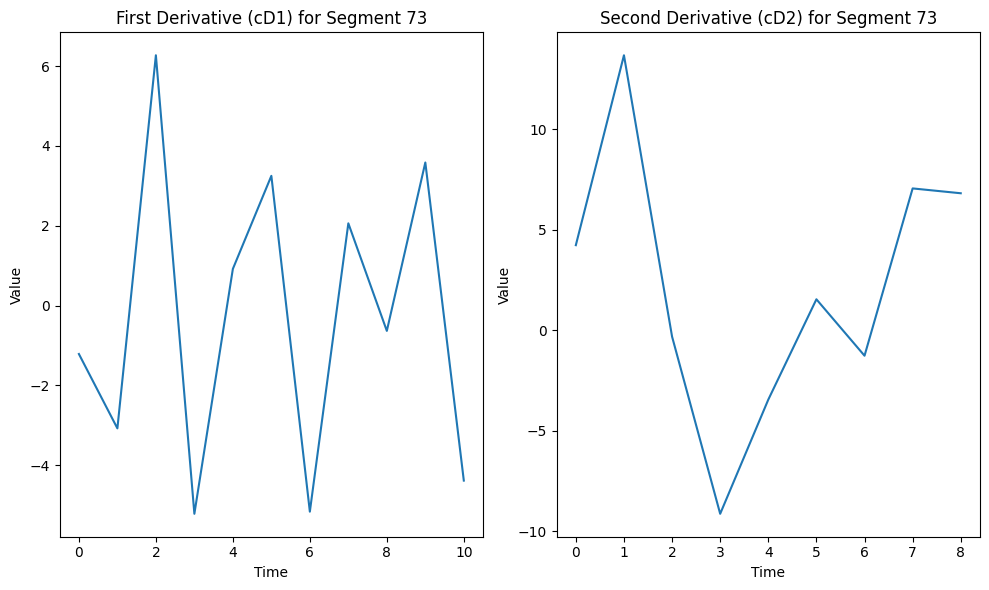

Segment 74:
  First derivative (cD1) length: 8, values: [-1.68003639 -5.17654461  5.36319671  1.75476751 -2.7578389   0.36626978
  2.93694787 -4.97212402]
  Second derivative (cD2) length: 7, values: [ -0.33238511  -0.50971358   7.29563941   8.68725131  -2.54681741
 -10.43887314  -3.67973613]


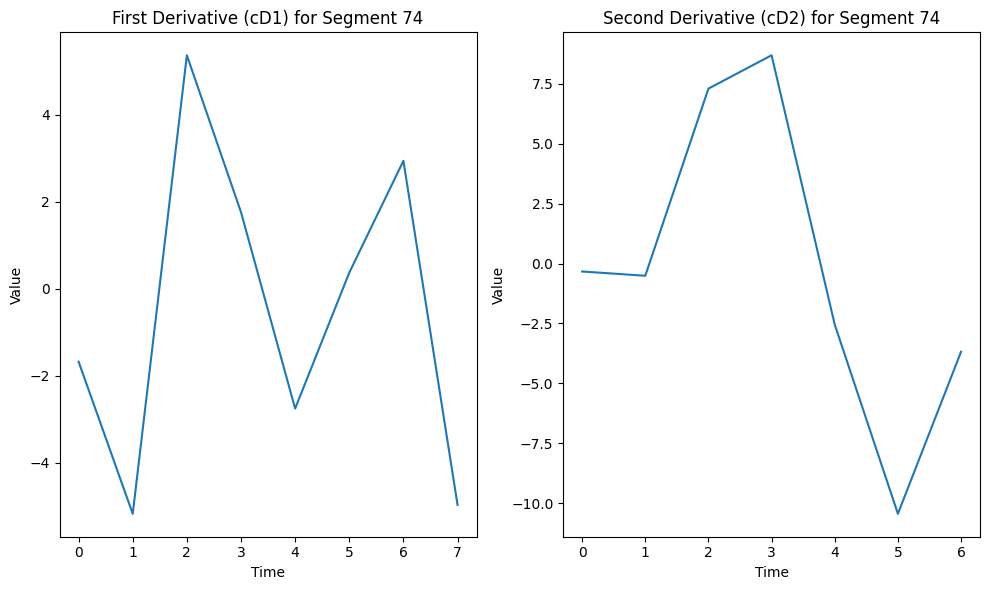

Segment 75:
  First derivative (cD1) length: 17, values: [ -0.30458668  -1.60813579  -4.80411912   6.29881278   3.68860697
  -3.32097547  -9.52239811   2.29027718   4.20445075   2.74952051
   6.38731331 -16.23393267  11.91552834  -0.93129338  -0.9389263
  -6.44566158  13.82499052]
  Second derivative (cD2) length: 12, values: [ -2.79477889  -9.03671133  -0.36994387   3.09074985   1.23314423
   0.98962568  21.97545911 -20.94623174   8.53610853  -2.76266826
  13.17607368 -29.55184985]


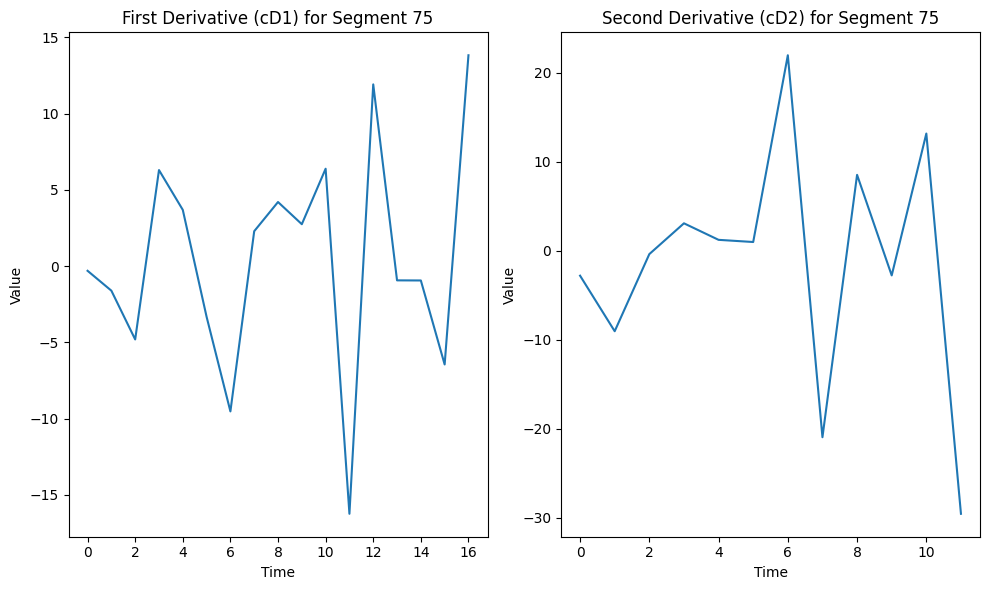

Segment 76:
  First derivative (cD1) length: 14, values: [ 1.68931377  4.68740106 -9.78347793  4.60591179  3.18952402  5.02777819
 -8.47226839  7.06277098 -2.33787316 -1.13750081  0.31816409  0.20244094
  1.84240739 -0.85390224]
  Second derivative (cD2) length: 10, values: [ -1.93449997  -6.87831455  -9.31345993 -15.76019906   4.41655901
   3.95811373   1.05282797   0.31635632  -4.52594673  -2.70577984]


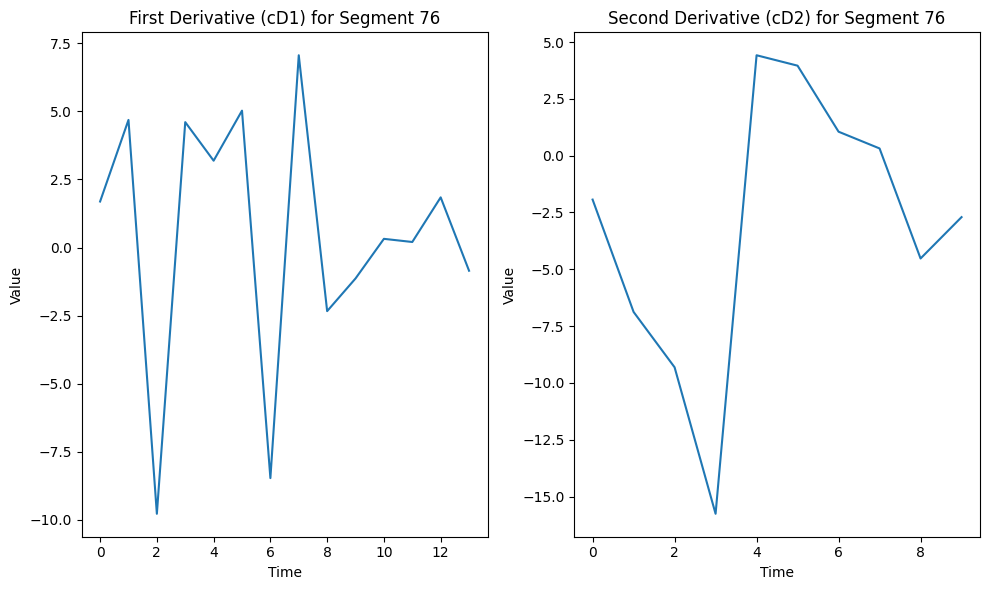

Segment 77:
  First derivative (cD1) length: 18, values: [ -4.7346378  -16.13720667  -1.63083883   7.63169334  -6.70014521
   9.96358719  -2.56301958 -10.06009734   1.77089988  10.15232285
   1.15971463  -4.26446056  -5.61132031   0.58635307   5.52690734
  -1.27216262  -6.79394768   4.79715439]
  Second derivative (cD2) length: 12, values: [ -5.35311404 -16.25443509  11.68993808  -2.03006495  14.82527781
  -7.51557065  -0.8985463  -20.32593111  -5.28710791   1.53211759
  11.3524026   17.12280589]


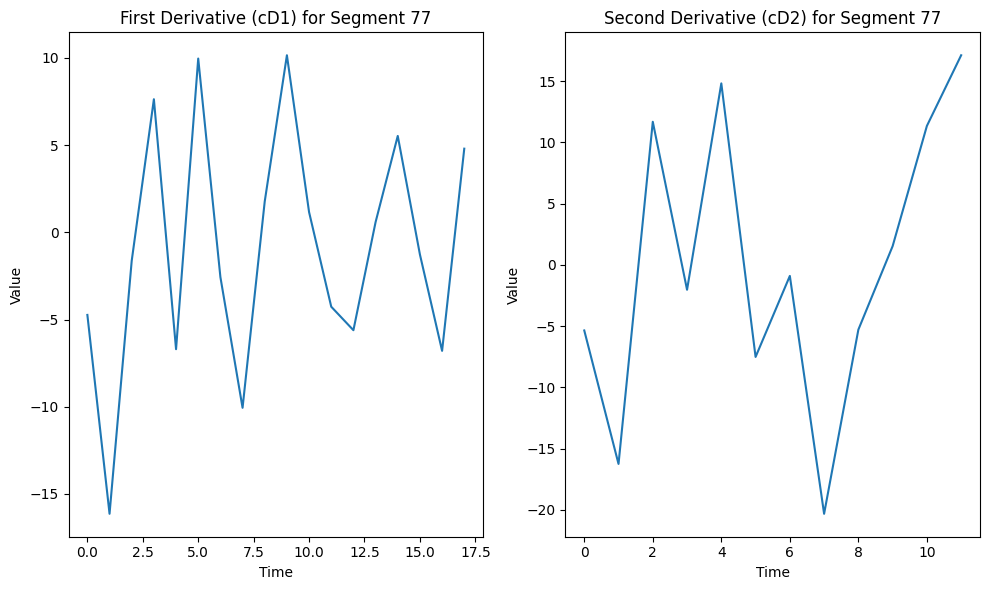

Segment 78:
  First derivative (cD1) length: 13, values: [  1.03471258   2.50372226 -10.32542778   9.18205595   2.41297569
  -8.69585215   8.65133348  -1.77550744   1.33523122   1.49993778
  -2.53777053  -0.0993651   -0.76416803]
  Second derivative (cD2) length: 10, values: [ -2.06802367  -7.34538899 -10.83120173 -10.43419772  -4.90439466
   8.58097538  -3.14854779   1.01286542  -6.20739131   9.86567102]


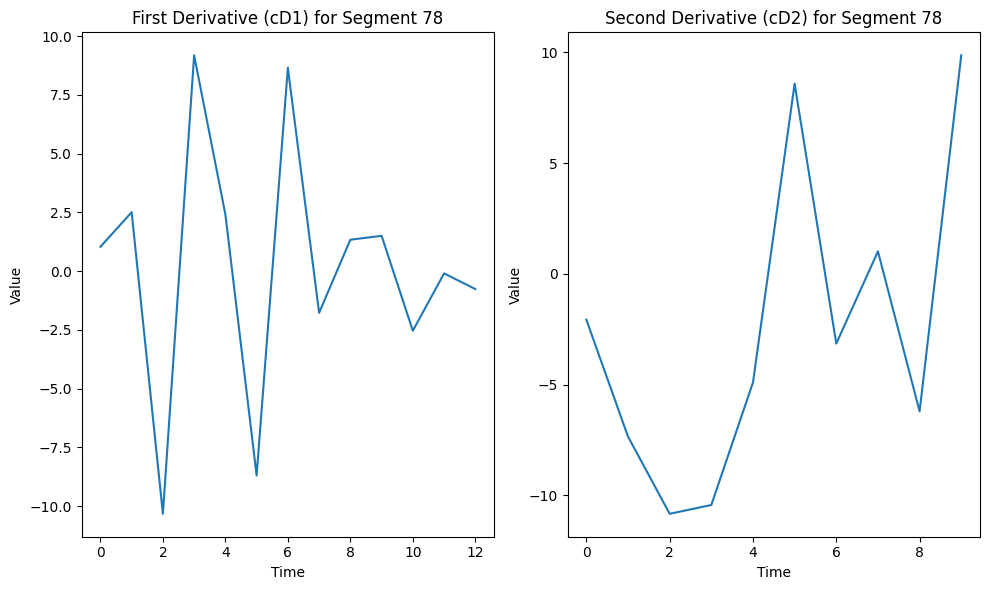

Segment 79:
  First derivative (cD1) length: 11, values: [-0.64189654 -2.74392203 -5.30634139  7.06021262 -1.90529461 -2.10018211
  6.52230891 -2.81234386  1.03132789 -5.65557341  4.47909858]
  Second derivative (cD2) length: 9, values: [ -2.81923403  -9.10126392  -1.43607787  -2.04808669  21.93990639
  -8.46421111   4.04889102 -22.38624373  10.14896222]


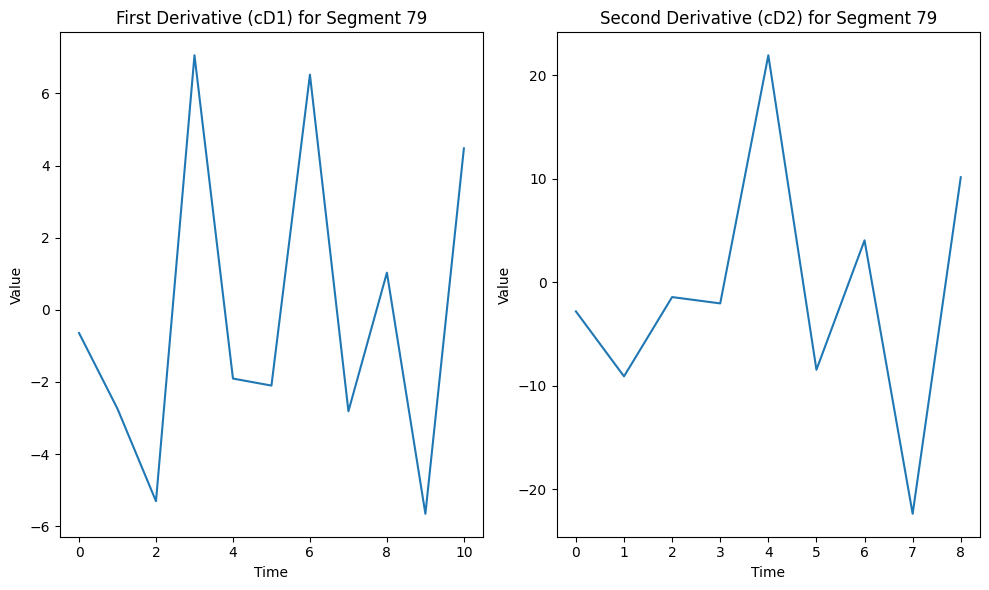

Segment 80:
  First derivative (cD1) length: 5, values: [ 1.70002901e-16  1.70002901e-16  1.70002901e-16  1.14491749e-16
 -2.42861287e-17]
  Second derivative (cD2) length: 6, values: [3.05311332e-16 3.05311332e-16 3.05311332e-16 8.32667268e-17
 1.94289029e-16 2.63677968e-16]


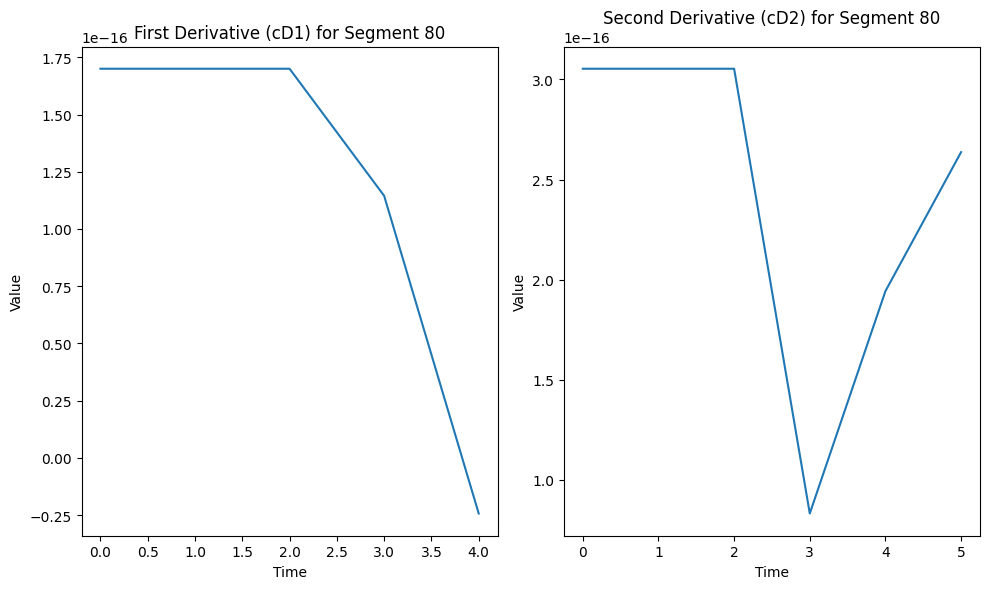

Segment 81:
  First derivative (cD1) length: 7, values: [ 2.85014743  9.34514037 -1.85730484  0.19818705 -0.68665791  1.16030693
 -1.6506927 ]
  Second derivative (cD2) length: 7, values: [ 1.68935789  4.82423267 -8.82969123 -3.86144257  7.69866326  4.69183514
 -6.21295516]


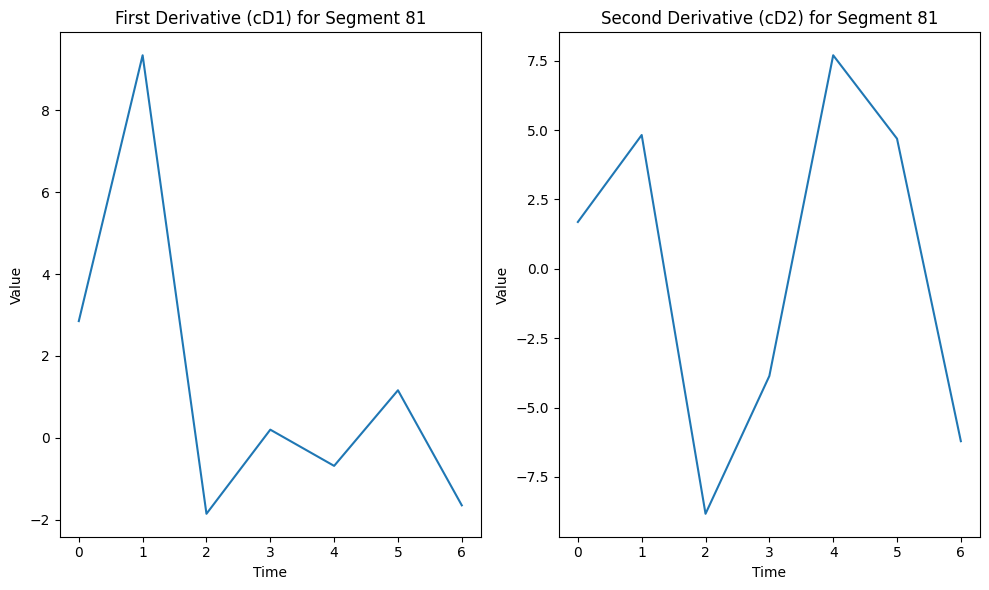

Segment 82:
  First derivative (cD1) length: 9, values: [-0.26222889  0.25018725  4.71800747 -5.78439406  4.20828689 -3.28561611
  0.62003396  3.16501323 -4.861191  ]
  Second derivative (cD2) length: 8, values: [  7.10941831  22.35597933  -9.44198126 -11.56888394 -10.686471
  17.83936674   9.18822831  -1.72266421]


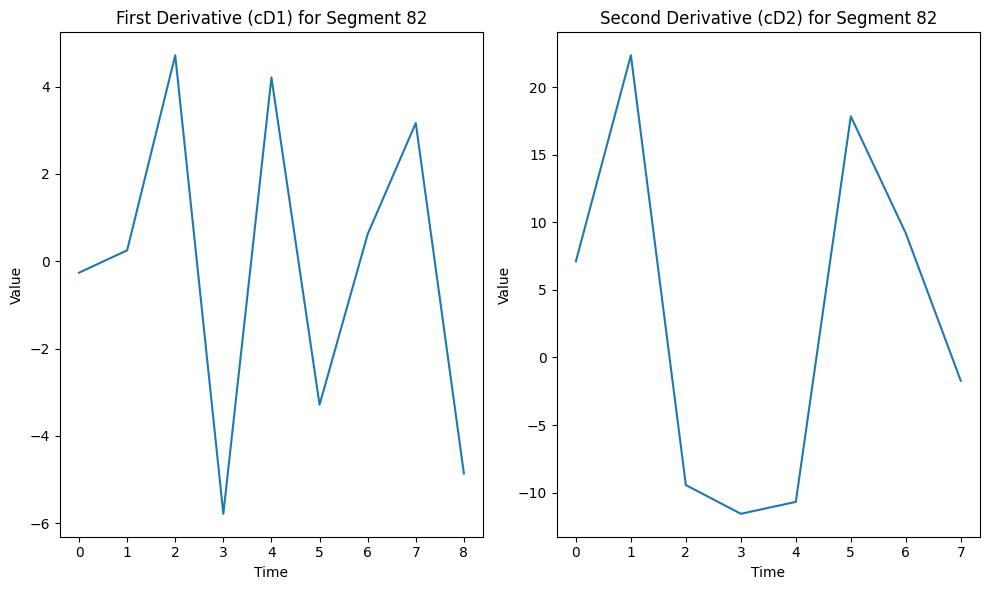

Segment 83:
  First derivative (cD1) length: 8, values: [ -4.09547067 -11.5016447   10.41213118  -5.71121035   2.40067856
  -1.01489811   1.92493004  -6.50783986]
  Second derivative (cD2) length: 7, values: [ 10.50744782  33.61207702  -8.49083911 -12.5508172    3.359501
  15.77104388  -9.09568323]


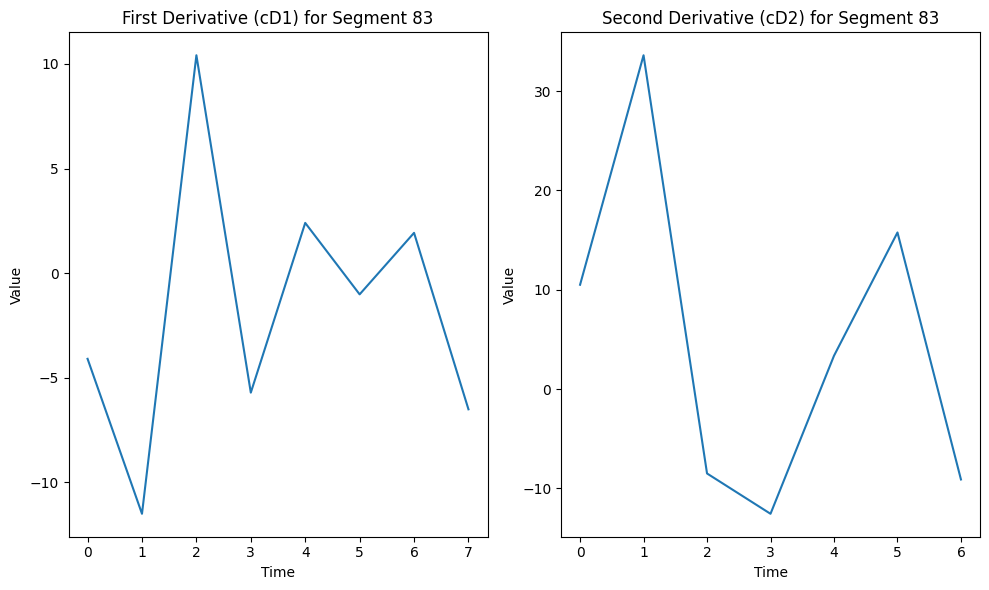

Segment 84:
  First derivative (cD1) length: 9, values: [ 2.23578598  7.17840049 -2.26320299 -3.6362266   2.54318404  0.56826887
 -1.84678876 -0.8636896   5.06442973]
  Second derivative (cD2) length: 8, values: [ 0.36006465  0.78594548 -3.5837794  -0.1843432  -1.55163726  1.34583745
  1.23369705  3.56259106]


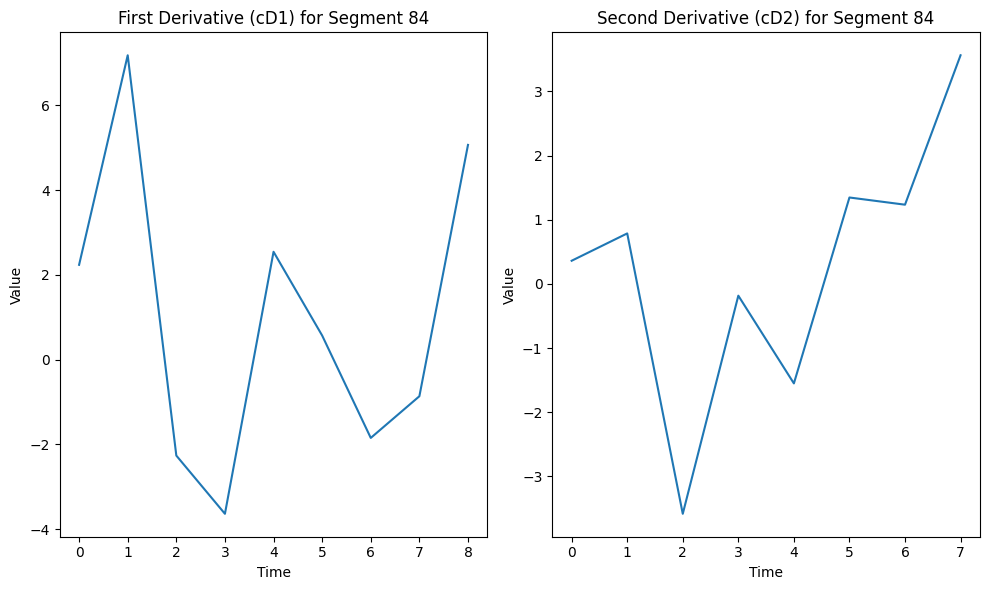

Segment 85:
  First derivative (cD1) length: 7, values: [-1.81578134 -4.71204466  9.88191386 -3.60870374  1.23602385 -7.87128357
  6.8898756 ]
  Second derivative (cD2) length: 7, values: [  5.17249196  16.85610969   1.41333237  -1.84068881   2.09461005
  -7.74213933 -15.95371593]


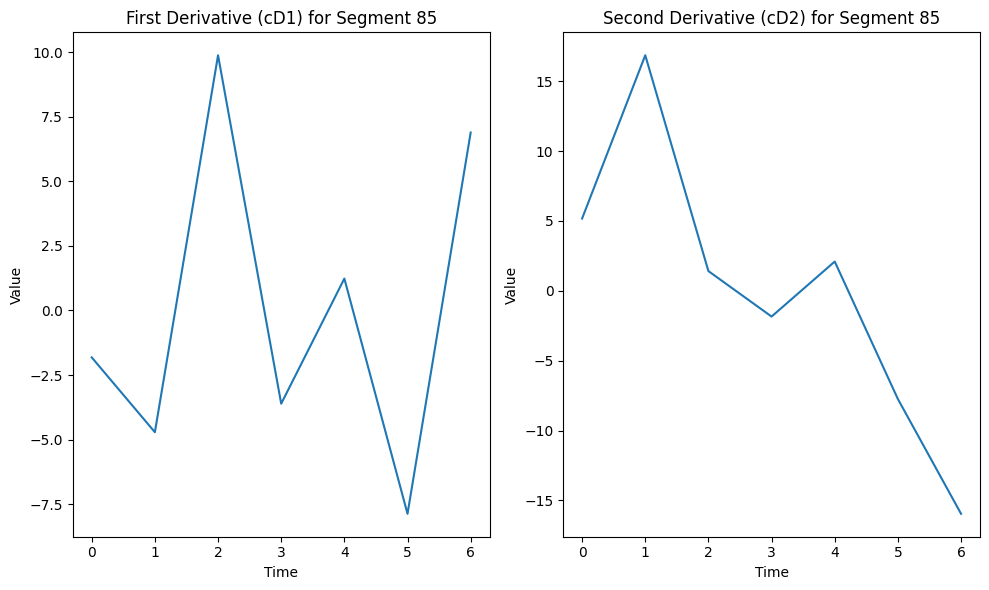

Segment 86:
  First derivative (cD1) length: 25, values: [-0.43424398 -1.87902117 -3.4876889   8.77786909 -3.70897835 -3.38980078
  1.90619702  3.11604119 -7.36489923  7.10383553 -2.44246253  3.46188648
 -5.0626249   1.09928306 -2.42405176  2.59818449  2.54682127  0.80604698
 -7.33804246  8.70003915 -8.37424939  2.23849665 -0.85534682  6.68769727
 -8.53255064]
  Second derivative (cD2) length: 16, values: [ -2.2244386   -7.17859859  -1.95691223  -2.53928392   1.88902608
 -10.75798123  -1.41913223   3.44890583  -6.15369407  10.84402287
   4.12297751  10.60583014  -1.94241243  -0.06345493 -12.81029457
  -2.82688698]


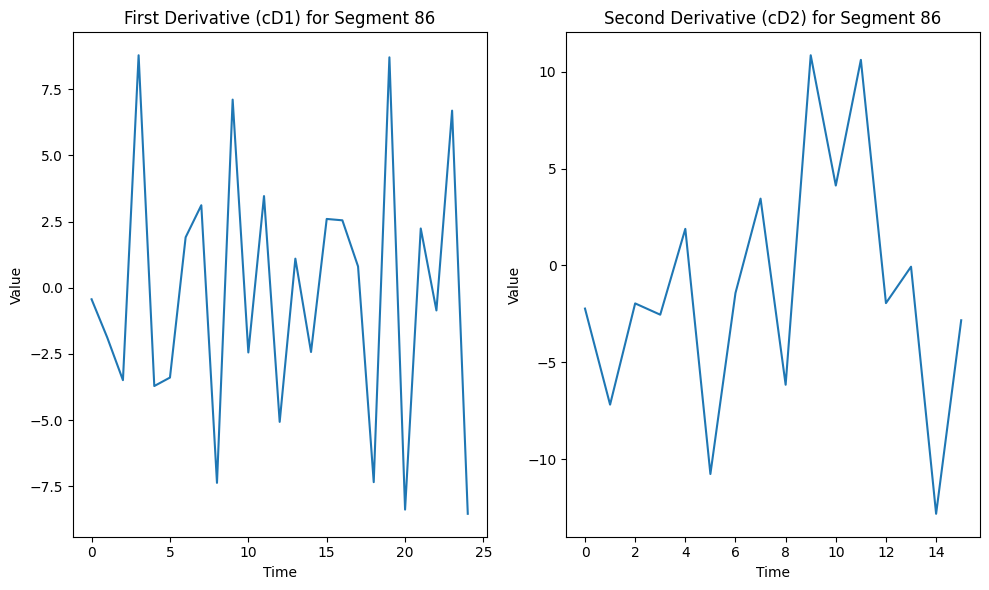

Segment 87:
  First derivative (cD1) length: 34, values: [ -0.10769741  -0.45907555  -0.43263138  12.91823308  -5.01821999
  -8.24189615   5.43646864  -4.40856969  -2.29528287   0.36891492
  11.14863158  -4.19962352 -10.02939794   8.43267316  -5.37661055
   5.98497822   2.73785844  -0.37683502  -6.85839402   2.27514914
  -0.12014235  -0.45568133  -3.16725898   9.23572921  -6.17569681
  -0.86799001  -0.32863711   3.54260557  -0.07437152  -3.2906208
   5.4690647   -1.63820758  -4.13700183   5.22291199]
  Second derivative (cD2) length: 20, values: [ -0.88849576  -2.93545295  -3.98615721   3.38373794  -0.97923295
  -2.32064767  12.25913583  -2.93753609  -2.49180499 -11.59687088
   5.71402569 -12.43393213   5.02691794   1.56018428  -8.13374597
   2.5648994   -7.35579037   2.94602995   4.94325565  -1.03741194]


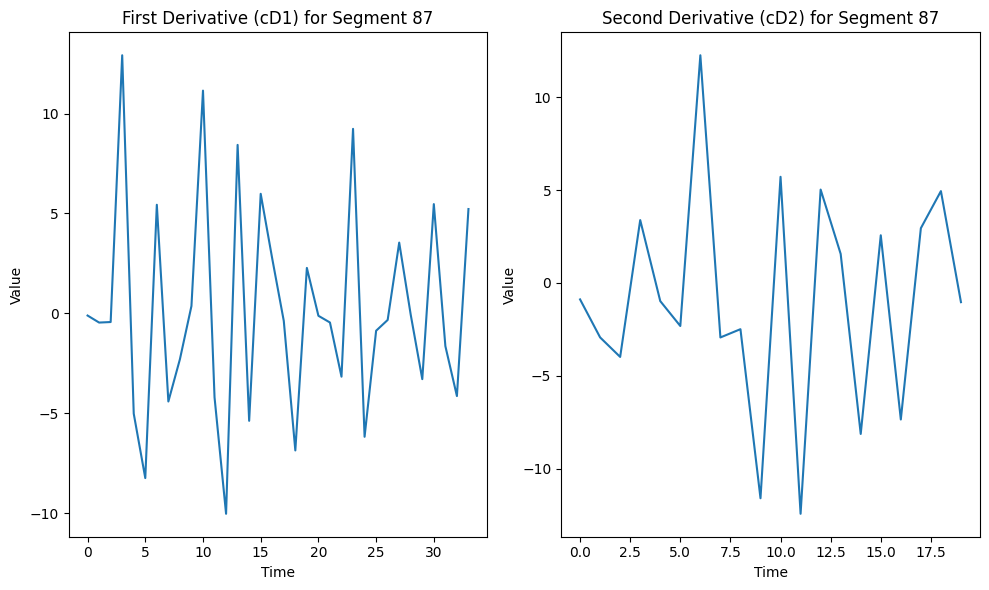

Segment 88:
  First derivative (cD1) length: 51, values: [  1.36641229   2.51848791 -12.19778029   8.05001712  -8.70815655
  13.25370219  -6.67847356   4.963707    -5.67528428  -0.05596278
  -0.80868072  -0.02806052   7.01855598  -3.89649636  -1.58713613
  -5.23309014   7.73636335   0.16964711   2.06748575  -4.59389591
  -0.8010114   -0.74633528  -0.2741484    3.36066375   1.39691902
  -1.05694112   0.73847663   3.06852099  -7.94547507  -5.73339764
   5.74284982   5.12199595  -0.29941352   4.2224693   -8.35730874
   0.36763159   0.95516243  -0.49532879  -1.88744331   6.75945056
   4.20425677  -8.69871889  -5.39754486   5.71314066   3.81351917
   1.40967283 -11.28875461   8.70928023  -7.80209898  13.1159094
  -6.39159008]
  Second derivative (cD2) length: 29, values: [-10.11484099 -32.24886588   6.22433294   1.64805191 -15.68753499
   3.41081226  -2.63980195  -4.78996019   2.4485139   -3.51555303
  -7.40728233  -2.53593454  -2.76613607 -21.5141298   20.59019607
  -6.22404944   6.2513635

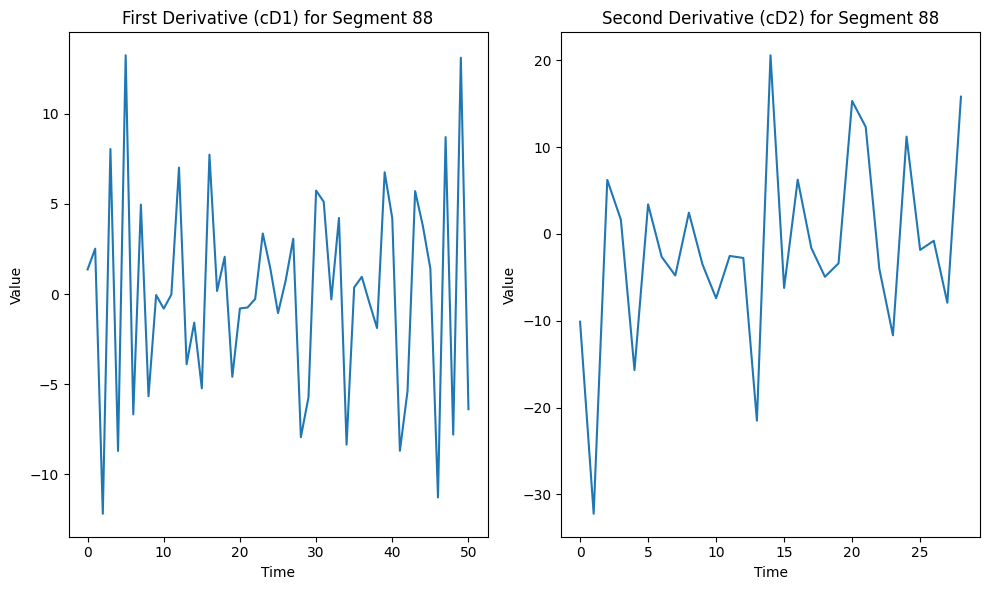

Segment 89:
  First derivative (cD1) length: 200, values: [-1.52457507e+00 -5.66617506e+00 -7.12265557e+00  5.95672829e+00
  3.67727214e+00  8.09605614e+00 -8.65552561e+00  3.34624014e+00
 -7.47023609e+00 -2.92800082e+00  7.99024021e+00 -7.35392564e-03
  1.26310633e+00  1.83813860e-01 -2.12100865e+00 -7.12630506e-01
 -5.27918351e-01 -3.03094830e+00  3.08760581e+00  7.61532619e+00
 -5.08457962e+00 -1.06644844e+01  8.79984324e+00  2.87588547e+00
  1.25762112e+00 -4.61350547e+00  2.67994400e+00 -5.10810878e+00
  5.77243084e+00 -1.18402417e+01  8.68524517e+00  3.09467851e+00
 -1.04355877e+00  3.06248906e+00 -6.22268661e+00  9.43309040e+00
 -1.50012762e+01  7.59256547e+00 -6.19915754e+00  3.29470799e+00
  7.07287157e+00 -2.75657155e+00 -1.14414767e+00 -2.12284291e-01
 -4.46869522e+00  6.77867056e+00 -1.11400091e+00 -2.54897532e+00
  1.16730610e+00 -4.53164644e+00  4.78243716e-01  7.08357419e+00
 -4.50819610e+00  9.17634701e+00 -2.72600020e+00 -1.11554595e+01
 -6.58529272e-01  4.18197573e+00

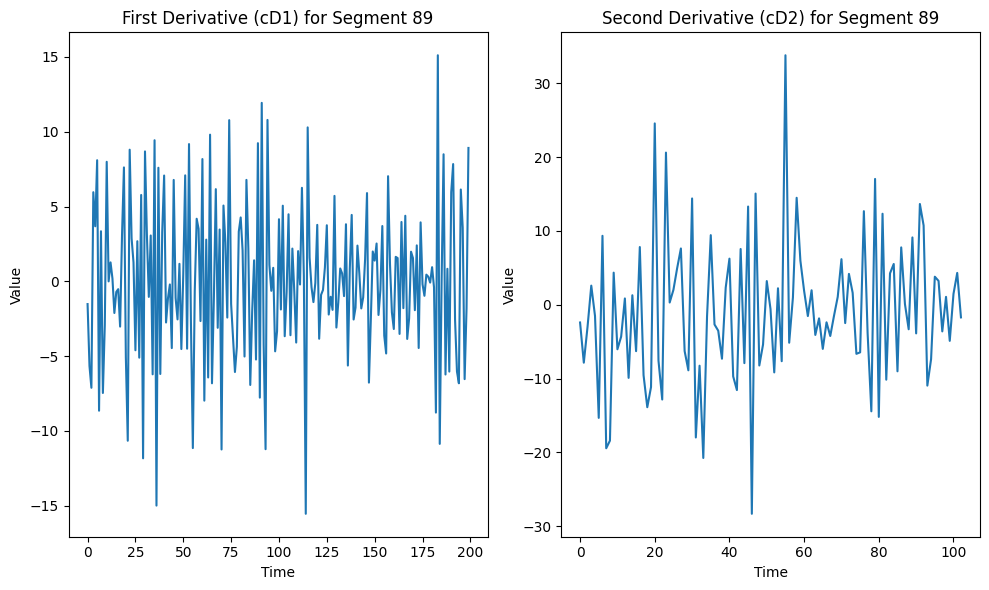

Segment 90:
  First derivative (cD1) length: 5, values: [-9.15933995e-16 -8.88178420e-16  8.60422844e-16 -1.36002321e-15
 -4.71844785e-16]
  Second derivative (cD2) length: 6, values: [ 6.10622664e-16 -3.21964677e-15 -5.21804822e-15  4.82947016e-15
 -2.77555756e-15 -2.77555756e-16]


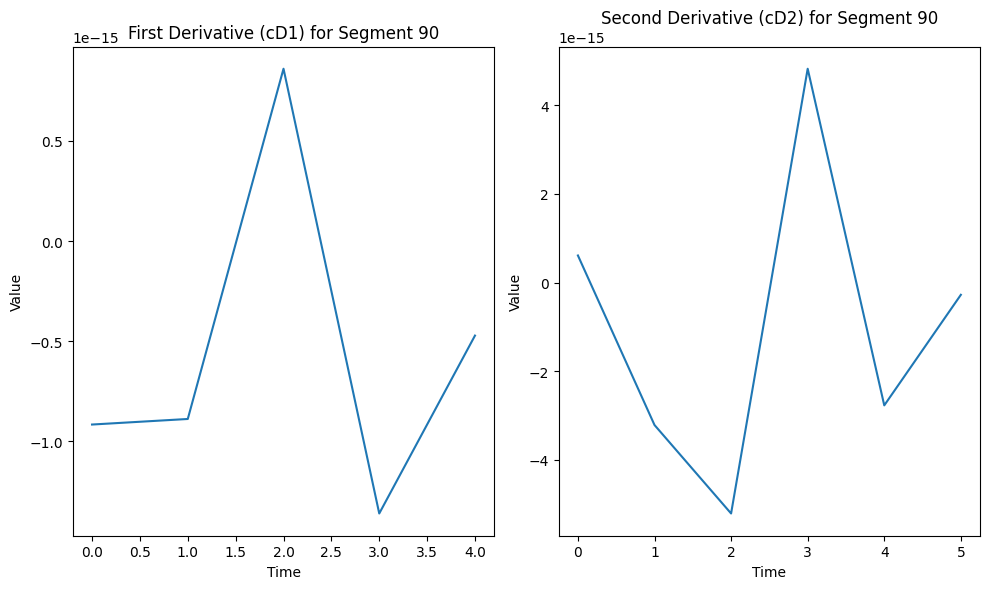

Segment 91:
  First derivative (cD1) length: 9, values: [ 2.65092832  8.20592751 -3.97981861 -6.1624844   4.82179109  8.27937093
 -2.14038762 -9.66295419  0.29474195]
  Second derivative (cD2) length: 8, values: [ -1.47420904  -4.9954734   -0.0619971   12.63029288  -5.20800223
   2.74438447 -13.39545466   5.72620031]


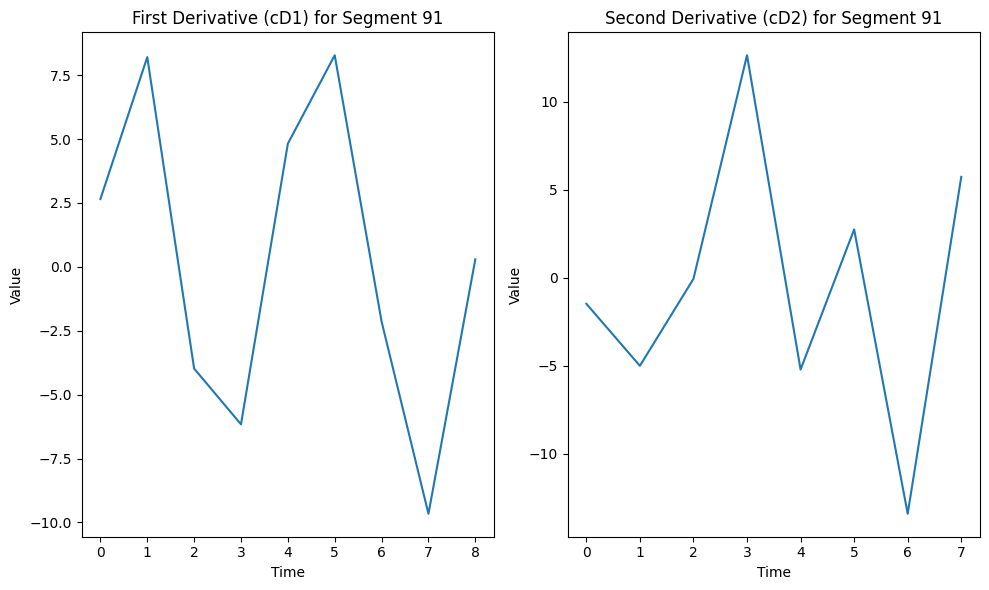

Segment 92:
  First derivative (cD1) length: 10, values: [ -1.19221207  -2.7659856   14.03039103  -4.1230669  -13.47328548
  10.55547434  -4.69040672   3.59216812  -8.5638684   18.57547664]
  Second derivative (cD2) length: 8, values: [  2.19994376   7.99988091  11.60980624  23.79284276  -3.94194732
   1.57566443  -4.21470069 -26.49696607]


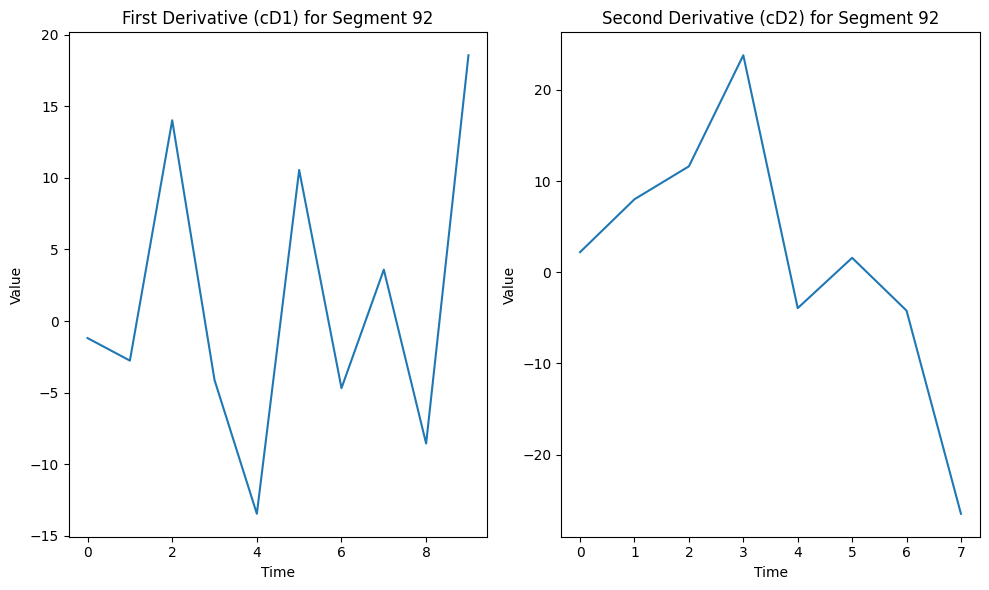

Segment 93:
  First derivative (cD1) length: 8, values: [-1.70417056 -5.43917344  0.37833289  1.46435571 -1.2468249   0.66253011
  0.51830447 -1.98517094]
  Second derivative (cD2) length: 7, values: [ 0.75362005  2.49860517 -0.75832557 -2.96352963  0.90250361  3.45871623
 -1.82439161]


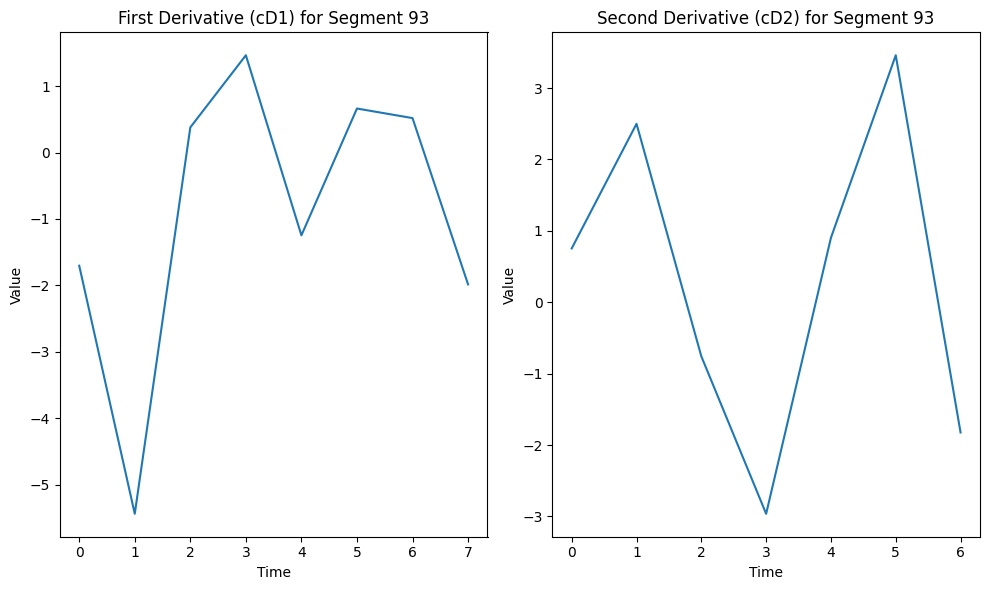

Segment 94:
  First derivative (cD1) length: 15, values: [-0.4634752  -1.67622354  1.86797005  1.64408645 -3.56426029 -0.49811979
  0.23908525  1.92132958 -0.25484584  2.09545794  2.24517264 -1.73929024
  1.00623156 -2.51174237 -1.25912039]
  Second derivative (cD2) length: 11, values: [-2.50985668 -7.58562109  7.74969403  4.46340588 -3.65760862  9.46918849
  1.81122908 -1.06146801  0.95200694 -5.26666725 -6.47892106]


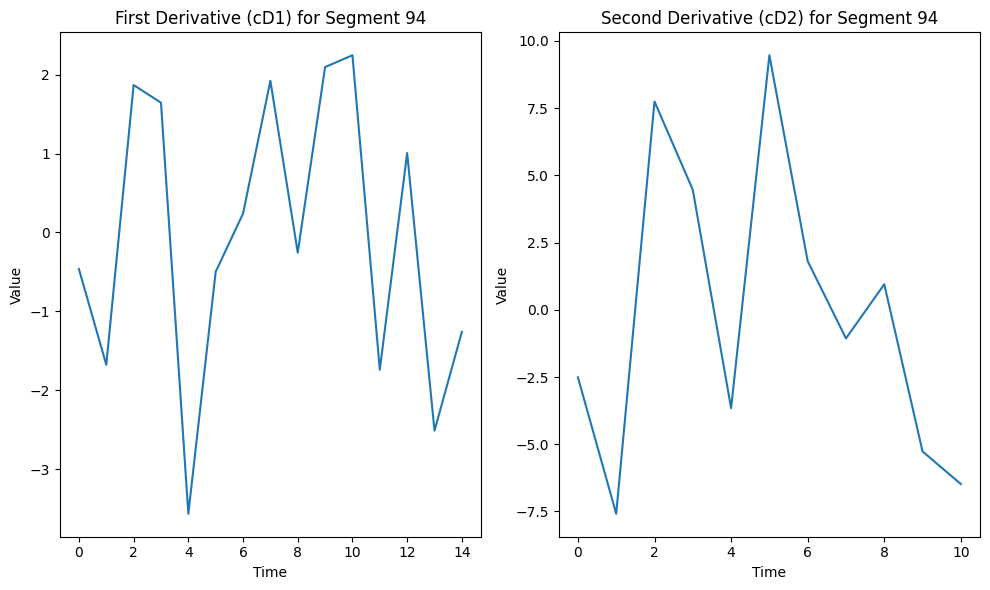

Segment 95:
  First derivative (cD1) length: 15, values: [ 1.1446935   2.95548812 -4.81443473  1.70180165 -1.5107078   7.03189277
 -6.84657188  0.05302745  1.66864693  4.24734877 -9.14436262  6.55839677
 -2.07142135 -2.99988472  9.10921552]
  Second derivative (cD2) length: 11, values: [ -4.15516149 -13.27503004   3.08877705  -4.23890702   4.26663421
   9.28725639  -4.73532358   6.56668387  -7.56436491   4.66661264
 -12.70625002]


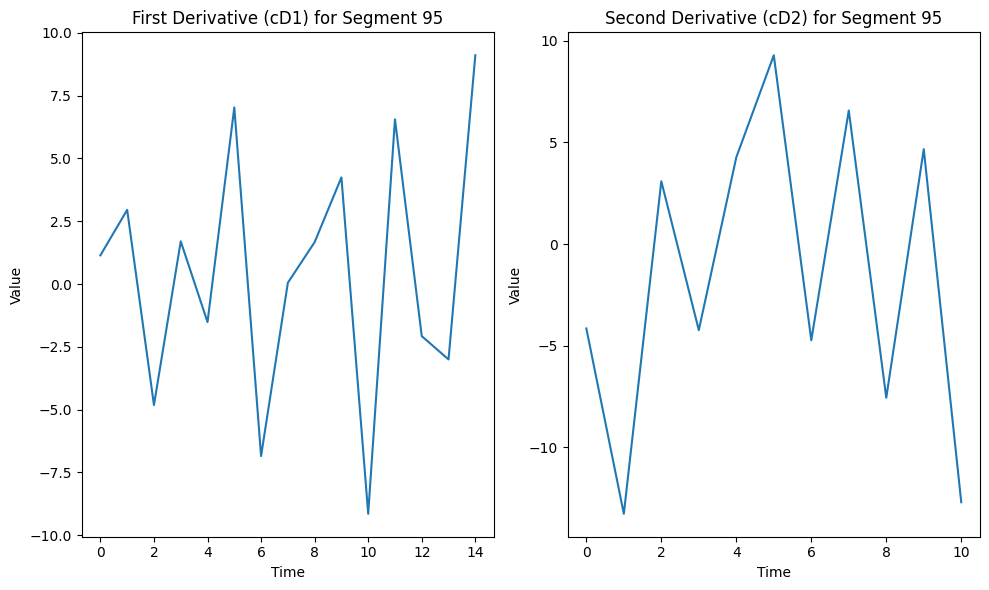

Segment 96:
  First derivative (cD1) length: 15, values: [  0.53375766   1.93201286   2.73057335   0.42357384  -2.90873465
  -3.59809289   3.04878792   0.61138078   2.40579104  -6.98374732
   9.50255984 -11.06037376  11.18914649 -10.10845614   9.7433275 ]
  Second derivative (cD2) length: 11, values: [ 0.18611003  0.71251343  1.7310386  -3.84957086  1.04050035 -0.25813561
  2.13185921 -0.57349023  1.59666824 -4.36311268  1.62025787]


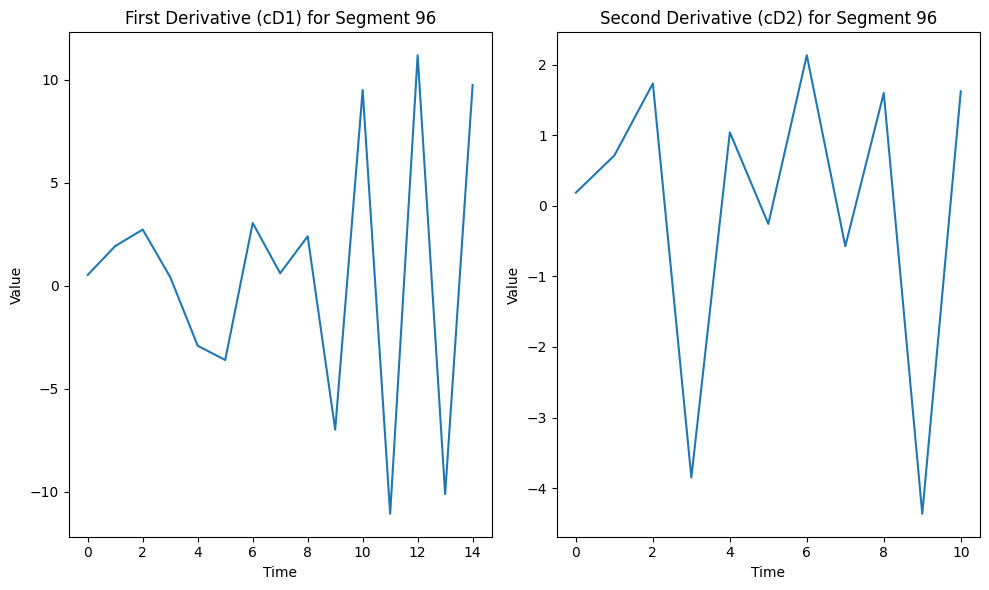

Segment 97:
  First derivative (cD1) length: 5, values: [1.05471187e-15 1.05471187e-15 1.05471187e-15 1.05471187e-15
 5.55111512e-17]
  Second derivative (cD2) length: 6, values: [-1.33226763e-15 -1.33226763e-15 -1.33226763e-15 -1.33226763e-15
 -1.33226763e-15 -6.66133815e-16]


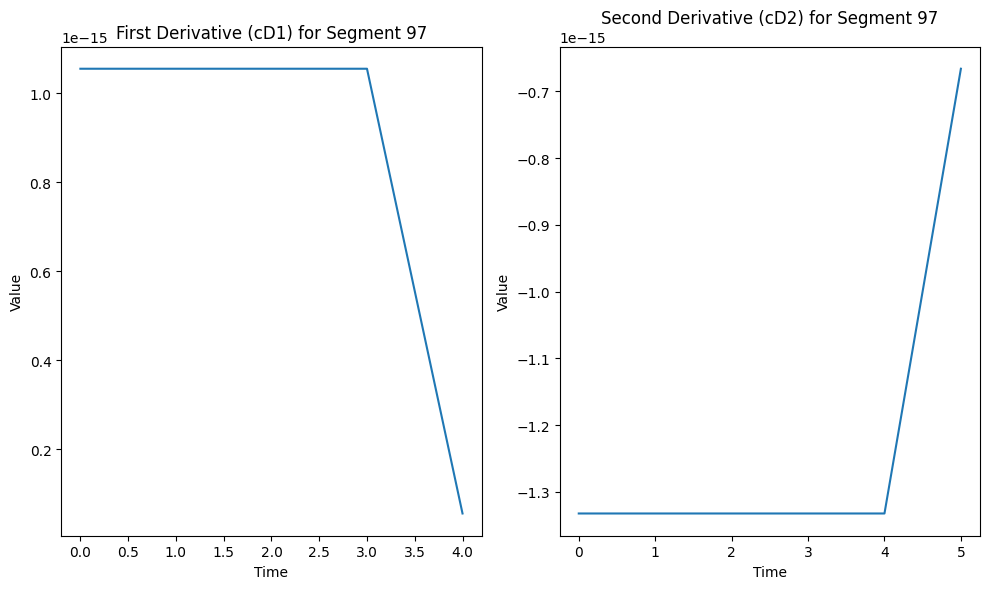

Segment 98:
  First derivative (cD1) length: 8, values: [ -4.85439763 -14.23332857  11.39267772  -3.70014434   2.5450833
  -1.30038697  -0.44274789  -6.36824285]
  Second derivative (cD2) length: 7, values: [  7.61801263  24.80056795  -0.36271588 -16.32555348   5.48330277
  15.92519528 -14.7251509 ]


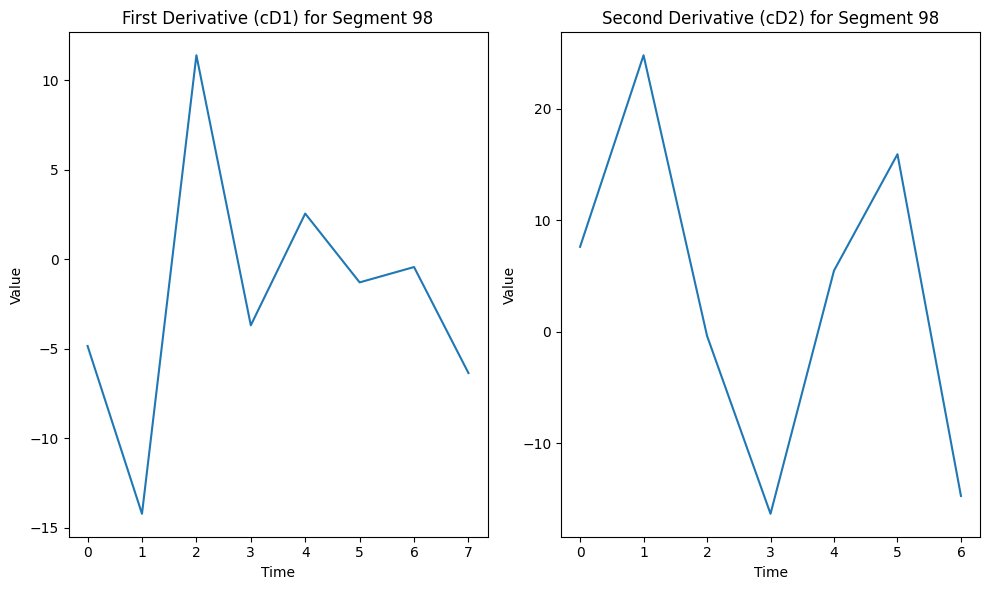

Segment 99:
  First derivative (cD1) length: 192, values: [ -2.13610652  -6.93032669   1.61057288  -1.16101672   6.4826748
   2.69624583  -1.36201105  -4.18172136 -10.39872254   7.06560364
  12.22255947  -6.44538298  -8.35680282   3.54468408   5.90167966
  -0.54538608  -1.98964968  -4.71491169   0.17700325   4.752691
   0.14353138  -2.33699481  -0.55827441   3.5871514    2.39636853
  -6.9390974   -0.83060402   4.89618775  -0.41062157   0.77270355
  -2.39025678  -1.3188244   -2.63716206   5.60005312   3.08224844
  -5.32823205  -0.39933128   0.21793554   3.68067028   1.48928769
  -8.65424282   8.26532727  -8.86018245   6.46981726   2.41272747
  -0.55440406  -6.3482021   -3.3984996    7.79140603   4.19076423
  -6.722468     2.52856724   0.38842743  -3.10985621  -0.88228648
   5.10227288   0.31894835  -6.93902975   3.50063061   1.52755511
   0.01994981   2.76792824  -5.89831127  -0.79526624   4.19770641
  -1.58926814   4.19688235  -6.98709872   3.11166384  -0.19581774
   0.91884917  -1.647

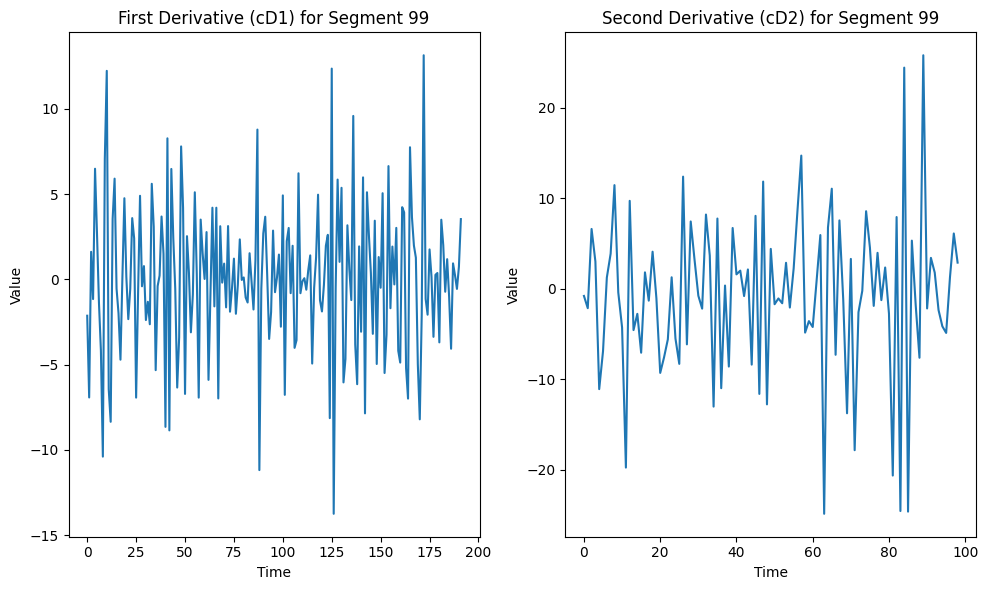

Segment 100:
  First derivative (cD1) length: 13, values: [ 1.52253044  4.6340105   1.3295599  -2.70854812  2.90630561 -0.82266421
 -2.61036104 -0.29167285  3.51521041 -1.31466678  0.58895037 -3.72142031
  2.32204979]
  Second derivative (cD2) length: 10, values: [ -3.74802093 -11.60312378  10.91154172  -8.38370672  -0.10159051
   6.70420071  -4.023289     2.42334768  -7.88970085   6.9665948 ]


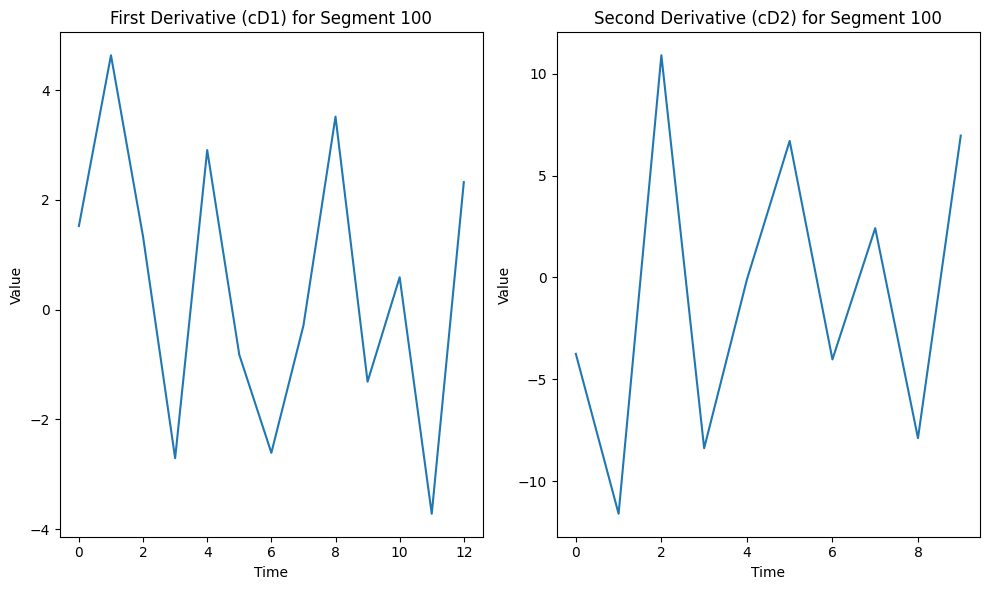

Segment 101:
  First derivative (cD1) length: 13, values: [-1.52827729 -4.0904183   3.87389442 -3.59003093  0.78961495  3.0017738
 -2.40590615  4.97253819 -5.87542168  0.17428774  1.33711835  4.2752963
 -5.33555209]
  Second derivative (cD2) length: 10, values: [  5.63680221  17.86284306  -6.95218836 -19.22954398   5.78736398
   5.26341366  -1.43840521   0.44184143  -7.72229733   3.2066374 ]


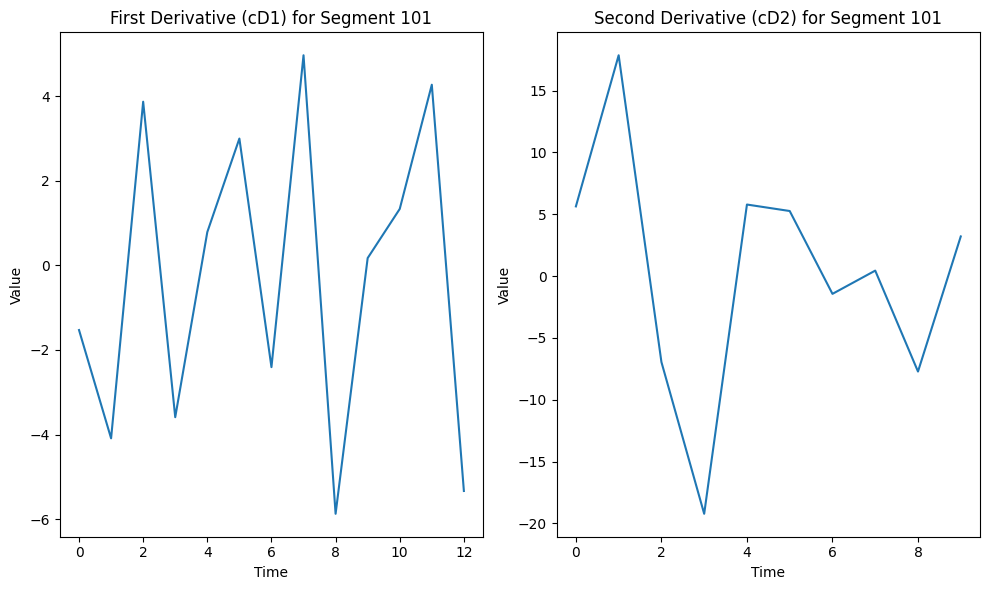

Segment 102:
  First derivative (cD1) length: 13, values: [ 1.77291146  5.5742301  -1.49642229 -1.70640024 -0.41890054  6.05430815
 -5.49887613  3.92990676 -0.97575229  0.39977447  0.71512593 -1.12829074
 -0.23899088]
  Second derivative (cD2) length: 10, values: [ -1.03736425  -3.44167043  -0.03993997 -10.88082409  -3.73614375
  19.74990509  -7.13968413   2.20959937 -18.98692938  13.84577616]


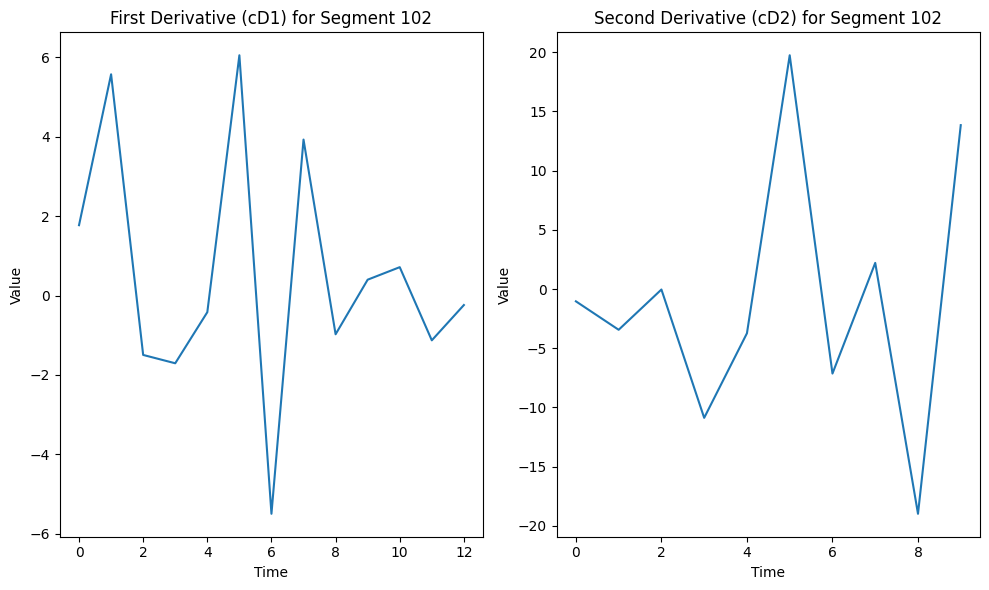

Segment 103:
  First derivative (cD1) length: 14, values: [-2.46616229 -7.61635334  2.17284505 -2.62020151  1.3743622   0.76131007
  3.17033388  0.59437039 -4.39699386 -3.95723786  1.93866434 -0.95764168
  5.37589599  2.58034861]
  Second derivative (cD2) length: 10, values: [ 2.53940084  8.25520396 -0.58113591 -9.078959   -5.70500576 12.48712664
  1.19310279  0.12054066 -5.9190877  -8.29792207]


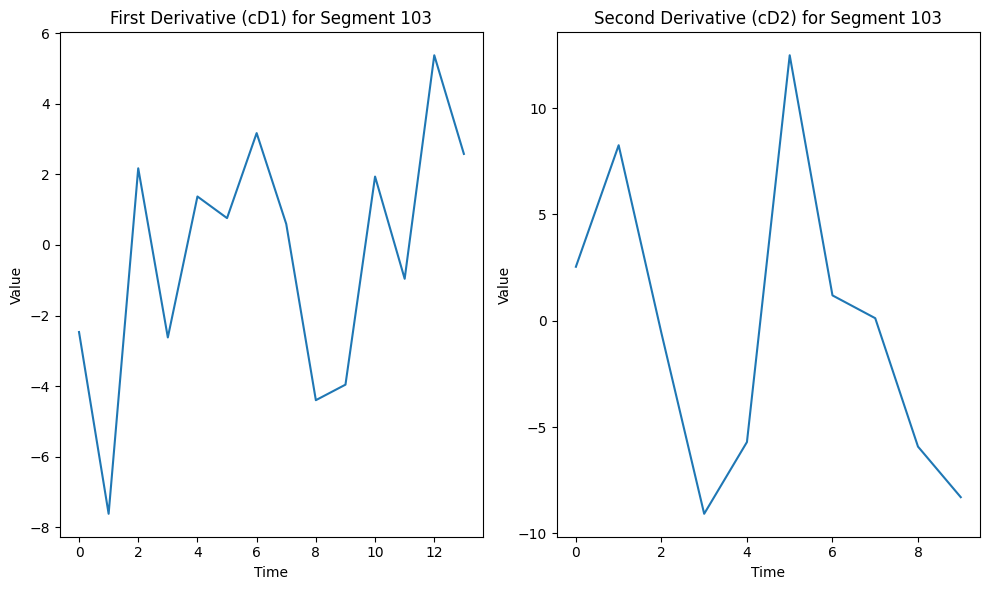

Segment 104:
  First derivative (cD1) length: 12, values: [ -0.61330479  -1.20050043   4.39957295   0.3983371    1.56607972
 -10.32958894   0.69973847   8.03722826   2.12879286  -5.51620253
  -6.40664186   4.81040423]
  Second derivative (cD2) length: 9, values: [ 4.56511425 14.42751289 -5.87224812 -0.03816065 -2.621002   -0.18382139
  0.03199395  1.52031246  1.33682566]


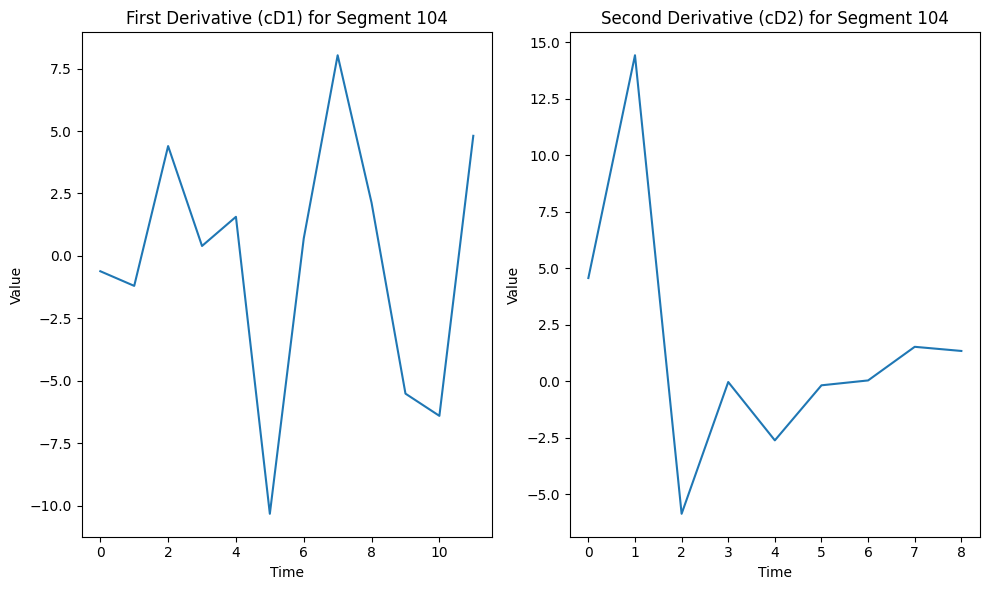

Segment 105:
  First derivative (cD1) length: 18, values: [ -1.25473747  -5.33320262 -10.2818184    3.70604274  15.28604155
  -6.77300797 -10.22513152  20.95317394 -25.87772941  19.39975377
  -9.55309403   3.03657557  10.22921984  -9.90649841  -3.10530727
   6.99973311   4.7494332  -12.79265235]
  Second derivative (cD2) length: 12, values: [ -5.41961674 -17.44662063   3.02330872  16.9993643   17.929996
 -12.77832759  -3.70448578  -8.74746363   4.41872614  -1.22870816
  -0.72120614  10.52023243]


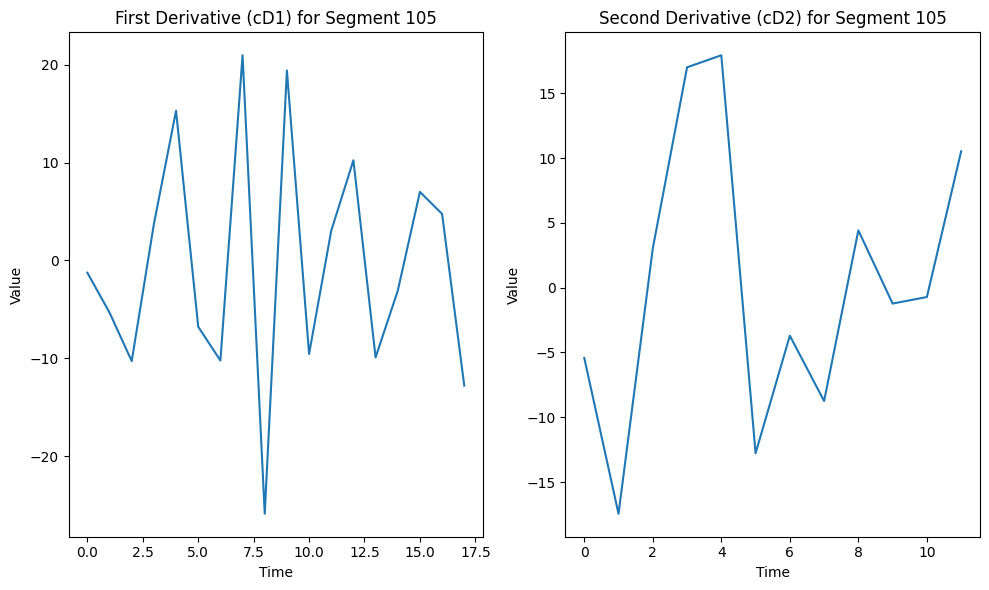

Segment 106:
  First derivative (cD1) length: 60, values: [ -0.69028249  -1.8905593    5.54416607  -3.00035804 -16.94573474
  16.10186301  14.51248491 -12.97782923  -2.02781675   1.32228095
  -7.49568546  12.74861394  -2.68619825  -5.73206784   0.88041119
   7.38198918 -10.30706685   2.61689872   1.55338266  -3.33948909
   5.37648943   3.31883959  -1.20226203  -1.08952176  -7.54350601
   2.37591926   1.02166174   9.43249541  -7.80644635  -4.01859174
   4.00449109   6.37313189  -9.77707325  -1.95675198   0.84863445
  10.91951297  -0.40125975  -9.20579844   6.61389287  -6.88883671
   1.66933203   6.98599506  -5.44537892  -6.05225305   5.90883136
   3.65407278   1.27475347  -9.03794569   1.13804483   8.21747647
  -1.55384041  -9.74477022  12.16617043  -7.27504255   2.1674181
  -2.13145003   1.20003765  -1.17968455   2.22392043   0.29826802]
  Second derivative (cD2) length: 33, values: [  0.18013472   1.13696783   5.84393989 -11.7111432   10.78436042
  12.50842653  10.96334636  -5.3929318

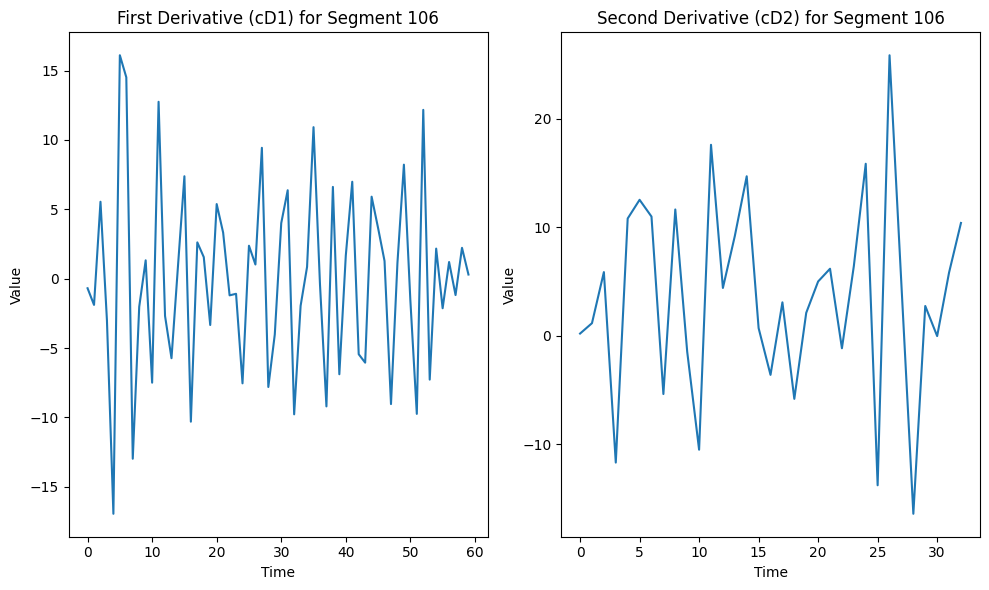

Segment 107:
  First derivative (cD1) length: 52, values: [  2.13293356   5.75705249  -9.41921385  -4.39600153   9.10371604
  -2.45829585   4.73381103  -2.54124148   0.43780825  -0.13467224
  -1.70496194   1.09833292   0.83891637 -10.36718846  14.66809632
  -7.80176707  10.09881245  -2.85359343 -15.41967344   7.42090026
  -0.56737885   4.83006215   2.99246256  -1.43072209   1.4460424
  -9.2451807    2.53134645   3.10589256   2.23223818  -3.89533681
   2.90266329  -5.99804706   4.15432083   0.0771294    0.73779038
  -1.28815697   0.62523741  -2.6393548   -0.07389434   8.08457188
  -6.61542477  -0.54131811   2.77423448   1.0192169   -3.31759918
   3.61630675  -8.87114343   2.21866035   7.05184094  -9.26347008
   2.84378797   6.3039165 ]
  Second derivative (cD2) length: 29, values: [ -5.24144744 -17.01145089   3.46716107  -1.8563027    5.19632734
   5.38795267   7.97069145  -6.59562139  -0.45252286  -2.30524795
   2.37429233   2.66378861 -10.13484721   0.85804688 -21.45095559
  13.737306

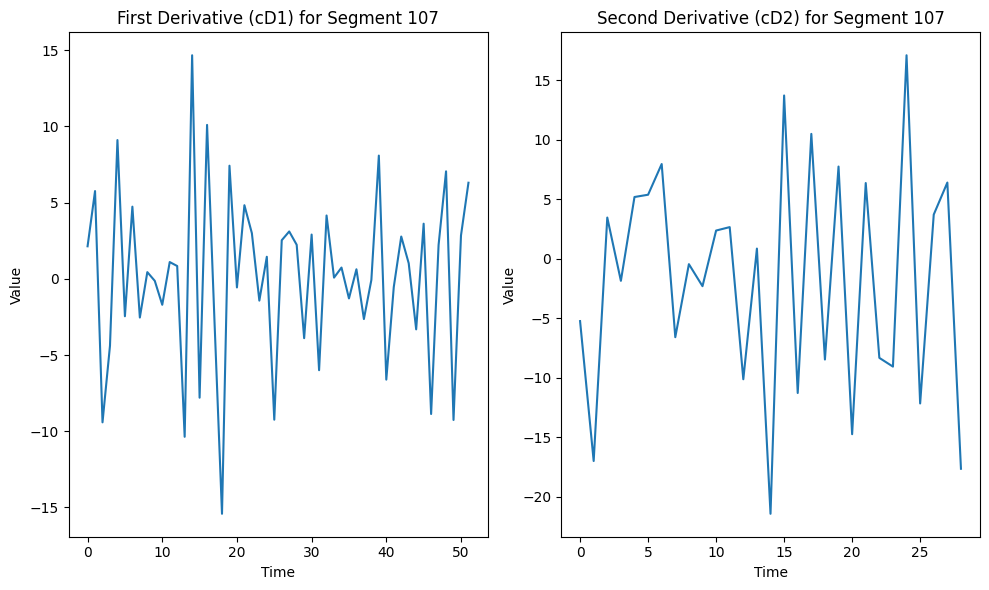

Segment 108:
  First derivative (cD1) length: 13, values: [  0.17695299   1.4220696    8.2459485  -10.91345807   3.47527566
  -0.3133587    2.22503264  -2.37695913   1.95134284  -1.9642998
   1.06709974   1.50154977  -3.31638118]
  Second derivative (cD2) length: 10, values: [  2.97185042   9.86358818   6.55977973  16.33357453   3.53787187
  15.15748776 -33.85863435  38.67406    -28.56461357   0.1758089 ]


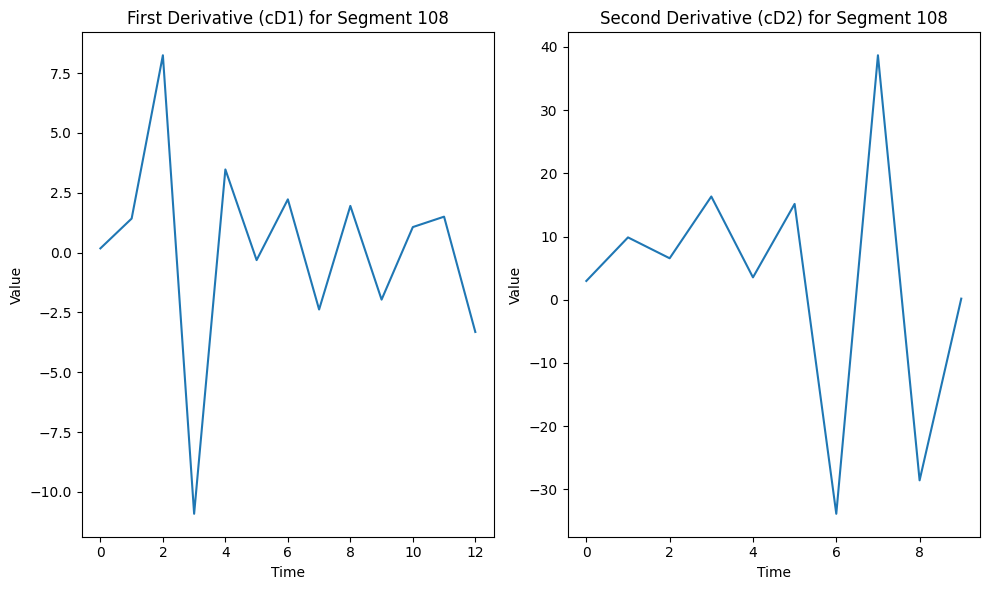

Segment 109:
  First derivative (cD1) length: 18, values: [-0.81287429 -3.16794865 -2.50111515  6.61293215 -8.58591737 10.96502572
 -3.97769402 -1.58126487  0.61115742  0.67883571 -2.32228967 -0.23267858
  3.24802146 -3.58765524  1.07680899 -0.12584153 -0.62960348  3.5719203 ]
  Second derivative (cD2) length: 12, values: [ -3.2572382  -10.1934661    2.32200271 -10.73743501  -8.02954952
  -7.71851696   2.35914796  -8.66136887  -4.34535623   1.80363687
   6.22470354   6.44116719]


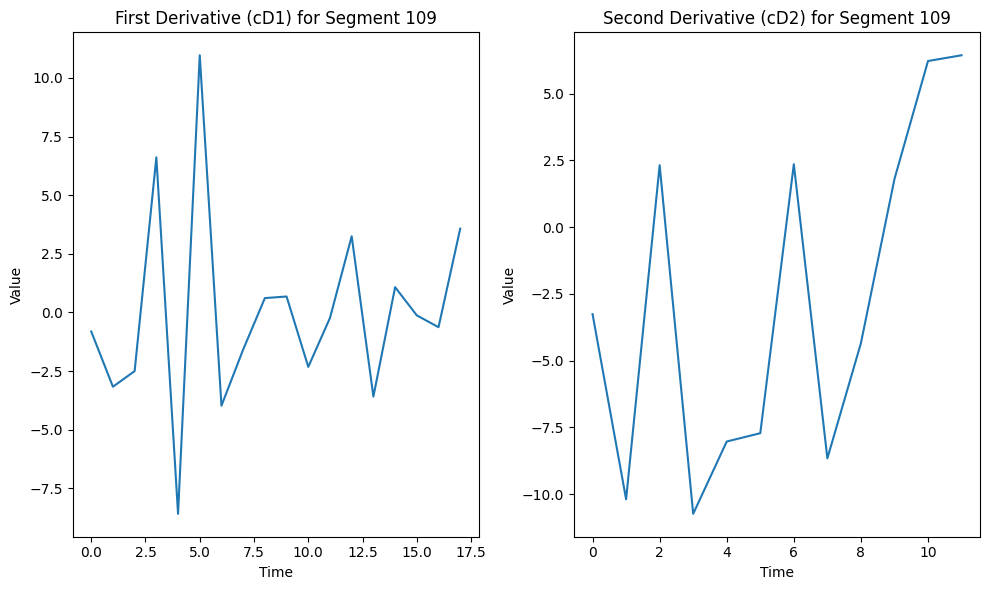

Segment 110:
  First derivative (cD1) length: 19, values: [ -1.10014824  -2.54905134   7.83433567  -3.08295622  -1.06367149
   3.75616342  -5.5372779    8.90259532 -14.19889258  11.92771898
  -8.85651719   7.56511913  -6.41286314  11.91764304 -16.43183866
   8.99981151  -6.71649934  13.95372754 -13.25915299]
  Second derivative (cD2) length: 13, values: [  4.67359849  15.12171287  -0.88953096  -0.27249781  12.88307915
   6.83966811  14.12154968 -15.49771462  -5.06705879   2.54771294
  -2.82738805  12.2340196    7.142144  ]


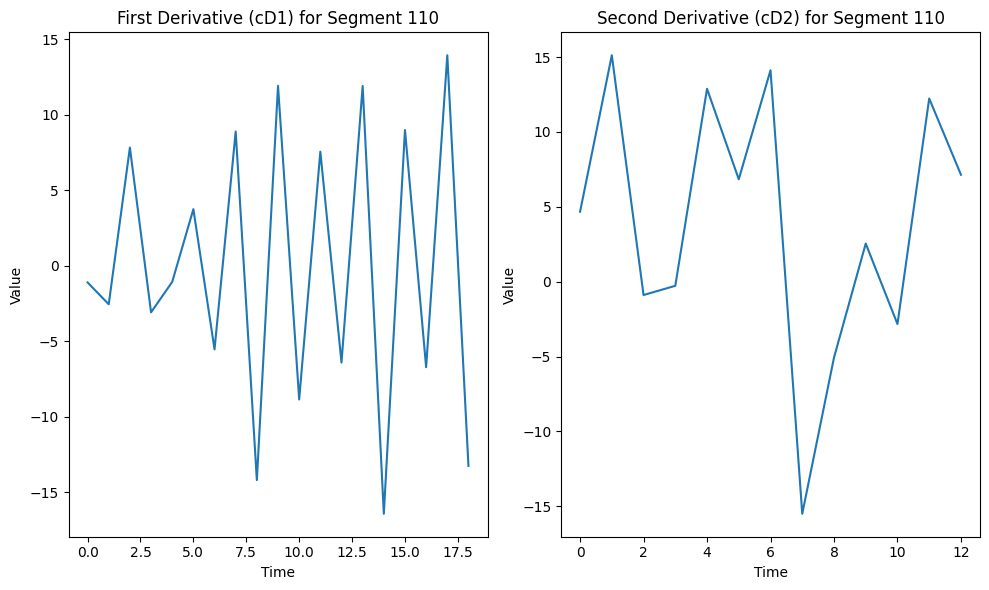

Segment 111:
  First derivative (cD1) length: 37, values: [-1.50647896 -5.32128252  1.13443483 -1.22325332  1.12928054 -1.63335107
 -0.7802964   1.9538986   6.76836495 -6.50937153 -3.56207822  1.88108507
  3.94414396 -3.56374098 -0.35455165  2.45372353  1.1574675  -2.86688184
  1.99482025 -0.47150357 -2.3614592   0.53086081  1.90758068  1.64688763
 -4.76358675  0.33509812  4.49134286 -0.84969869 -3.30325054  0.54546687
  1.48250941 -1.287159    2.48595961 -1.80157441  0.65174072  0.87705322
 -2.70872504]
  Second derivative (cD2) length: 22, values: [ -4.20626144 -12.7544709   13.74189078   9.65565354   9.6238954
   0.51293092   1.46505259   7.35386595 -23.65270051  19.56219387
  -5.53935374   1.90331258  -5.38253443  -0.7119464    0.46565986
  -6.29226778  -6.32179039   4.34380876  -6.05052104   7.17100278
  -5.21190644  10.459276  ]


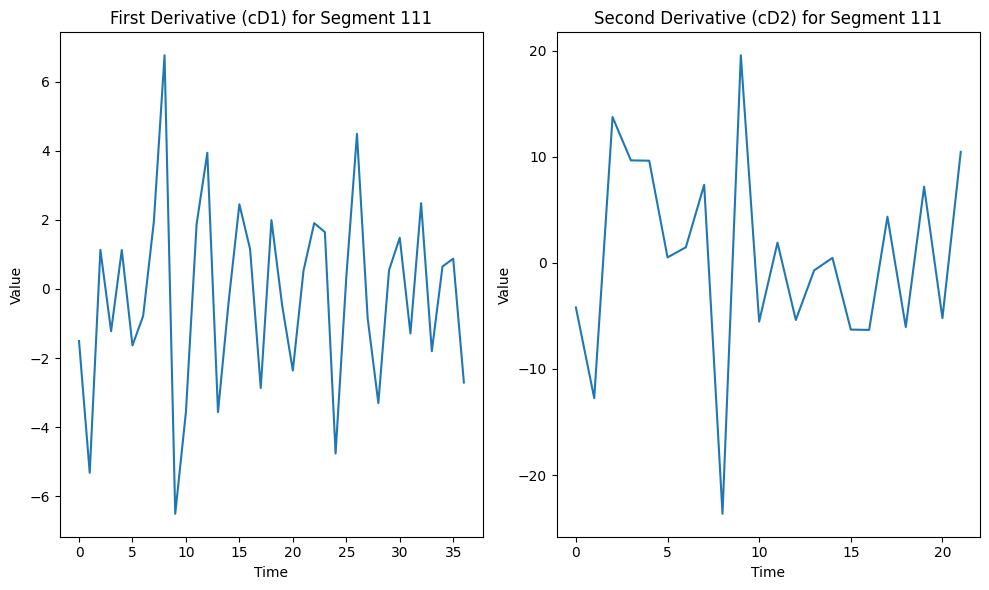

Segment 112:
  First derivative (cD1) length: 15, values: [  4.46989915  11.89042379 -11.39807387   3.44114439   1.24894228
   1.9600529   -3.8634849    3.27846126   1.88878962  -3.25905567
  -0.33830368  -0.47693484   0.10941727   0.69653342   0.78384448]
  Second derivative (cD2) length: 11, values: [-1.74023827e+01 -5.49879758e+01  2.55328752e+01 -1.17466695e+00
  6.32580764e+00 -2.04625239e+00 -9.07182979e-03 -3.94189492e+00
  4.07756937e+00 -8.20204216e-01 -5.56529594e-01]


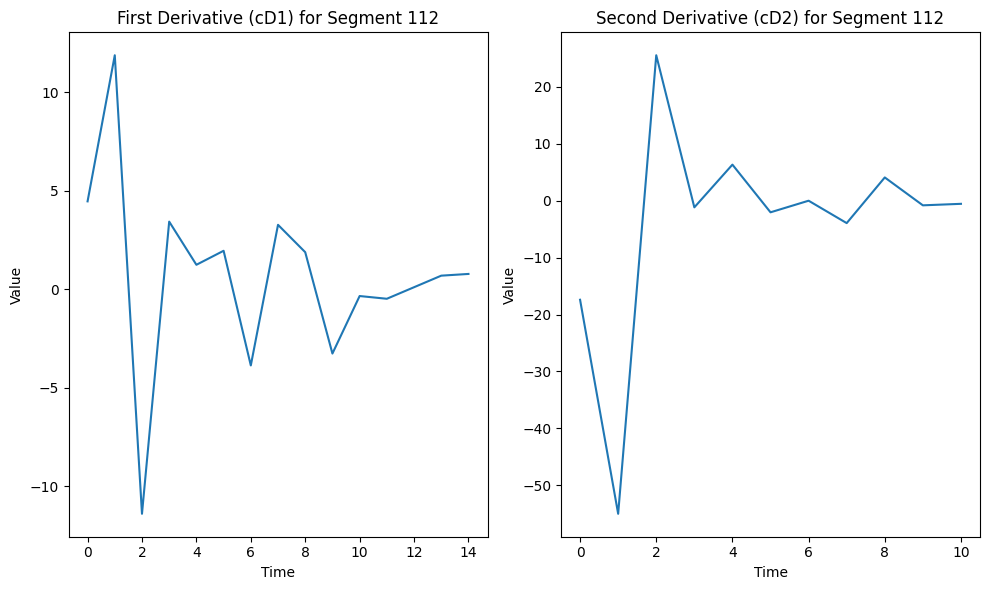

Segment 113:
  First derivative (cD1) length: 50, values: [-2.10396604 -5.82407781  6.41342931 -3.48591871  4.04135225 -4.02370625
  0.25746289 -1.03638318  1.86714758  0.26774671  1.65550075 -4.81389055
  2.46428083 -0.6809323   0.98260027  0.4045376   0.4296871  -0.30779241
  0.57645294 -3.85868649  3.44012495 -2.68418784 -0.07710811  2.57705476
  2.79725673 -1.96589202  0.95791712 -5.8516974  -2.77770712  4.97799691
  7.9305886  -2.71495549 -6.4825066  -2.95310511  3.37337365  4.19588311
  1.63195938 -3.16120731 -3.49884368  7.74168003 -6.29444201 -2.71314127
  2.63504507  4.0702256  -3.56476242  3.75073902 -3.49338633  3.04693955
 -3.35366879  3.86512428]
  Second derivative (cD2) length: 28, values: [  5.51693478  17.69850398  -2.94764955  -0.63421193  -8.11519224
   4.81059291   0.12891494   4.75834762  -5.43888015   3.87002987
  18.80100094  -1.44291175  -2.82439882  -5.4387054    1.77921041
  -7.6751149    0.15073329   1.02769506   0.98187229  -3.3328457
 -12.31001492  -1.51672

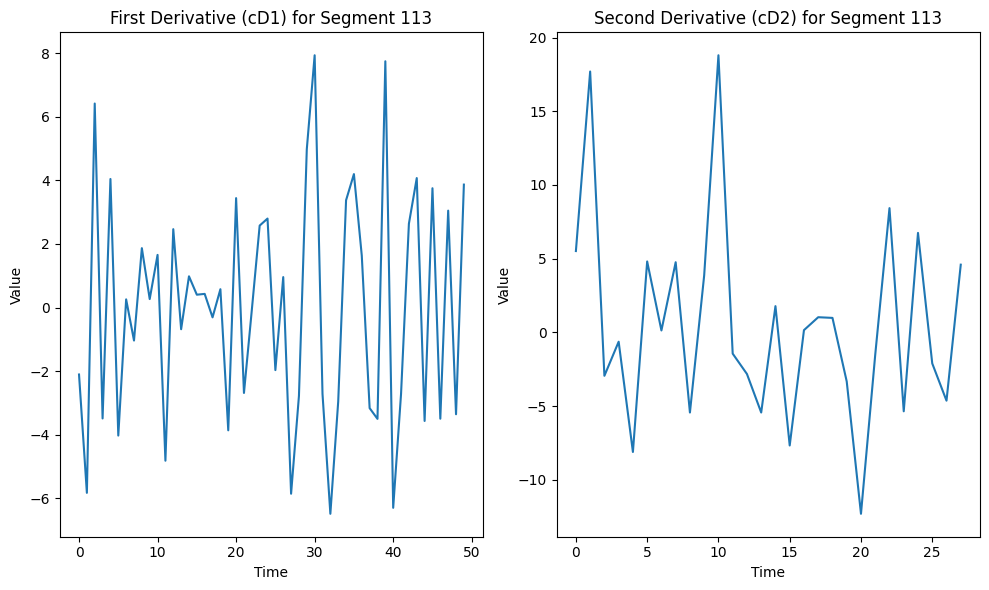

Segment 114:
  First derivative (cD1) length: 13, values: [ 0.20836474  0.7868159  -0.65626251 -2.45350174  2.6473263   4.05474236
 -2.50013111  0.35367038 -3.41842345  1.48705983 -0.76389671  3.34715283
 -0.66691459]
  Second derivative (cD2) length: 10, values: [ 1.22611532  3.74725558 -2.80410904 -5.53190235 -2.64825109  6.96815038
 -2.36538714  0.57800189 -5.88812492  6.16207066]


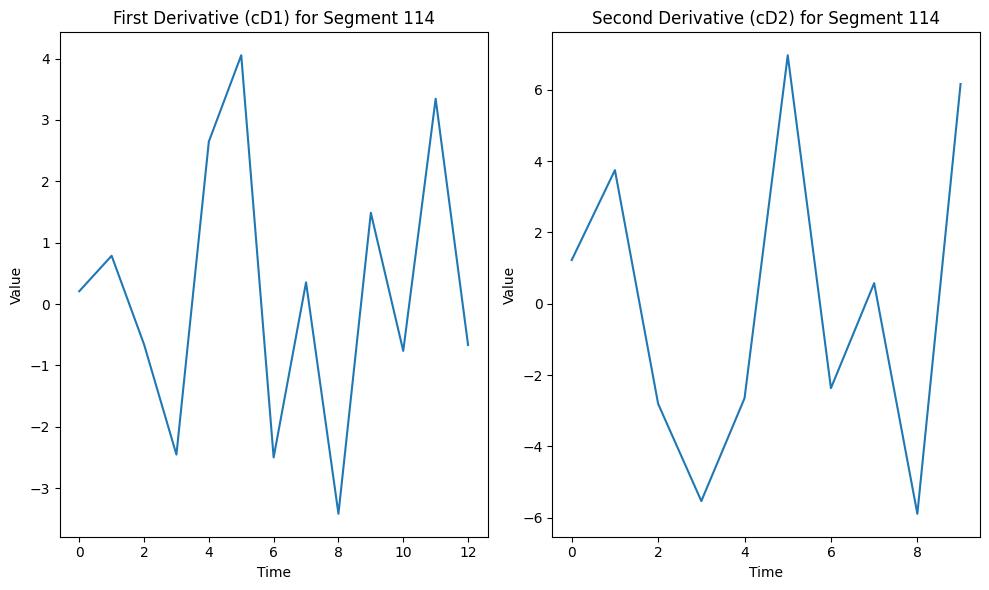

Segment 115:
  First derivative (cD1) length: 8, values: [-0.21819088 -0.26206991  3.14655659 -0.2957817  -3.83915041  1.32149072
  3.65532406 -2.43195889]
  Second derivative (cD2) length: 7, values: [ 2.28648497  7.31989718 -2.2261178   2.81843723 -1.30182858 -0.936852
 -0.5212737 ]


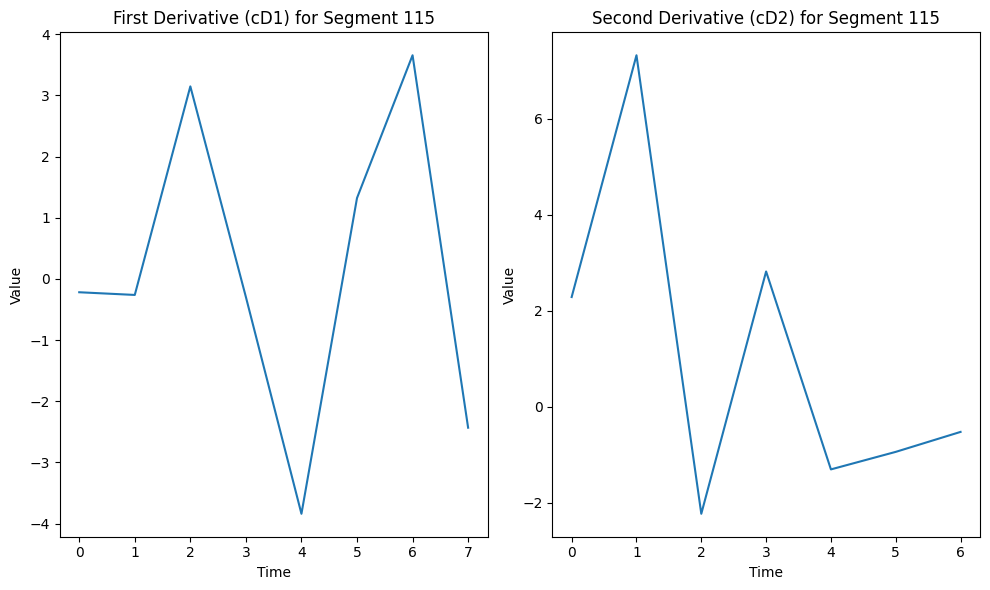

Segment 116:
  First derivative (cD1) length: 45, values: [ -1.88060163  -5.47878536   8.40098289  -0.23328559  -6.02507168
   0.26096607   1.16788285   2.9626926   -6.96948555   1.50879075
   8.82883741  -1.72604764  -7.08561662  -0.45494393   5.2312232
  -4.8136155   -0.80404817   5.46720215   4.56550353  -3.42303884
  -8.30478301   0.21437901  10.119824    -7.14050486   3.60985249
  -4.41786801   7.03717018   0.28326192  -6.9692511    2.84324182
  -3.90609366  -8.41511218  28.49635804 -18.44983778   1.36756822
  -1.31951662   3.84030739  -5.11817782   8.68977738  -6.51470986
  -0.55181267  -2.61274158   0.68086385   3.36373637   0.94516641]
  Second derivative (cD2) length: 26, values: [  1.08846528   4.145216     7.83687466   9.91760042   0.12842606
  -1.42147984  -8.01692306   5.89266928   4.28707127   0.32457188
  -0.17274425 -14.2217741   -4.80994658  -3.44872637  12.35756034
   7.71129652  12.59787266 -10.45797975  -2.33574897   1.26898307
  -2.7561023   -8.57837491  -1.5807851

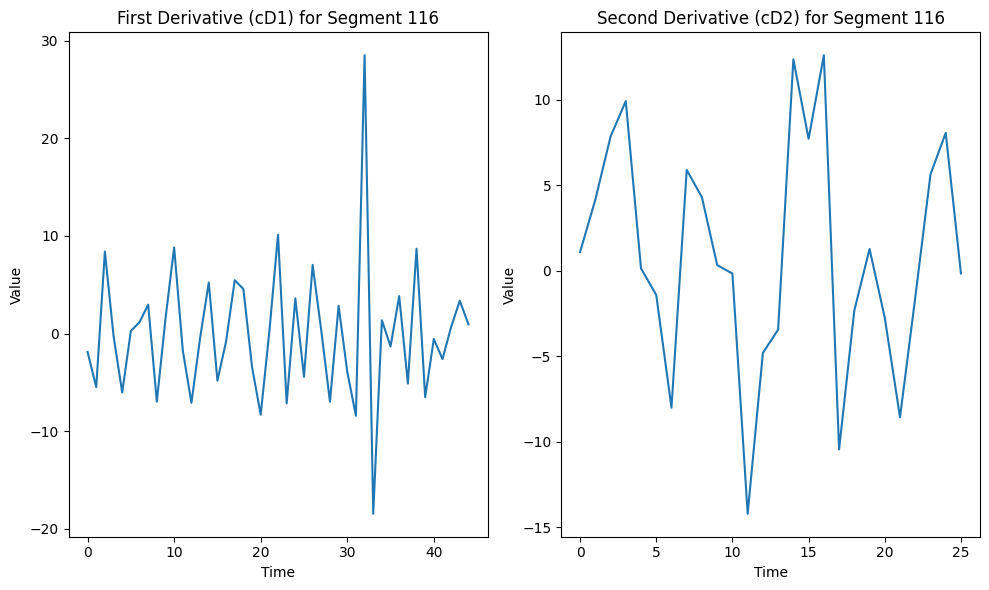

Segment 117:
  First derivative (cD1) length: 16, values: [ 2.80997596  7.44607047 -4.40603424 -3.37651714  1.76097602  1.15052135
  1.62086211  0.26927915 -5.07535739  1.63453496  4.42115918 -1.40491474
  3.26494262 -3.86133991  1.03963881 -5.03254698]
  Second derivative (cD2) length: 11, values: [-12.73013871 -39.83423911  26.00724415 -20.12924015  12.78633499
 -13.05896964  10.98415032   5.07689216  -1.3929071   -9.3511913
  -4.77076309]


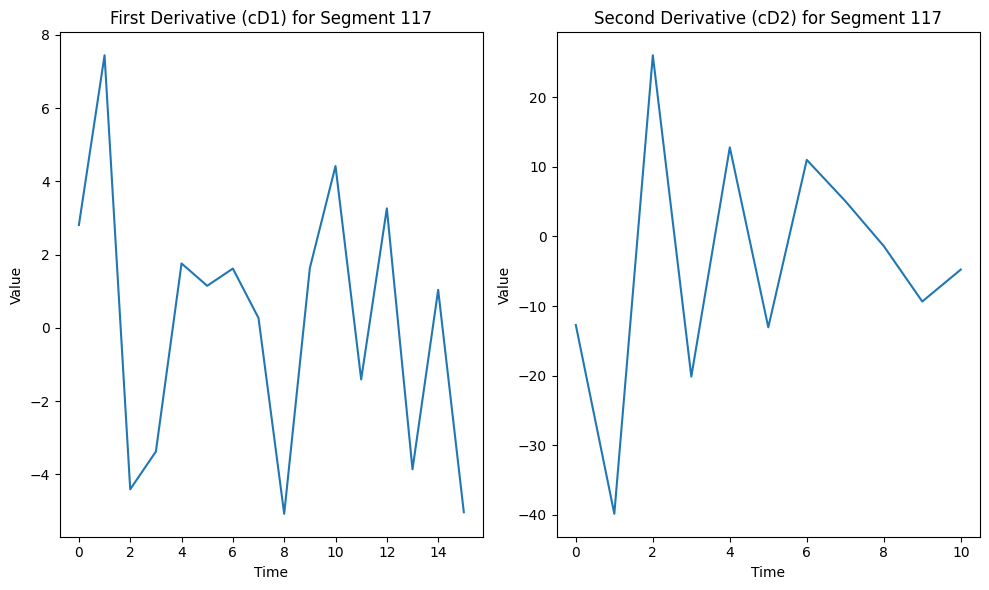

Segment 118:
  First derivative (cD1) length: 16, values: [-1.67088158 -3.74613309  8.42711761 -3.0375459  -1.38418336  1.14870893
  0.83152572 -1.71490414 -0.32558288 -0.60312766  2.40683037 -0.15099555
 -0.32311218  0.21901784  0.34254023 -0.85353299]
  Second derivative (cD2) length: 11, values: [ 10.26310542  32.4721439  -13.70069935  -1.75142766   1.63672077
  -0.33024042   0.58966154  -1.50981712   0.77454115   1.66547144
  -1.8506464 ]


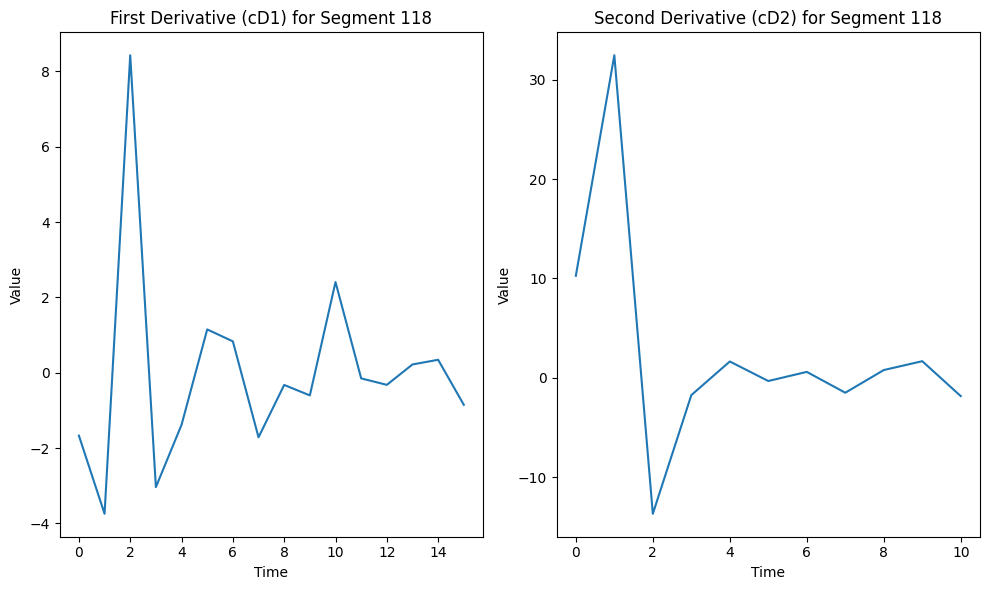

Segment 119:
  First derivative (cD1) length: 49, values: [ 2.04092932e+00  5.32374219e+00 -2.51363950e+00 -4.42709173e+00
  2.51250668e+00 -8.89243918e-01  1.89063298e+00  2.05737790e-03
  1.28608005e+00 -2.08828293e+00  7.69033458e-01 -3.08626341e-01
  7.58267722e-01 -4.10001152e+00  5.29540899e+00 -4.16261556e+00
  2.59667065e+00  1.65187240e-01 -3.48816181e+00  2.19620109e+00
  5.70727891e+00 -7.54379967e+00  2.72065414e+00  1.44076225e+00
 -5.83946153e-01 -1.55202751e+00 -3.50523032e+00  6.07197512e+00
 -5.88952726e-01 -1.46146565e+01  2.79733114e+01 -1.70601951e+01
 -2.79131825e+00  8.52850977e+00 -5.17227289e+00  1.92866310e+00
 -1.59089275e+00  1.45285111e+00 -1.22640315e+00  3.33929693e+00
 -2.46403003e+00 -4.57706391e-01  5.43963699e-01  2.11381800e+00
 -1.51330771e+00 -8.14448155e-02  3.24765550e-01  8.66685547e-01
 -2.60138883e+00]
  Second derivative (cD2) length: 28, values: [-10.41280269 -32.46880682  23.51211503 -27.1154813   22.05730077
  -3.46915677   2.66750204  -3.9

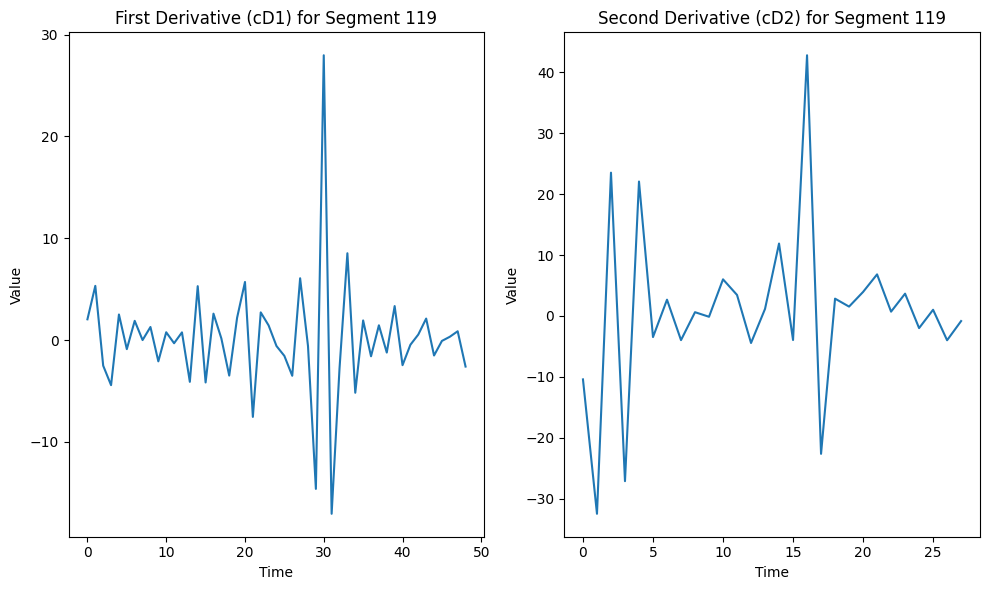

In [57]:
for segment in time_segments:
    start_idx = segment[0]
    end_idx = segment[-1]

    signal_segment = signal[start_idx:end_idx]

    wavelet = 'db4'
    level = 4

    if len(signal_segment) == 0:
        print(f"Segment from index {start_idx} to {end_idx} is empty. Skipping.")
        continue

    coeffs = pywt.wavedec(signal_segment, wavelet, level=level)

    first_derivative = coeffs[-2]
    second_derivative = coeffs[-3]

    first_derivatives.append(first_derivative)
    second_derivatives.append(second_derivative)

for i, (first, second) in enumerate(zip(first_derivatives, second_derivatives), 1):
    print(f"Segment {i}:")
    print(f"  First derivative (cD1) length: {len(first)}, values: {first}")
    print(f"  Second derivative (cD2) length: {len(second)}, values: {second}")

    plt.figure(figsize=(10, 6))

    plt.subplot(1, 2, 1)
    plt.plot(first)
    plt.title(f'First Derivative (cD1) for Segment {i}')
    plt.xlabel('Time')
    plt.ylabel('Value')

    plt.subplot(1, 2, 2)
    plt.plot(second)
    plt.title(f'Second Derivative (cD2) for Segment {i}')
    plt.xlabel('Time')
    plt.ylabel('Value')

    plt.tight_layout()
    plt.show()

In [58]:
first_derivative_threshold = 5
second_derivative_threshold = 2

In [59]:
significant_points_by_segment = []

In [60]:
for i, (first, second) in enumerate(zip(first_derivatives, second_derivatives), 1):
    significant_points = []

    for idx, (fd, sd) in enumerate(zip(first, second)):
        if abs(fd) > first_derivative_threshold and abs(sd) > second_derivative_threshold:
            significant_points.append(idx)

    significant_points_by_segment.append({
        'segment': i,
        'significant_points': significant_points,
        'first_derivative_values': [first[idx] for idx in significant_points],
        'second_derivative_values': [second[idx] for idx in significant_points]
    })

In [61]:
for segment_info in significant_points_by_segment:
    segment_id = segment_info['segment']
    points = segment_info['significant_points']
    fd_values = segment_info['first_derivative_values']
    sd_values = segment_info['second_derivative_values']

    print(f"\nSegment {segment_id} Significant Points:")
    for j, idx in enumerate(points):
        print(f"  Time index: {idx}, First Derivative: {fd_values[j]}, Second Derivative: {sd_values[j]}")



Segment 1 Significant Points:

Segment 2 Significant Points:
  Time index: 1, First Derivative: -10.132169106722957, Second Derivative: -3.2791044412206976
  Time index: 3, First Derivative: 5.606779983052002, Second Derivative: -3.184739265303557

Segment 3 Significant Points:

Segment 4 Significant Points:
  Time index: 15, First Derivative: 5.969919867374781, Second Derivative: 2.06524154574284

Segment 5 Significant Points:
  Time index: 3, First Derivative: -16.299160918896764, Second Derivative: 18.01071017558
  Time index: 8, First Derivative: -7.13808453501296, Second Derivative: -9.702393675601407
  Time index: 9, First Derivative: 8.323712149609785, Second Derivative: -4.954298162119631
  Time index: 12, First Derivative: -12.271715802557956, Second Derivative: -13.321960736765723
  Time index: 14, First Derivative: 10.761514422177678, Second Derivative: -2.1152082586618284
  Time index: 15, First Derivative: 14.222588749757765, Second Derivative: 5.995514131174909
  Time in

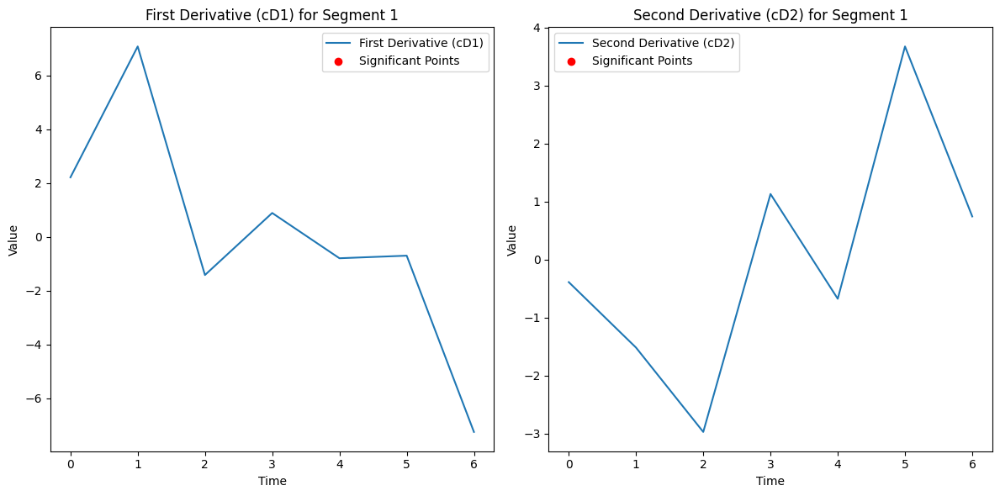

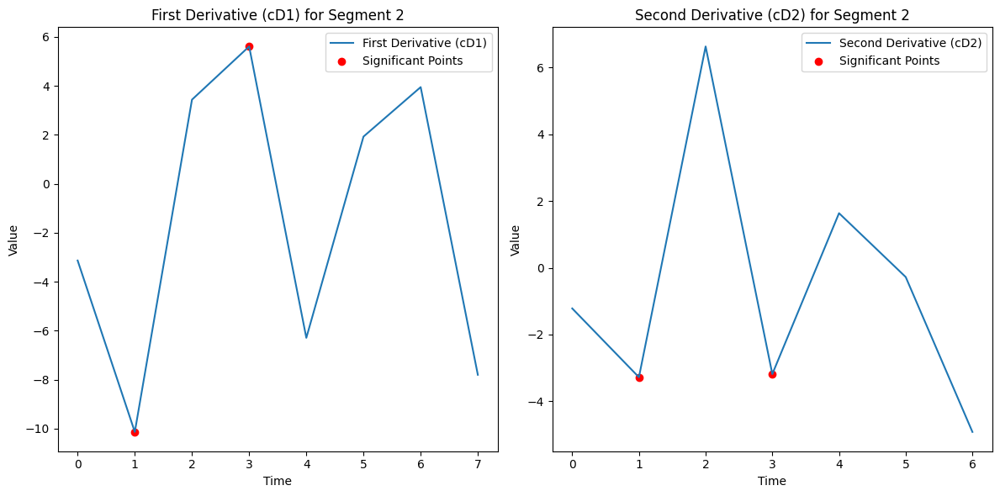

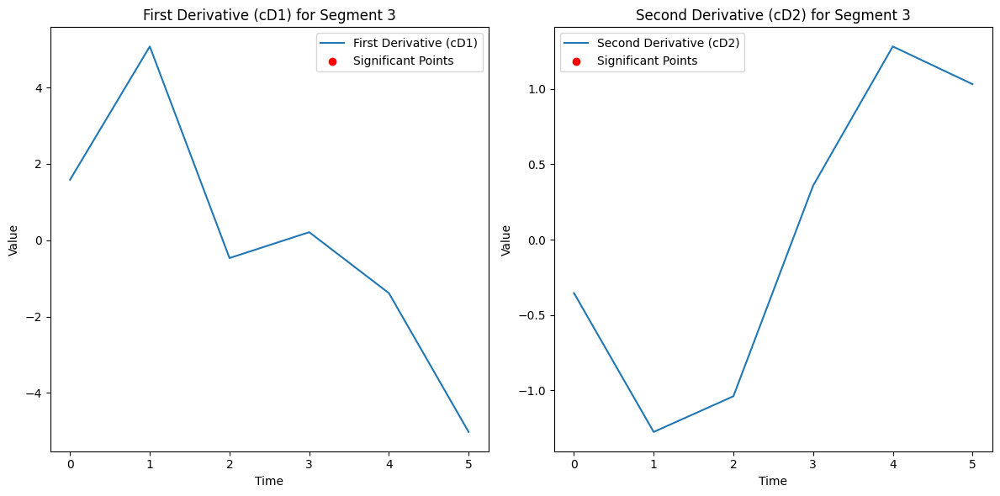

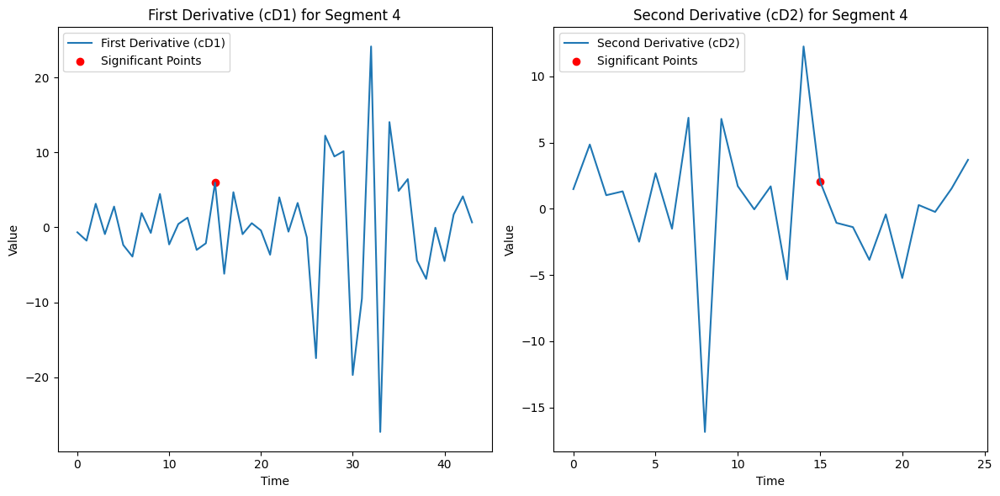

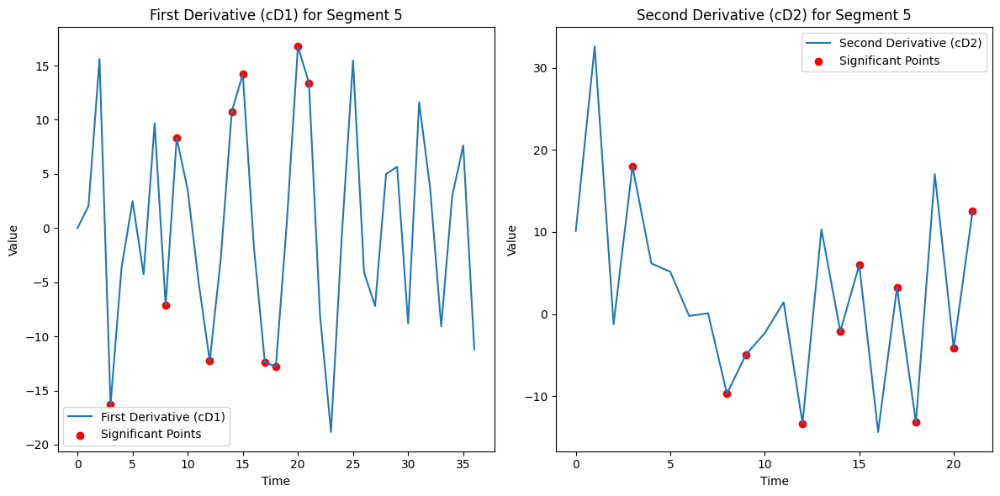

...

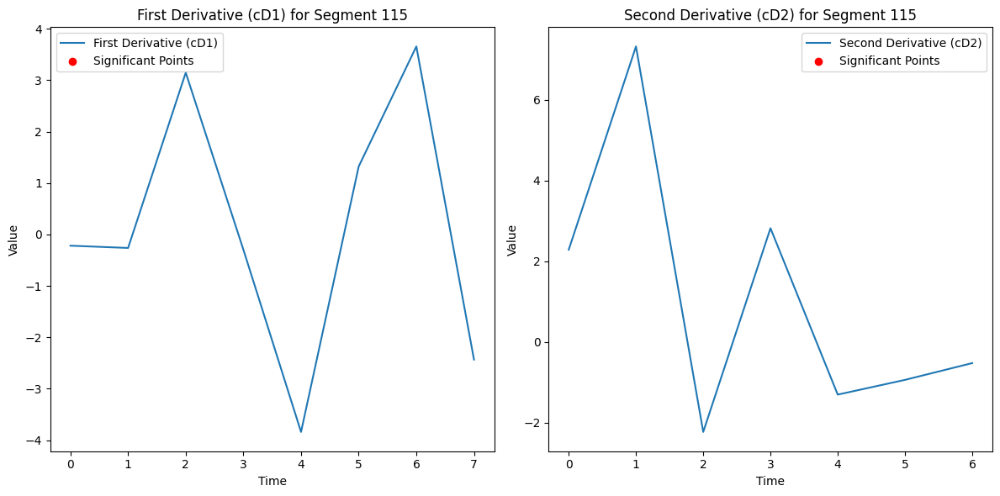

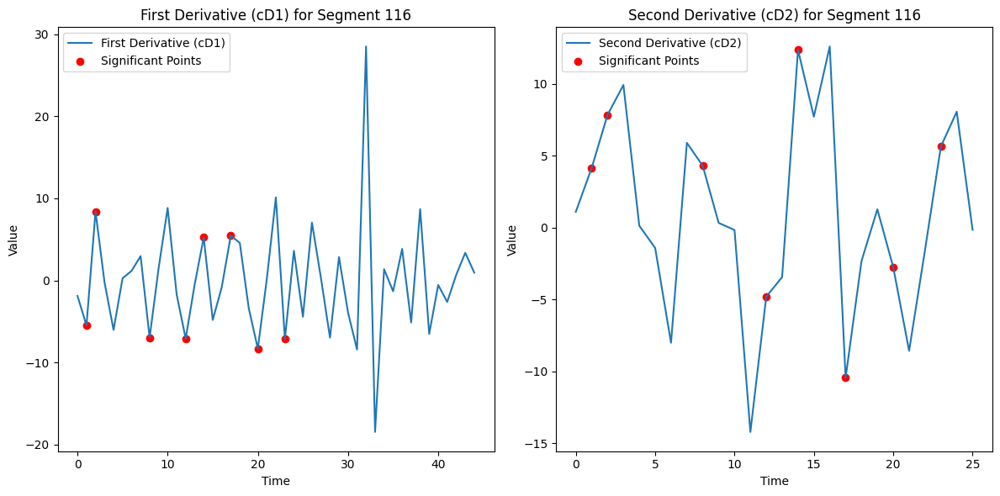

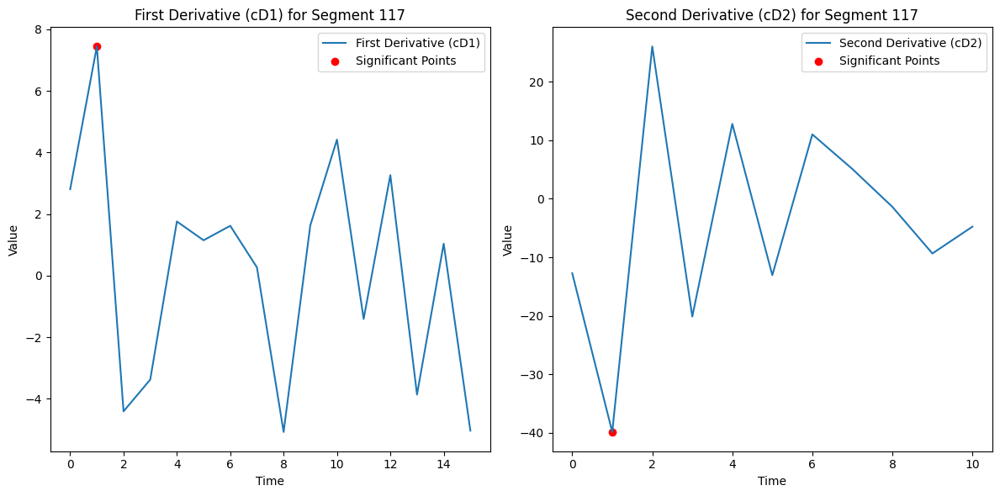

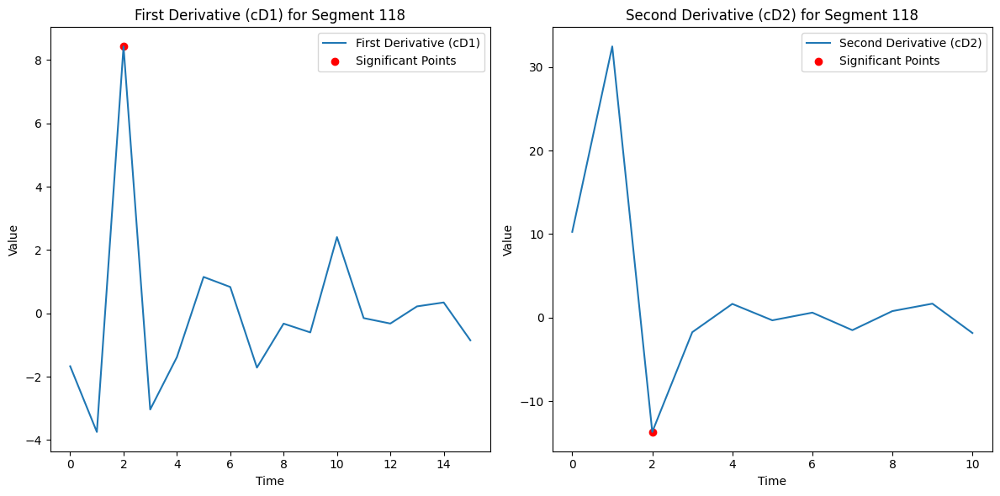

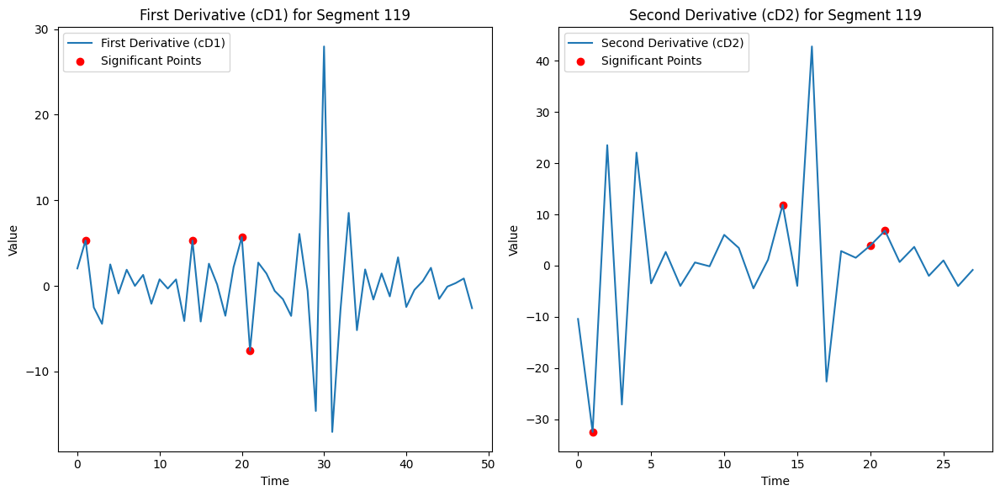

In [62]:
for i, (first, second) in enumerate(zip(first_derivatives, second_derivatives), 1):

    segment_significant_points = [point for seg in significant_points_by_segment if seg['segment'] == i for point in seg['significant_points']]

    plt.figure(figsize=(12, 6))

    plt.subplot(1, 2, 1)
    plt.plot(first, label='First Derivative (cD1)')
    plt.scatter(segment_significant_points, [first[idx] for idx in segment_significant_points], color='red', label='Significant Points')
    plt.title(f'First Derivative (cD1) for Segment {i}')
    plt.xlabel('Time')
    plt.ylabel('Value')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(second, label='Second Derivative (cD2)')
    plt.scatter(segment_significant_points, [second[idx] for idx in segment_significant_points], color='red', label='Significant Points')
    plt.title(f'Second Derivative (cD2) for Segment {i}')
    plt.xlabel('Time')
    plt.ylabel('Value')
    plt.legend()

    plt.tight_layout()
    plt.show()

In [63]:
significant_points_count = []

for i, (first, second) in enumerate(zip(first_derivatives, second_derivatives), 1):

    segment_significant_points = [point for seg in significant_points_by_segment if seg['segment'] == i for point in seg['significant_points']]

    count = len(segment_significant_points)
    significant_points_count.append(count)

for idx, count in enumerate(significant_points_count, 1):
    print(f"Segment {idx} has {count} significant points.")

Segment 1 has 0 significant points.
Segment 2 has 2 significant points.
Segment 3 has 0 significant points.
Segment 4 has 1 significant points.
Segment 5 has 10 significant points.
Segment 6 has 7 significant points.
Segment 7 has 6 significant points.
Segment 8 has 0 significant points.
Segment 9 has 2 significant points.
Segment 10 has 0 significant points.
Segment 11 has 1 significant points.
Segment 12 has 10 significant points.
Segment 13 has 7 significant points.
Segment 14 has 6 significant points.
Segment 15 has 13 significant points.
Segment 16 has 6 significant points.
Segment 17 has 8 significant points.
Segment 18 has 3 significant points.
Segment 19 has 7 significant points.
Segment 20 has 0 significant points.
Segment 21 has 3 significant points.
Segment 22 has 1 significant points.
Segment 23 has 0 significant points.
Segment 24 has 2 significant points.
Segment 25 has 1 significant points.
Segment 26 has 1 significant points.
Segment 27 has 5 significant points.
Segment

In [64]:
print(significant_points_count)

[0, 2, 0, 1, 10, 7, 6, 0, 2, 0, 1, 10, 7, 6, 13, 6, 8, 3, 7, 0, 3, 1, 0, 2, 1, 1, 5, 2, 3, 0, 1, 2, 2, 2, 0, 2, 0, 0, 1, 0, 1, 0, 7, 7, 0, 3, 2, 2, 1, 7, 4, 10, 7, 1, 23, 2, 2, 0, 6, 2, 2, 2, 4, 1, 2, 1, 46, 3, 4, 9, 5, 4, 1, 1, 4, 2, 5, 4, 2, 0, 1, 1, 3, 0, 2, 3, 8, 9, 39, 0, 4, 2, 1, 0, 3, 1, 0, 1, 18, 0, 1, 3, 1, 0, 7, 15, 9, 2, 3, 7, 3, 2, 3, 0, 0, 8, 1, 1, 4]


/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [65]:
mean_count = np.mean(significant_points_count)
std_count = np.std(significant_points_count)
q25, q50, q75 = np.percentile(significant_points_count, [25, 50, 75])

In [66]:
print("Mean:", mean_count)
print("Standard Deviation:", std_count)
print("25th Percentile:", q25)
print("50th Percentile (Median):", q50)
print("75th Percentile:", q75)

Mean: 3.966386554621849
Standard Deviation: 6.320478618603388
25th Percentile: 1.0
50th Percentile (Median): 2.0
75th Percentile: 5.0


In [67]:
segment_ranks = []

for i, count in enumerate(significant_points_count, 1):
    if count == 0 or count == 1:
        rank = 3
    elif 2 <= count <= 5:
        rank = 2
    else:
        rank = 1
    segment_ranks.append((i, count, rank))
    print(f"Segment {i} has {count} significant points, Rank: {rank}")

Segment 1 has 0 significant points, Rank: 3
Segment 2 has 2 significant points, Rank: 2
Segment 3 has 0 significant points, Rank: 3
Segment 4 has 1 significant points, Rank: 3
Segment 5 has 10 significant points, Rank: 1
Segment 6 has 7 significant points, Rank: 1
Segment 7 has 6 significant points, Rank: 1
Segment 8 has 0 significant points, Rank: 3
Segment 9 has 2 significant points, Rank: 2
Segment 10 has 0 significant points, Rank: 3
Segment 11 has 1 significant points, Rank: 3
Segment 12 has 10 significant points, Rank: 1
Segment 13 has 7 significant points, Rank: 1
Segment 14 has 6 significant points, Rank: 1
Segment 15 has 13 significant points, Rank: 1
Segment 16 has 6 significant points, Rank: 1
Segment 17 has 8 significant points, Rank: 1
Segment 18 has 3 significant points, Rank: 2
Segment 19 has 7 significant points, Rank: 1
Segment 20 has 0 significant points, Rank: 3
Segment 21 has 3 significant points, Rank: 2
Segment 22 has 1 significant points, Rank: 3
Segment 23 has 0

/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py:283: DeprecationWarning: `should_run_async` will not call `transform_cell` automatically in the future. Please pass the result to `transformed_cell` argument and any exception that happen during thetransform in `preprocessing_exc_tuple` in IPython 7.17 and above.


In [ ]:
# ranking after finding second derivatives,
# calculate the pertcentage of the block, just make sure the percentage is more than 50%
# window size is 2 seconds, like for 2 samples per window
# calculate the percentage about how many windows do not have blocks

In [ ]:
signal_segments = []

for segment in time_segments:
    start_idx = segment[0]
    end_idx = segment[-1]

    signal_segment = signal[start_idx:end_idx]
    signal_segments.append(signal_segment)

segment_magnitudes = []

for segment in signal_segments:
    coeffs = pywt.wavedec(segment, wavelet, level=4)

    second_derivative_approx = coeffs[2]
    magnitude = np.max(np.abs(second_derivative_approx))
    segment_magnitudes.append(magnitude)

sorted_indices = np.argsort(-np.array(segment_magnitudes))
sorted_segments = [time_segments[i] for i in sorted_indices]

print(segment_magnitudes)
print(sorted_indices)